<a href="https://colab.research.google.com/github/hngondoki/geographic_landmark_based_visual_localization/blob/main/%5BFINAL%5Dgroup_project_landmark_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Geographic Landmark-Based Visual Localization

This notebook documents the code used to achieve Geographic Landmark-Based Visual Localization. This notebook covers:


*   Exploratory Data Analysis
*   Feature Extraction
*   Principal Component analysis of all features
*   tSNE Analysis of all features
*   Classification models: Linear Regression, K-Nearest Neightbour, SVM and Resnet 50 CNN

The metrics measured include accuracy, precicion, recall, and f1-score. Each model measures training/inference time for each feature and feature combinations.













## Load Imports

In [1]:
# Imports
from datasets import load_dataset
from skimage.feature import hog
from skimage.transform import resize
import cv2
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder, label_binarize
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from tqdm import tqdm
import time
from collections import namedtuple
from google.colab import drive
import os
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
import joblib
import seaborn as sns

drive.mount('/content/drive')

Mounted at /content/drive


# EDA

## Landmark Selection Principle
1. Landmarks with highest samples
2. Unique and well known landmarks
3. Diversity for the model to learn
4. Add in similar categories for confuse the model

## Final Selections

'Grand_Canyon', 'Matka_Canyon', 'Eiffel_Tower', 'Edinburgh_Castle', 'Golden_Gate_Bridge', 'Niagara_Falls', 'Skopje_Fortress','Nieuwe_Waterweg'



[8]
0s


In [ ]:
# Preprocessing
train_dataset = load_dataset("pemujo/GLDv2_Top_51_Categories", split="train")
test_dataset  = load_dataset("pemujo/GLDv2_Top_51_Categories", split="test")

# images are big, ignore them for EDA
train_df = pd.DataFrame(train_dataset.remove_columns('image'))
test_df = pd.DataFrame(test_dataset.remove_columns('image'))

# filter 30 highest frequency categories
highest_labels = train_df['label'].value_counts().nlargest(30).index.to_list()
highest_df = train_df.query("label in @highest_labels")

filtered_train_dataset = train_dataset.filter(lambda example: example['label'] in highest_labels)


README.md: 0.00B [00:00, ?B/s]

data/train-00000-of-00005-39f96bd6997c0a(…):   0%|          | 0.00/486M [00:00<?, ?B/s]

data/train-00001-of-00005-59e18329abb78a(…):   0%|          | 0.00/485M [00:00<?, ?B/s]

data/train-00002-of-00005-de76cb6cacc009(…):   0%|          | 0.00/487M [00:00<?, ?B/s]

data/train-00003-of-00005-877102efad5548(…):   0%|          | 0.00/483M [00:00<?, ?B/s]

data/train-00004-of-00005-682dc35fdf952d(…):   0%|          | 0.00/487M [00:00<?, ?B/s]

data/test-00000-of-00002-7cf5e61152ca176(…):   0%|          | 0.00/303M [00:00<?, ?B/s]

data/test-00001-of-00002-96358902e6d5b80(…):   0%|          | 0.00/303M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/36463 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/9116 [00:00<?, ? examples/s]

Filter:   0%|          | 0/36463 [00:00<?, ? examples/s]

Remove:
1. 42, not landmark.
2. 22, town, too varied
3. 34, city, too varied
4. 11, national park, too varied
5. 44, city, too varied
6. 31, city, too varied
7. 49, park, too varied
8. 29, too varied
9. 28, not landmark
10. 50, not well-known
11. 45, inside vs outside
12. 18, museum, inside vs outside
13. 26, inside vs outside



In [ ]:
# Remove undesirable labels
remove_labels = [42, 22, 34, 11, 44, 31, 49, 29, 28, 50, 45, 18, 26]
filtered_train_dataset = filtered_train_dataset.filter(lambda example: example['label'] not in remove_labels)

# Manually select final categories
select_categories = ['Grand_Canyon', 'Matka_Canyon', 'Eiffel_Tower', 'Edinburgh_Castle', 'Skopje_Fortress','Golden_Gate_Bridge', 'Niagara_Falls', 'Nieuwe_Waterweg']

filtered_train_dataset = filtered_train_dataset.filter(lambda example: example['category'] in select_categories)

# Filter test set
filtered_test_dataset = test_dataset.filter(lambda example: example['label'] in highest_labels)
filtered_test_dataset = filtered_test_dataset.filter(lambda example: example['label'] not in remove_labels)
filtered_test_dataset = filtered_test_dataset.filter(lambda example: example['category'] in select_categories)



Filter:   0%|          | 0/27248 [00:00<?, ? examples/s]

Filter:   0%|          | 0/11805 [00:00<?, ? examples/s]

Filter:   0%|          | 0/9116 [00:00<?, ? examples/s]

Filter:   0%|          | 0/6681 [00:00<?, ? examples/s]

Filter:   0%|          | 0/2886 [00:00<?, ? examples/s]

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

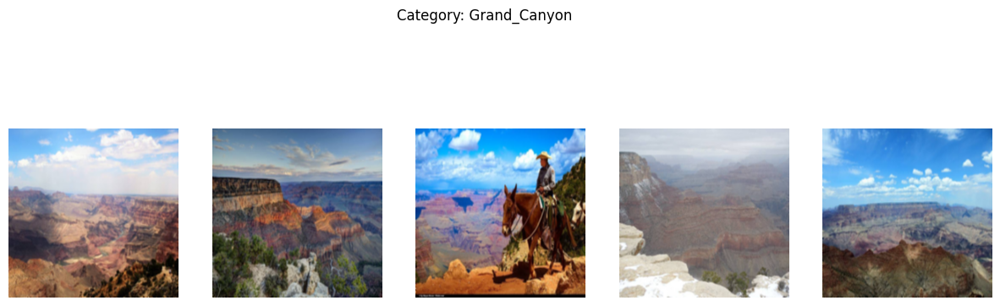

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

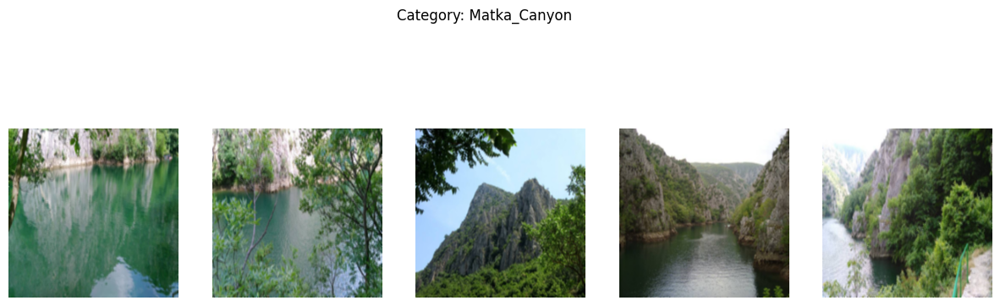

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

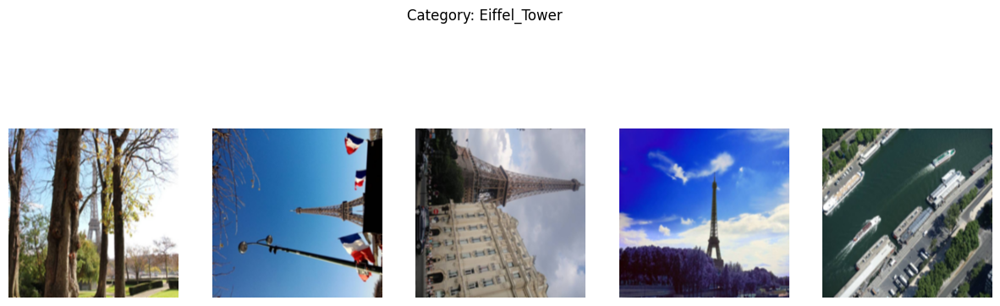

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

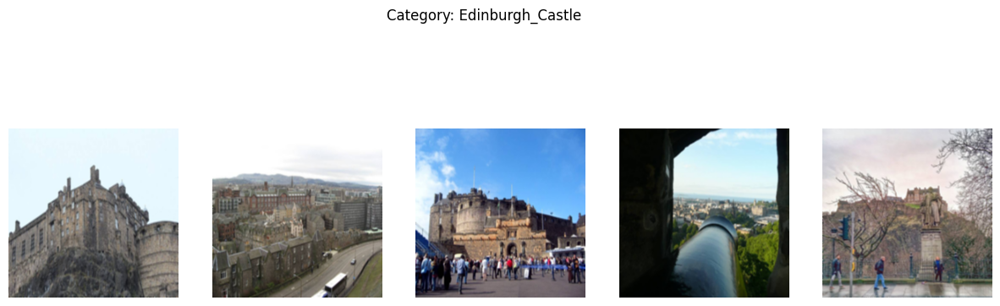

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

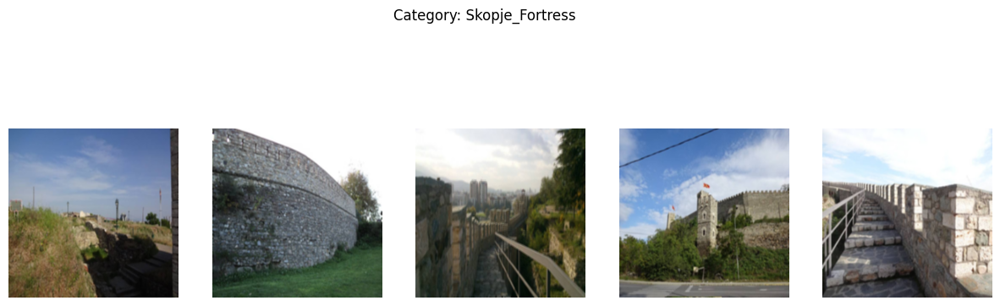

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

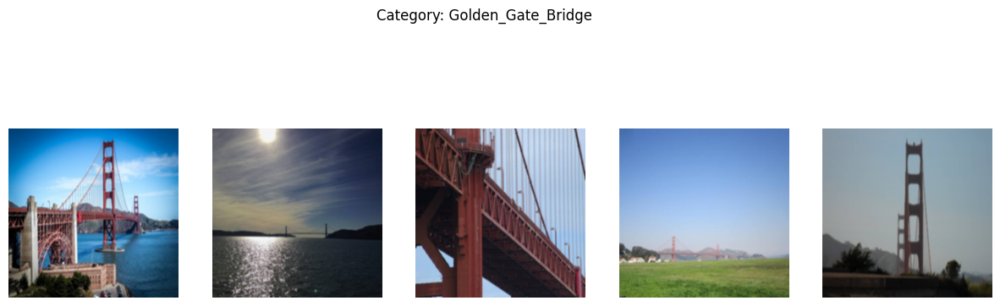

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

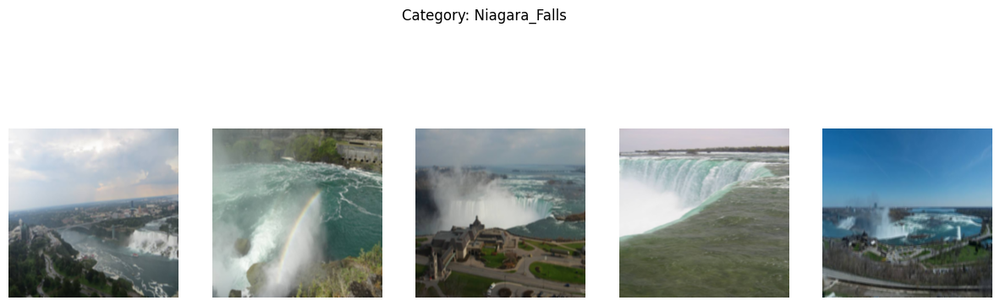

Filter:   0%|          | 0/1289 [00:00<?, ? examples/s]

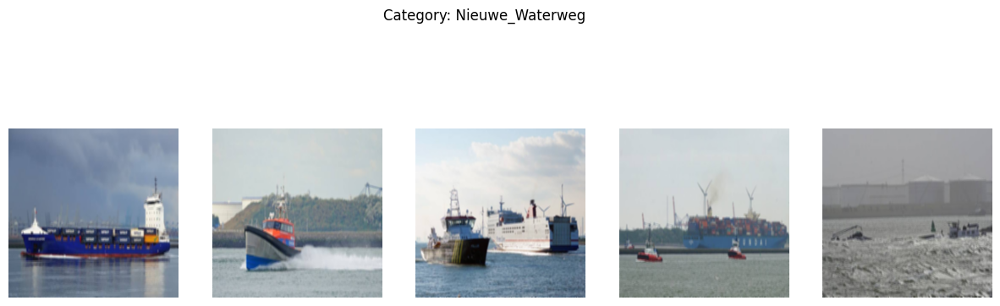

In [ ]:
# Display sample images for each category
for category in select_categories:
    # Filter the sample_dataset for the current label
    category_dataset = filtered_test_dataset.filter(lambda example: example['category'] == category)

    # Sample 5 to display
    category_dataset = category_dataset.shuffle(seed=0).select(range(5))

    # Create a figure and subplots for the images
    fig, axes = plt.subplots(1, len(category_dataset), figsize=(15, 5))

    # Display each image in a subplot
    for i in range(len(category_dataset)):
        axes[i].imshow(category_dataset[i]['image'])
        axes[i].axis('off') # Hide axes

    fig.suptitle(f"Category: {category}")

    plt.show()

In [ ]:
# from datasets import DatasetDict

# # Create a DatasetDict
# dataset_dict = DatasetDict({
#     'train': filtered_train_dataset,
#     'test': filtered_test_dataset
# })

# # Push to hub
# dataset_dict.push_to_hub('bosen-chia/GLDv2_Best_8_Categories')

In [ ]:
ds = load_dataset("bosen-chia/GLDv2_Best_8_Categories")

# Access the splits
train_ds = ds["train"]
test_ds = ds["test"]

#Inspect the dataset
print("#"*40)
print(f"Metadata:\n{ds}")

README.md:   0%|          | 0.00/545 [00:00<?, ?B/s]

data/train-00000-of-00001.parquet:   0%|          | 0.00/351M [00:00<?, ?B/s]

data/test-00000-of-00001.parquet:   0%|          | 0.00/84.8M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/5336 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/1289 [00:00<?, ? examples/s]

########################################
Metadata:
DatasetDict({
    train: Dataset({
        features: ['id', 'landmark_id', 'category', 'image', 'label'],
        num_rows: 5336
    })
    test: Dataset({
        features: ['id', 'landmark_id', 'category', 'image', 'label'],
        num_rows: 1289
    })
})


In [ ]:
def ds_to_df(split):
    rows = []
    for ex in tqdm(split, desc="building df"):
        rows.append({"image": ex['image'],
                     "label": ex['label'],
                     "category": ex['category']})

    return pd.DataFrame(rows)

train_df = pd.DataFrame(train_ds)
test_df  = pd.DataFrame(test_ds)


In [ ]:
categories = set(example["category"] for example in train_ds)
print(f"Total categories: {len(categories)}")
print(categories)


Total categories: 8
{'Grand_Canyon', 'Skopje_Fortress', 'Nieuwe_Waterweg', 'Eiffel_Tower', 'Niagara_Falls', 'Golden_Gate_Bridge', 'Matka_Canyon', 'Edinburgh_Castle'}


# Feature Extraction

## Histogram Of Gradients

In [ ]:
IMAGE_SIZE = (128, 128)
NUM_CLASSES = 8

In [ ]:
def extract_hog_features(examples):
    hog_features_list = []

    for image_pil in examples["image"]:
        img = np.array(image_pil.convert("RGB"))
        resized_img = resize(img, IMAGE_SIZE, anti_aliasing=True)

        fd = hog(
            resized_img,
            orientations=9,
            pixels_per_cell=(16, 16),
            cells_per_block=(3, 3),
            block_norm='L2-Hys',
            feature_vector=True,
            channel_axis=-1
        )
        hog_features_list.append(fd)

    return {"hog_features": hog_features_list}

In [ ]:
hog_ds = train_ds.map(
    extract_hog_features,
    batched=True,
    batch_size=32,
    remove_columns=['id', 'landmark_id', 'category']
)
hog_df = hog_ds.to_pandas()

Map:   0%|          | 0/5336 [00:00<?, ? examples/s]

In [ ]:
labels = hog_df['label'].values
hog_features = np.stack(hog_df['hog_features'].values)

print(f"Extracted HOG Features Shape: {hog_features.shape}")
print(f"Extracted Labels Shape: {labels.shape}")

Extracted HOG Features Shape: (5336, 2916)
Extracted Labels Shape: (5336,)


In [ ]:
def plot_single_hog_vector(hog_feature):
    """
    Plots a single HOG feature vector as a line graph.
    """
    plt.figure(figsize=(10, 5))

    # Plot the vector
    plt.plot(feature_vector, linewidth=0.8, color='teal')

    # Set titles and labels
    plt.title(f"HOG Feature Vector for Sample Index")
    plt.xlabel(f"Feature Index (Total features: {len(feature_vector)})")
    plt.ylabel("Normalized Gradient Magnitude")
    plt.grid(True, alpha=0.5)

    plt.tight_layout()
    plt.show()

In [ ]:
def hog_visual(image, pixels_per_cell=(16, 16), cells_per_block=(2, 2)):
    """
    Returns the HOG feature vector and HOG image (visualization).
    """
    img = np.array(image.convert("RGB"))
    resized_img = resize(img, IMAGE_SIZE, anti_aliasing=True)
    hog_vec, hog_image = hog(
        resized_img,
        orientations=9,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        visualize=True,
        block_norm='L2-Hys',
        feature_vector=True,
        channel_axis=-1
    )
    return hog_vec, hog_image

def plot_hog_visual(image, hog_image, hog_vec):
    plt.figure(figsize=(16, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(hog_image, cmap='gray')
    plt.title("HOG Edge Map")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.plot(hog_vec)
    plt.title("HOG Features")
    plt.xlabel("Feature Index")
    plt.ylabel("Value")

    plt.tight_layout()
    plt.show()

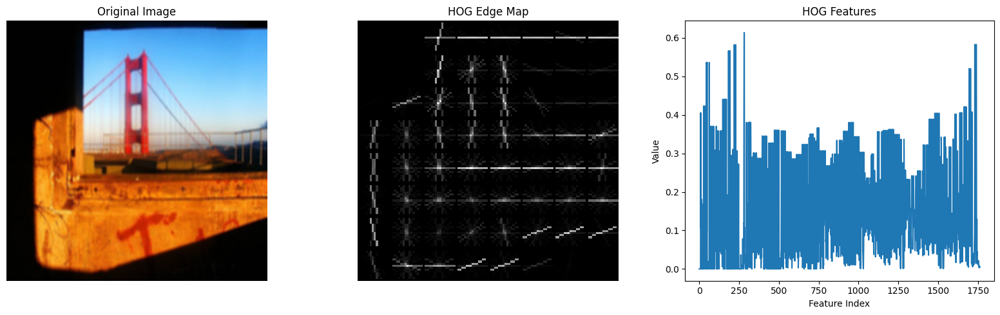

In [ ]:
hog_vec, hog_image = hog_visual(train_ds[0]["image"])
plot_hog_visual(train_ds[0]["image"], hog_image,hog_vec)

In [ ]:
pca_2d = PCA(n_components=2)
hog_2d = pca_2d.fit_transform(hog_features)

# Calculate explained variance to understand how much information is retained
explained_variance_ratio = pca_2d.explained_variance_ratio_
print("--- PCA Results ---")
print(f"Variance explained by PC1: {explained_variance_ratio[0]*100:.2f}%")
print(f"Variance explained by PC2: {explained_variance_ratio[1]*100:.2f}%")
print(f"Total variance explained by 2 components: {explained_variance_ratio.sum()*100:.2f}%")

--- PCA Results ---
Variance explained by PC1: 9.03%
Variance explained by PC2: 5.86%
Total variance explained by 2 components: 14.89%


/tmp/ipython-input-3731195296.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('Spectral', NUM_CLASSES)


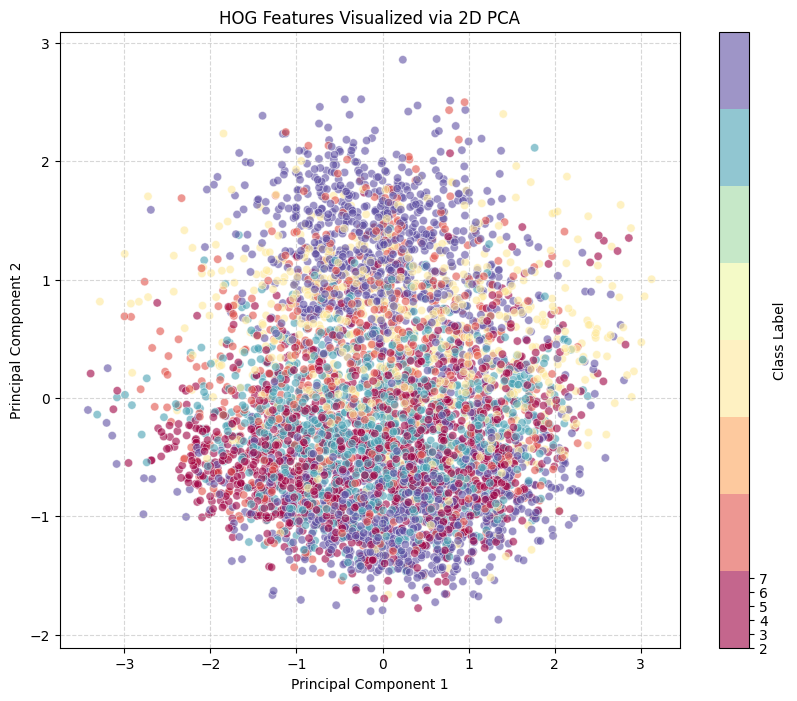

In [ ]:
plt.figure(figsize=(10, 8))
# Create a color map based on the number of classes
cmap = cm.get_cmap('Spectral', NUM_CLASSES)

# Scatter plot of the 2D reduced data, colored by the labels
scatter = plt.scatter(
    hog_2d[:, 0],
    hog_2d[:, 1],
    c=labels,
    cmap=cmap,
    alpha=0.6,
    edgecolors='w',
    linewidths=0.5
)

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('HOG Features Visualized via 2D PCA')
plt.colorbar(scatter, ticks=range(NUM_CLASSES), label='Class Label')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [ ]:
pca_tsne = PCA(n_components=50, random_state=42)
vit_pca_50d = pca_tsne.fit_transform(hog_features)

print("--- t-SNE Pre-PCA Results ---")
explained_variance_ratio_50d = pca_tsne.explained_variance_ratio_
print(f"Total variance explained by 50 components: {explained_variance_ratio_50d.sum()*100:.2f}%")
print(f"PCA-reduced Features Shape: {vit_pca_50d.shape}")

--- t-SNE Pre-PCA Results ---
Total variance explained by 50 components: 60.85%
PCA-reduced Features Shape: (5336, 50)


In [ ]:
tsne = TSNE(
    n_components=2,
    random_state=42,
    perplexity=30,
    max_iter=1000,
    learning_rate='auto',
    init='pca'
)
vit_tsne_2d = tsne.fit_transform(vit_pca_50d)
print(f"t-SNE Reduced Features Shape: {vit_tsne_2d.shape}")

t-SNE Reduced Features Shape: (5336, 2)


/tmp/ipython-input-2208232546.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('Spectral', NUM_CLASSES)


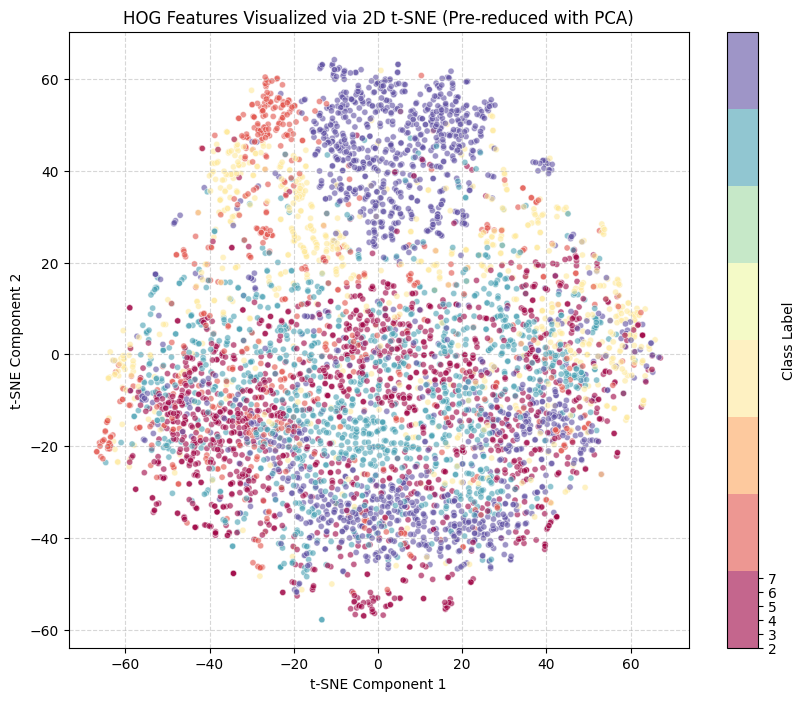

In [ ]:
plt.figure(figsize=(10, 8))
cmap = cm.get_cmap('Spectral', NUM_CLASSES)

scatter = plt.scatter(
    vit_tsne_2d[:, 0],
    vit_tsne_2d[:, 1],
    c=labels,
    cmap=cmap,
    alpha=0.6,
    edgecolors='w',
    linewidths=0.5,
    s=20
)

plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('HOG Features Visualized via 2D t-SNE (Pre-reduced with PCA)')
plt.colorbar(scatter, ticks=range(NUM_CLASSES), label='Class Label')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    hog_features, labels, test_size=0.2, random_state=42, stratify=labels
)

# Initialize and train a k-NN classifier (a simple, non-parametric model)
# We choose a small 'k' (number of neighbors)
knn = KNeighborsClassifier(n_neighbors=8)
knn.fit(X_train, y_train)

# Predict on the test set
y_pred = knn.predict(X_test)

# Evaluate the model performance
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy of k-NN (k=5) on test set: {accuracy * 100:.2f}%")
print("Classification Report:", classification_report(y_test, y_pred))

Accuracy of k-NN (k=5) on test set: 54.21%
Classification Report:               precision    recall  f1-score   support

           2       0.69      0.26      0.38       157
           3       0.36      0.83      0.50       106
          10       0.38      0.51      0.43       117
          19       0.92      0.52      0.67       145
          36       0.40      0.40      0.40       114
          39       0.45      0.27      0.34       114
          41       0.91      0.75      0.82       173
          46       0.55      0.75      0.64       142

    accuracy                           0.54      1068
   macro avg       0.58      0.54      0.52      1068
weighted avg       0.61      0.54      0.54      1068



## Colour Histograms

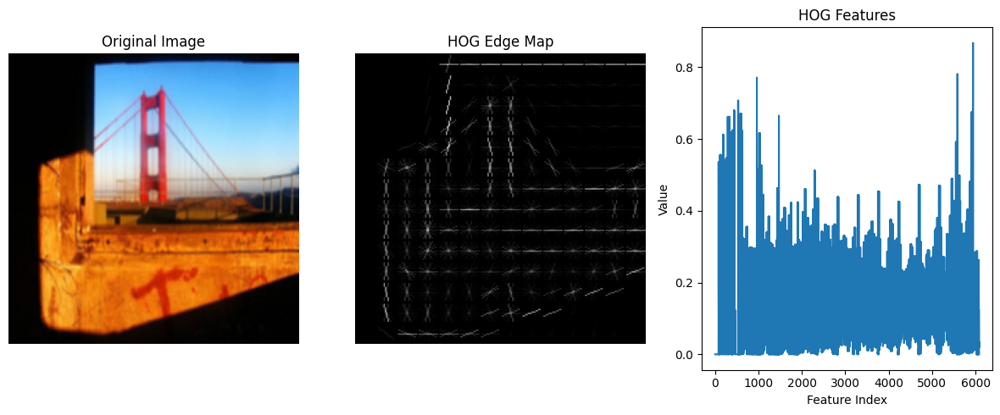

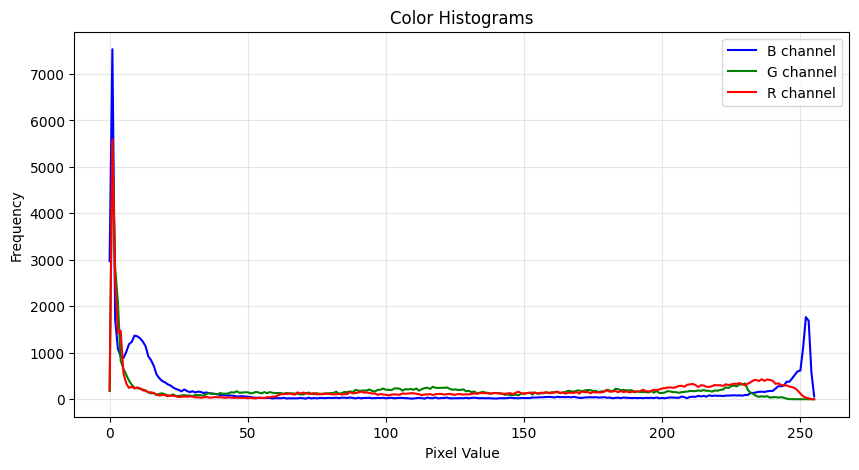

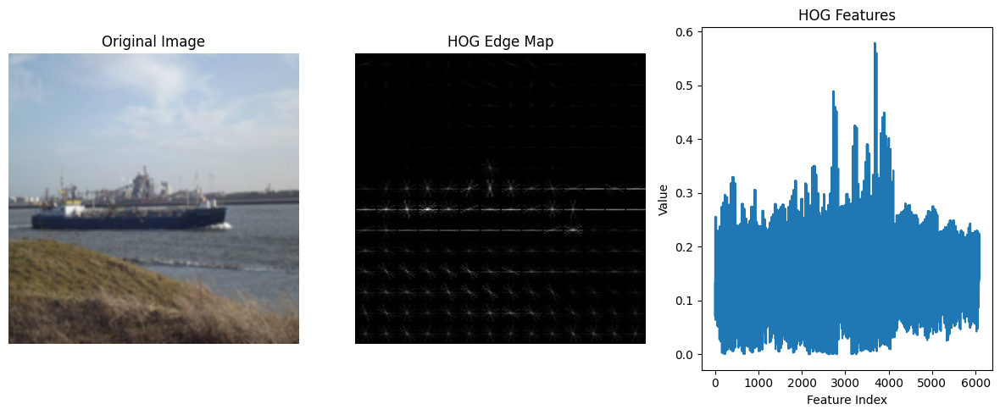

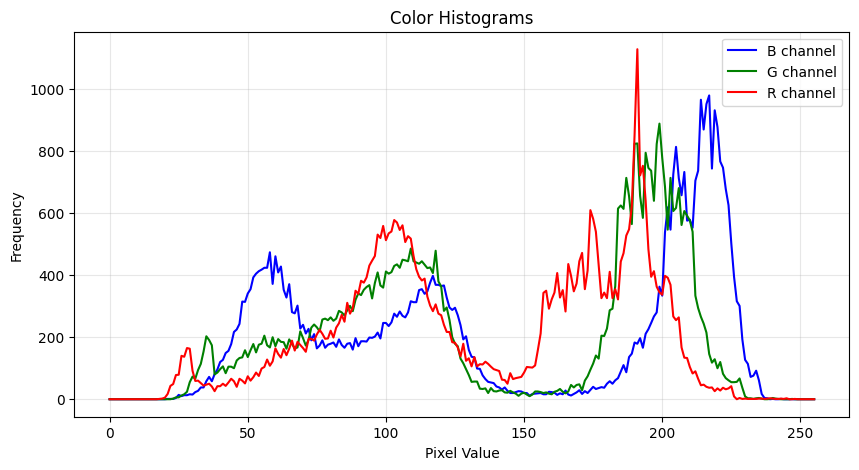

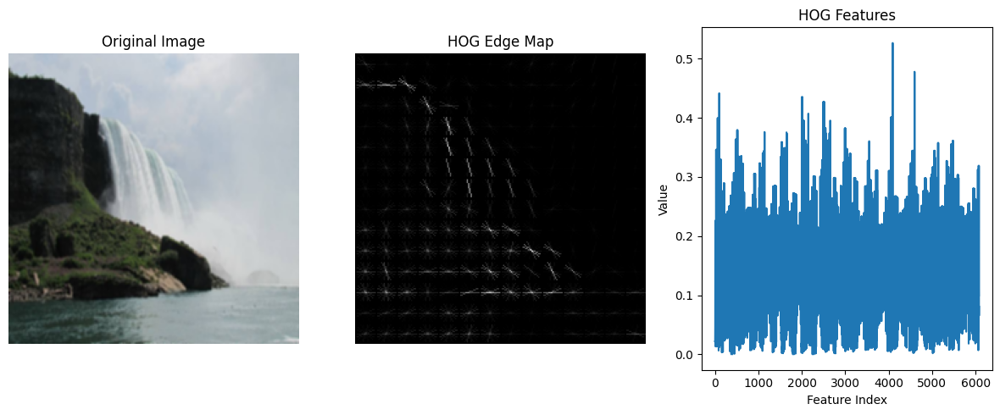

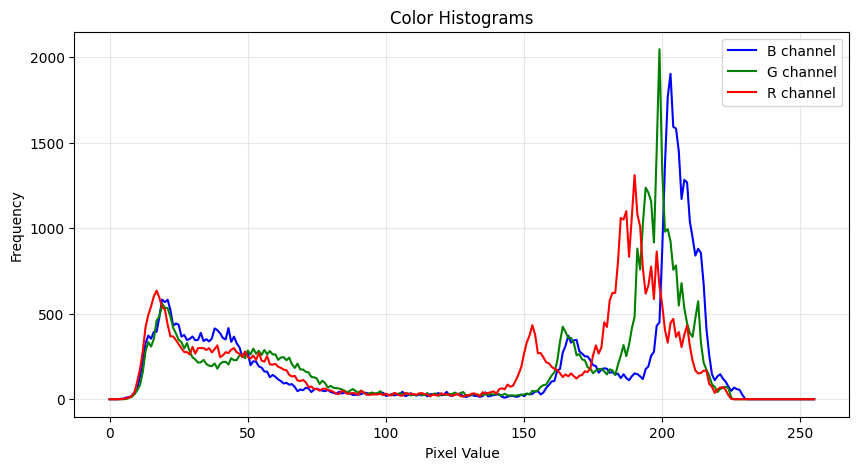

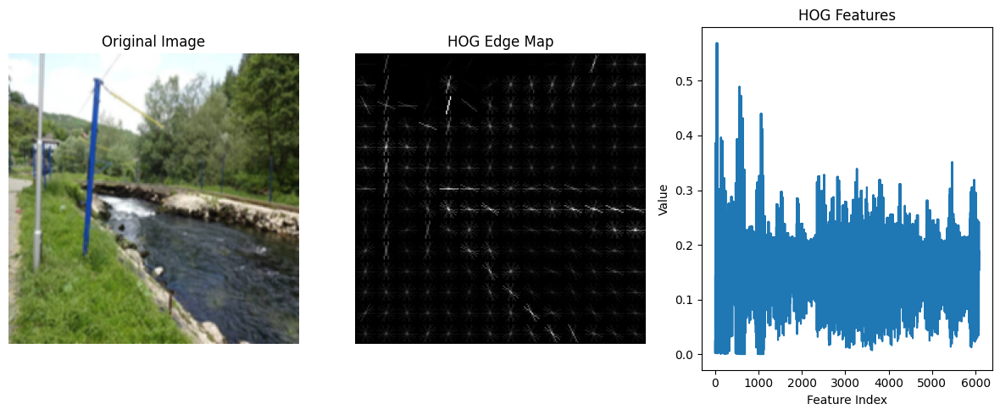

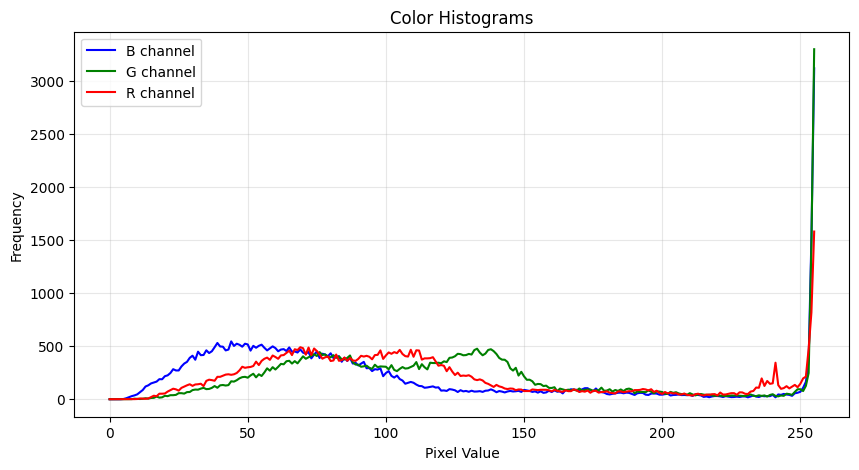

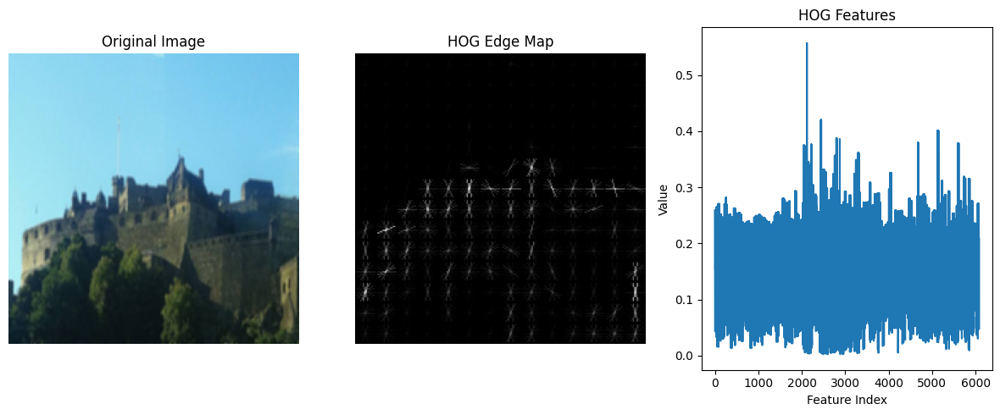

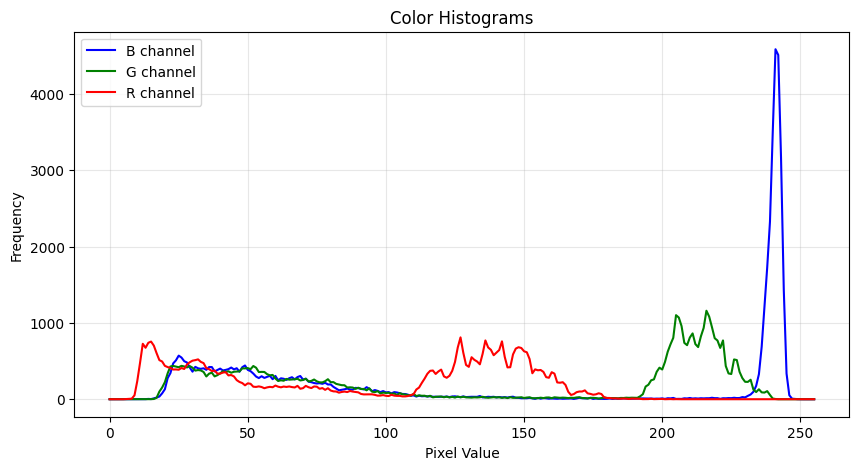

In [ ]:
from datasets import load_dataset
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage.color import rgb2gray
import numpy as np


# Load dataset (streaming for memory efficiency)
ds = load_dataset("bosen-chia/GLDv2_Best_8_Categories", split="train", streaming=True)

def extract_color_histogram(image):
    img = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    hist = cv2.calcHist([img], [0, 1, 2], None,
                        [8, 8, 8], [0, 256, 0, 256, 0, 256])
    hist = cv2.normalize(hist, hist).flatten()
    return hist

def hog_visual(image, pixels_per_cell=(16, 16), cells_per_block=(2, 2)):
    """
    Returns the HOG feature vector and HOG image (visualization).
    """
    gray = rgb2gray(image)
    hog_vec, hog_image = hog(
        gray,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        visualize=True,
        feature_vector=True
    )
    return hog_vec, hog_image

# ---------------------------------------------------
# Visualization helper: show original + HOG edge map
# ---------------------------------------------------
def plot_hog_visual(image, hog_image, hog_vec):
    plt.figure(figsize=(16, 5))

    plt.subplot(1, 4, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(hog_image, cmap='gray')
    plt.title("HOG Edge Map")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.plot(hog_vec)
    plt.title("HOG Features")
    plt.xlabel("Feature Index")
    plt.ylabel("Value")

    plt.tight_layout()
    plt.show()

    # plt.subplot(1, 4, 4)
    img = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    colors = ('b', 'g', 'r')
    plt.figure(figsize=(10, 5))

    for i, color in enumerate(colors):
        hist = cv2.calcHist([img], [i], None, [256], [0, 256])
        plt.plot(hist, color=color, label=f'{color.upper()} channel')

    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')
    plt.title('Color Histograms')
    plt.legend()
    plt.grid(alpha=0.3)
    plt.show()
# ---------------------------------------------------
# Process first N images
# ---------------------------------------------------
N = 5
for i, sample in enumerate(ds):
    if i >= N:
        break

    image = np.array(sample["image"])   # PIL -> NumPy

    # Compute HOG visualization
    hog_vec, hog_image = hog_visual(image)

    # Plot original + HOG edge map
    plot_hog_visual(image, hog_image,hog_vec)




## HSV Histogram

In [ ]:
HSV_BINS = [16, 8, 8]   # H, S, V bins
IMAGE_SIZE = train_ds['image'][0].size  #(224, 224)

def extract_hsv_hist(pil_img, resize=IMAGE_SIZE, bins=HSV_BINS):
    img = pil_img.resize(resize)
    arr = np.array(img)  # RGB

    hsv = cv2.cvtColor(arr, cv2.COLOR_RGB2HSV)
    h_bins, s_bins, v_bins = bins
    hist = cv2.calcHist([hsv], [0,1,2], mask=None, histSize=[h_bins, s_bins, v_bins], ranges=[0,180, 0,256, 0,256])
    hist = cv2.normalize(hist, hist).flatten()  # normalize and flatten inplace
    return hist



def visualize_hsv_hist(img, flat_hist, bins=HSV_BINS):
    h_bins, s_bins, v_bins = bins

    # reshape from flattened to 3D histogram
    hist_3d = flat_hist.reshape((h_bins, s_bins, v_bins))

    # collapse across axes to get 1D histograms
    h_hist = hist_3d.sum(axis=(1, 2))  # sum over S, V
    s_hist = hist_3d.sum(axis=(0, 2))  # sum over H, V
    v_hist = hist_3d.sum(axis=(0, 1))  # sum over H, S

    # Plot
    fig, axs = plt.subplots(1, 4, figsize=(20, 4))

    axs[0].imshow(img)

    axs[1].bar(range(h_bins), h_hist)
    axs[1].set_title("Hue Histogram")
    axs[1].set_xlabel("Hue bins")
    axs[1].set_ylabel("Normalized Count")

    axs[2].bar(range(s_bins), s_hist)
    axs[2].set_title("Saturation Histogram")
    axs[2].set_xlabel("Saturation bins")

    axs[3].bar(range(v_bins), v_hist)
    axs[3].set_title("Value Histogram")
    axs[3].set_xlabel("Value bins")

    plt.tight_layout()
    plt.show()

Filter:   0%|          | 0/5336 [00:00<?, ? examples/s]

Filter:   0%|          | 0/5336 [00:00<?, ? examples/s]

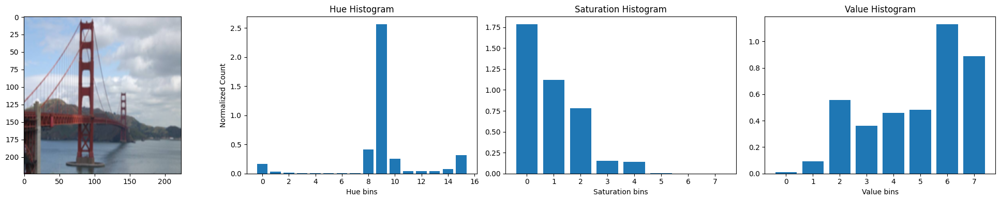

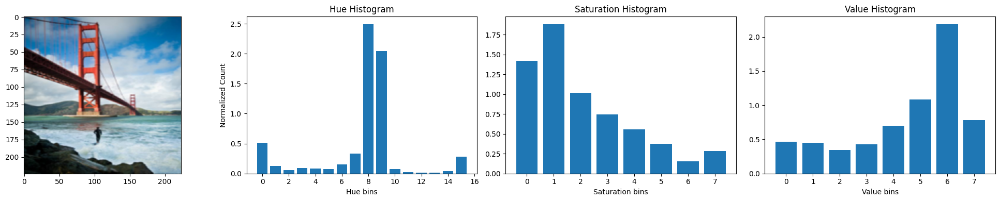

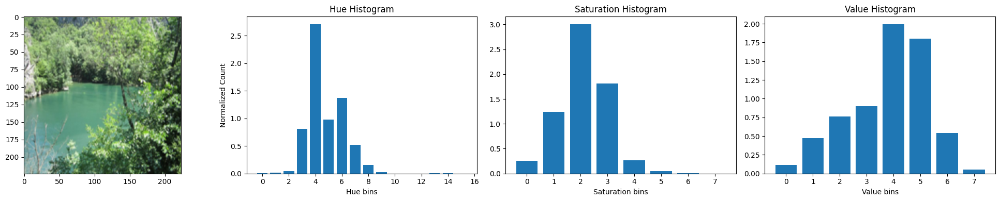

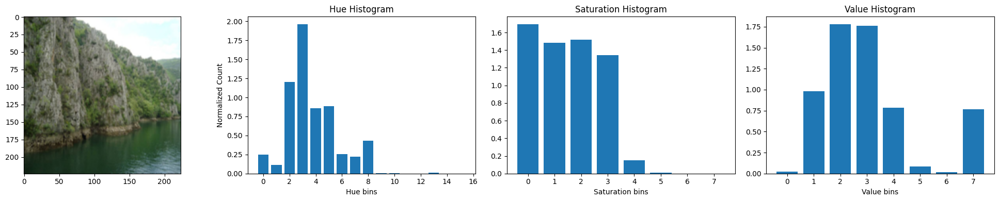

In [ ]:
GGB = train_ds.filter(lambda example: example['category'] == 'Golden_Gate_Bridge')

MC = train_ds.filter(lambda example: example['category'] == 'Matka_Canyon')


imgs = [GGB['image'][1], GGB['image'][2], MC['image'][2], MC['image'][6]]

for img in imgs:
    hist = extract_hsv_hist(img)
    visualize_hsv_hist(img, hist)

## ViT

In [ ]:
import torch
from transformers import AutoImageProcessor, AutoModel
from datasets import load_dataset, Features, Array3D, Value

In [ ]:
model_name = "google/vit-base-patch16-224-in21k"
processor = AutoImageProcessor.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

ViTModel(
  (embeddings): ViTEmbeddings(
    (patch_embeddings): ViTPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (dropout): Dropout(p=0.0, inplace=False)
  )
  (encoder): ViTEncoder(
    (layer): ModuleList(
      (0-11): 12 x ViTLayer(
        (attention): ViTAttention(
          (attention): ViTSelfAttention(
            (query): Linear(in_features=768, out_features=768, bias=True)
            (key): Linear(in_features=768, out_features=768, bias=True)
            (value): Linear(in_features=768, out_features=768, bias=True)
          )
          (output): ViTSelfOutput(
            (dense): Linear(in_features=768, out_features=768, bias=True)
            (dropout): Dropout(p=0.0, inplace=False)
          )
        )
        (intermediate): ViTIntermediate(
          (dense): Linear(in_features=768, out_features=3072, bias=True)
          (intermediate_act_fn): GELUActivation()
        )
        (output): ViTOutput(
          (d

In [ ]:
def extract_features(examples):
    images = [image.convert("RGB") for image in examples["image"]]
    inputs = processor(images, return_tensors="pt")

    inputs = {k: v.to(device) for k, v in inputs.items()}

    with torch.no_grad():
        outputs = model(**inputs)

    features = outputs.pooler_output.cpu().numpy()

    return {"features": features}


In [ ]:
features_ds = train_ds.map(
    extract_features,
    batched=True,
    batch_size=32,
    remove_columns=['id', 'landmark_id', 'category']
)

Map:   0%|          | 0/5336 [00:00<?, ? examples/s]

In [ ]:
features_df = features_ds.to_pandas()

In [ ]:
labels = features_df['label'].values
features = np.stack(features_df['features'].values)

print(f"Extracted ViT Features Shape: {features.shape}")
print(f"Extracted Labels Shape: {labels.shape}")

Extracted ViT Features Shape: (5336, 768)
Extracted Labels Shape: (5336,)


In [ ]:
pca_2d = PCA(n_components=2)
vit_2d = pca_2d.fit_transform(features)

# Calculate explained variance to understand how much information is retained
explained_variance_ratio = pca_2d.explained_variance_ratio_
print("--- PCA Results ---")
print(f"Variance explained by PC1: {explained_variance_ratio[0]*100:.2f}%")
print(f"Variance explained by PC2: {explained_variance_ratio[1]*100:.2f}%")
print(f"Total variance explained by 2 components: {explained_variance_ratio.sum()*100:.2f}%")

--- PCA Results ---
Variance explained by PC1: 10.12%
Variance explained by PC2: 8.35%
Total variance explained by 2 components: 18.47%


/tmp/ipython-input-1719836732.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('Spectral', NUM_CLASSES)


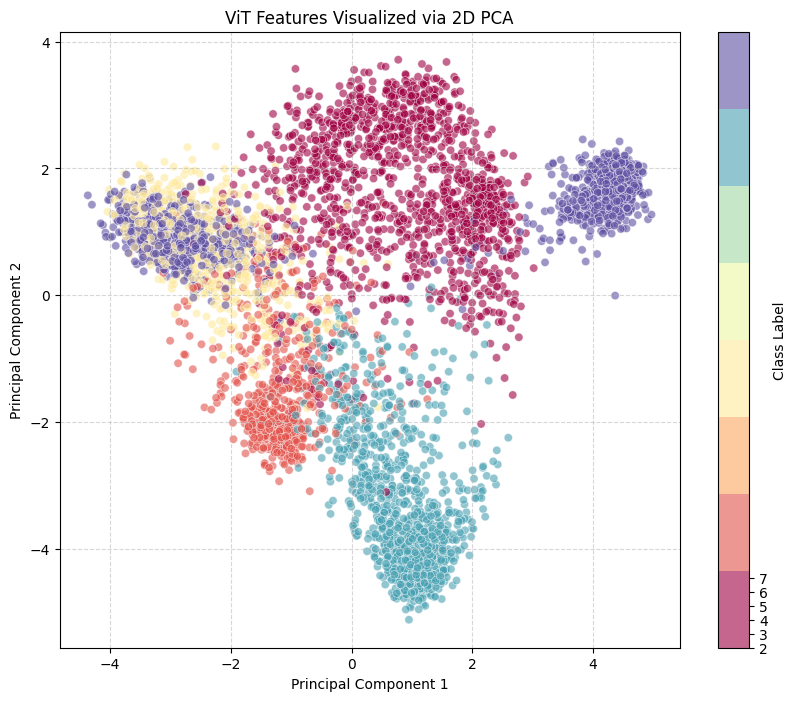

In [ ]:
plt.figure(figsize=(10, 8))
NUM_CLASSES = 8
# Create a color map based on the number of classes
cmap = cm.get_cmap('Spectral', NUM_CLASSES)

# Scatter plot of the 2D reduced data, colored by the labels
scatter = plt.scatter(
    vit_2d[:, 0],
    vit_2d[:, 1],
    c=labels,
    cmap=cmap,
    alpha=0.6,
    edgecolors='w',
    linewidths=0.5
)

plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('ViT Features Visualized via 2D PCA')
plt.colorbar(scatter, ticks=range(NUM_CLASSES), label='Class Label')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [ ]:
pca_tsne = PCA(n_components=50, random_state=42)
vit_pca_50d = pca_tsne.fit_transform(features)

print("--- t-SNE Pre-PCA Results ---")
explained_variance_ratio_50d = pca_tsne.explained_variance_ratio_
print(f"Total variance explained by 50 components: {explained_variance_ratio_50d.sum()*100:.2f}%")
print(f"PCA-reduced Features Shape: {vit_pca_50d.shape}")

--- t-SNE Pre-PCA Results ---
Total variance explained by 50 components: 67.40%
PCA-reduced Features Shape: (5336, 50)


In [ ]:
tsne = TSNE(
    n_components=2,
    random_state=42,
    perplexity=30,
    max_iter=1000,
    learning_rate='auto',
    init='pca'
)
vit_tsne_2d = tsne.fit_transform(vit_pca_50d)
print(f"t-SNE Reduced Features Shape: {vit_tsne_2d.shape}")

t-SNE Reduced Features Shape: (5336, 2)


/tmp/ipython-input-2291627872.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('Spectral', NUM_CLASSES)


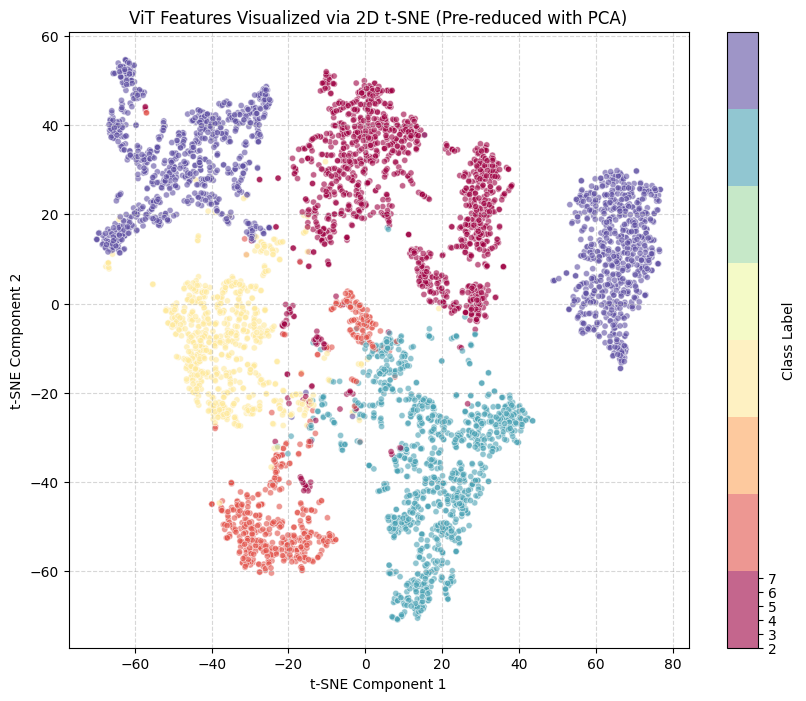

In [ ]:
plt.figure(figsize=(10, 8))
cmap = cm.get_cmap('Spectral', NUM_CLASSES)

scatter = plt.scatter(
    vit_tsne_2d[:, 0],
    vit_tsne_2d[:, 1],
    c=labels,
    cmap=cmap,
    alpha=0.6,
    edgecolors='w',
    linewidths=0.5,
    s=20
)

plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('ViT Features Visualized via 2D t-SNE (Pre-reduced with PCA)')
plt.colorbar(scatter, ticks=range(NUM_CLASSES), label='Class Label')
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

## ResNet-50 Model

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
import os
import urllib.request
from torchvision import transforms

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cpu


In [ ]:
# Download Places365 ResNet-50 weights
places_weights_url = "http://places2.csail.mit.edu/models_places365/resnet50_places365.pth.tar"
weights_path = "resnet50_places365.pth.tar"

if not os.path.exists(weights_path):
    print("Downloading Places365 weights...")
    urllib.request.urlretrieve(places_weights_url, weights_path)
    print("Download complete.")
else:
    print("Using cached Places365 weights.")

Download complete.


In [ ]:
# Load torchvision ResNet-50 and Places365 weights
resnet_model = models.resnet50(weights=None)   # Don't use ImageNet weights here
num_ftrs = resnet_model.fc.in_features
resnet_model.fc = nn.Linear(num_ftrs, 365)     # Places365 has 365 scene classes

checkpoint = torch.load(weights_path, map_location="cpu")
state_dict = {k.replace("module.", ""): v for k, v in checkpoint['state_dict'].items()}
resnet_model.load_state_dict(state_dict)

resnet_model.eval()
resnet_model.to(device)

# Replace final layer with Identity so forward() returns the 2048-D pooled feature
resnet_model.fc = nn.Identity()

In [ ]:
# Preprocessing for Places365 / ResNet
resnet_transform = transforms.Compose([
    transforms.Resize(256, interpolation=transforms.InterpolationMode.BILINEAR),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    ),
])

def extract_resnet_places_features(examples):
    """
    Complex feature extractor:
    - converts each image to RGB
    - applies the ResNet / Places365 preprocessing
    - runs a forward pass through ResNet-50 (with fc = Identity)
    - returns 2048-D embeddings as 'resnet_features'
    """
    imgs = [resnet_transform(img.convert("RGB")) for img in examples["image"]]
    inputs = torch.stack(imgs).to(device)

    with torch.no_grad():
        outputs = resnet_model(inputs)  # shape: [B, 2048]

    features = outputs.cpu().numpy()
    return {"resnet_features": features}

In [ ]:
# Apply to training split
resnet_ds = train_ds.map(
    extract_resnet_places_features,
    batched=True,
    batch_size=32,
    remove_columns=['id', 'landmark_id', 'category']
)

resnet_df = resnet_ds.to_pandas()
labels_resnet = resnet_df['label'].values
resnet_features = np.stack(resnet_df['resnet_features'].values)

print(f"Extracted ResNet-Places365 Shape: {resnet_features.shape}")

Map:   0%|          | 0/5336 [00:00<?, ? examples/s]

Extracted ResNet-Places365 Shape: (5336, 2048)


In [ ]:
# Define number of classes based on encoded labels
NUM_CLASSES = len(np.unique(labels_resnet))
print("NUM_CLASSES:", NUM_CLASSES)

NUM_CLASSES: 8


In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc
from sklearn.manifold import TSNE
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt

class_names = [
    "Grand_Canyon",
    "Matka_Canyon",
    "Eiffel_Tower",
    "Edinburgh_Castle",
    "Skopje_Fortress",
    "Golden_Gate_Bridge",
    "Niagara_Falls",
    "Nieuwe_Waterweg",
]

NUM_CLASSES = len(np.unique(labels_resnet))
print("ResNet feature matrix:", resnet_features.shape)
print("Labels shape:", labels_resnet.shape)
print("NUM_CLASSES:", NUM_CLASSES)

ResNet feature matrix: (5336, 2048)
Labels shape: (5336,)
NUM_CLASSES: 8


--- ResNet-Places365 PCA Results ---
Variance explained by PC1: 16.05%
Variance explained by PC2: 10.78%
Total variance explained by 2 components: 26.83%


/tmp/ipython-input-582929982.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab10", NUM_CLASSES)


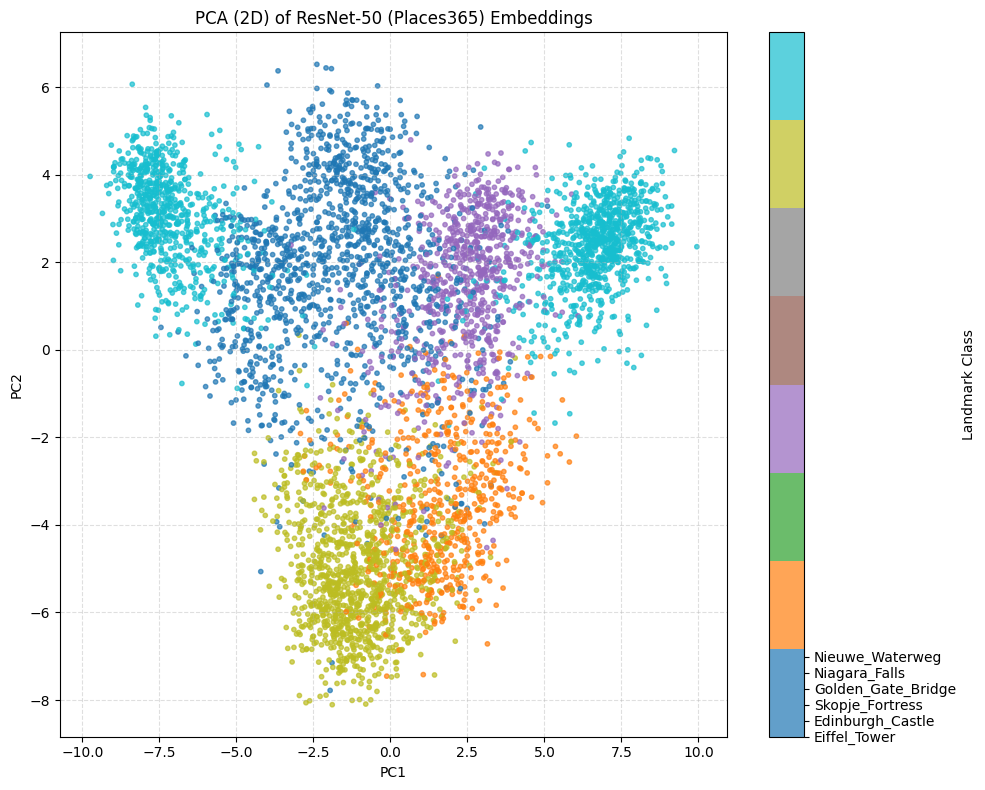

In [ ]:
# PCA transform (2D)
pca_2d_resnet = PCA(n_components=2, random_state=42)
resnet_2d = pca_2d_resnet.fit_transform(resnet_features)

explained_variance_ratio_resnet = pca_2d_resnet.explained_variance_ratio_
print("--- ResNet-Places365 PCA Results ---")
print(f"Variance explained by PC1: {explained_variance_ratio_resnet[0] * 100:.2f}%")
print(f"Variance explained by PC2: {explained_variance_ratio_resnet[1] * 100:.2f}%")
print(f"Total variance explained by 2 components: {explained_variance_ratio_resnet[:2].sum() * 100:.2f}%")

plt.figure(figsize=(10, 8))
cmap = cm.get_cmap("tab10", NUM_CLASSES)

scatter = plt.scatter(
    resnet_2d[:, 0],
    resnet_2d[:, 1],
    c=labels_resnet,
    cmap=cmap,
    s=10,
    alpha=0.7
)

plt.xlabel("PC1")
plt.ylabel("PC2")
plt.title("PCA (2D) of ResNet-50 (Places365) Embeddings")

cbar = plt.colorbar(scatter, ticks=range(NUM_CLASSES))
cbar.ax.set_yticklabels(class_names)  # show label names instead of numbers
cbar.set_label("Landmark Class")

plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()

Shape after PCA to 50D for t-SNE: (5336, 50)


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE 2D shape: (5336, 2)


/tmp/ipython-input-3209614422.py:22: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab10", NUM_CLASSES)


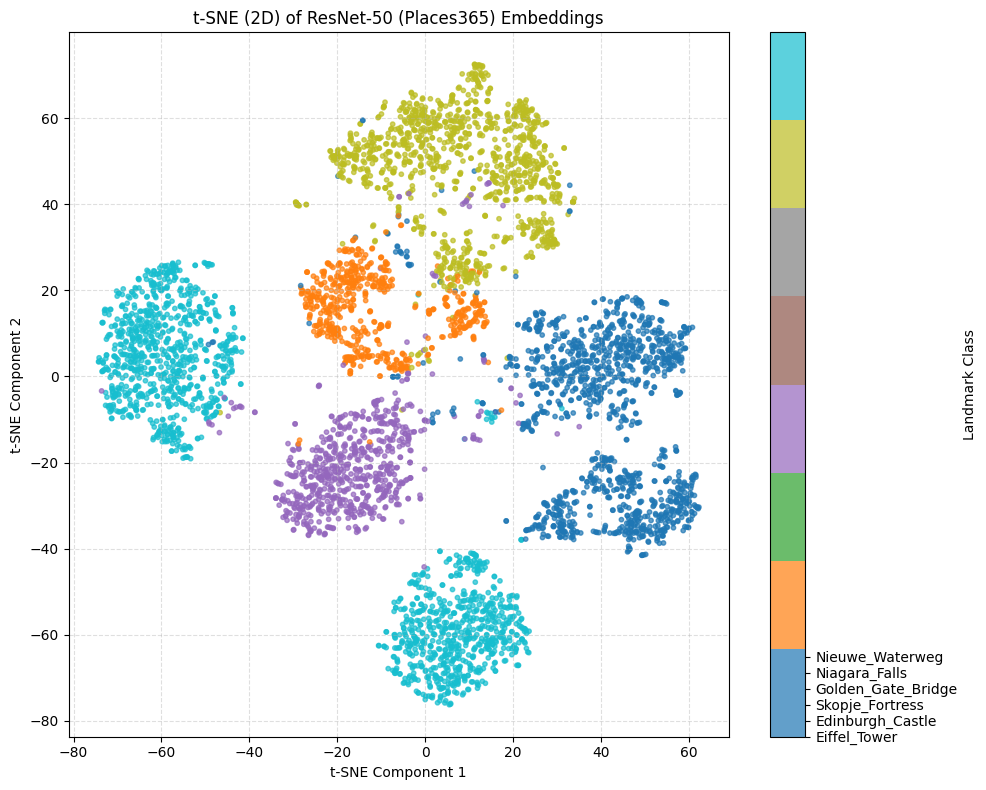

In [ ]:
# t-SNE visualization (2D) of ResNet-50 embeddings

# educe to 50D via PCA for faster, stabler t-SNE
pca_50 = PCA(n_components=50, random_state=42)
resnet_50d = pca_50.fit_transform(resnet_features)

print("Shape after PCA to 50D for t-SNE:", resnet_50d.shape)

tsne = TSNE(
    n_components=2,
    random_state=42,
    perplexity=30,
    n_iter=1000,
    learning_rate="auto",
    init="random"
)

resnet_tsne_2d = tsne.fit_transform(resnet_50d)
print("t-SNE 2D shape:", resnet_tsne_2d.shape)

plt.figure(figsize=(10, 8))
cmap = cm.get_cmap("tab10", NUM_CLASSES)

scatter = plt.scatter(
    resnet_tsne_2d[:, 0],
    resnet_tsne_2d[:, 1],
    c=labels_resnet,
    cmap=cmap,
    s=10,
    alpha=0.7
)

plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.title("t-SNE (2D) of ResNet-50 (Places365) Embeddings")

cbar = plt.colorbar(scatter, ticks=range(NUM_CLASSES))
cbar.ax.set_yticklabels(class_names)
cbar.set_label("Landmark Class")

plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()


In [ ]:
# Rebuild class names to match real encoded label values
unique_labels = np.unique(labels_resnet)
print("Unique labels in dataset:", unique_labels)

# Map class index positions to your real label values
class_names = [
    "Grand_Canyon",
    "Matka_Canyon",
    "Eiffel_Tower",
    "Edinburgh_Castle",
    "Skopje_Fortress",
    "Golden_Gate_Bridge",
    "Niagara_Falls",
    "Nieuwe_Waterweg",
]

# Ensure we only keep 8 classes and realign ordering if needed
if len(unique_labels) != len(class_names):
    print("⚠️ Label count and class_names length mismatch. Fixing order to first 8 detected labels.")
    class_names = [class_names[i] for i in range(len(unique_labels))]

print("Class names aligned:", class_names)

Unique labels in dataset: [ 2  3 10 19 36 39 41 46]
Class names aligned: ['Grand_Canyon', 'Matka_Canyon', 'Eiffel_Tower', 'Edinburgh_Castle', 'Skopje_Fortress', 'Golden_Gate_Bridge', 'Niagara_Falls', 'Nieuwe_Waterweg']


Unique labels: [ 2  3 10 19 36 39 41 46]
Label map: {np.int64(2): 'Grand_Canyon', np.int64(3): 'Matka_Canyon', np.int64(10): 'Eiffel_Tower', np.int64(19): 'Edinburgh_Castle', np.int64(36): 'Skopje_Fortress', np.int64(39): 'Golden_Gate_Bridge', np.int64(41): 'Niagara_Falls', np.int64(46): 'Nieuwe_Waterweg'}
Sampled indices: [4784 1067 2663 1150 3639 4281]
Example 4784 → Nieuwe_Waterweg
Example 1067 → Golden_Gate_Bridge
Example 2663 → Niagara_Falls
Example 1150 → Niagara_Falls
Example 3639 → Golden_Gate_Bridge
Example 4281 → Niagara_Falls


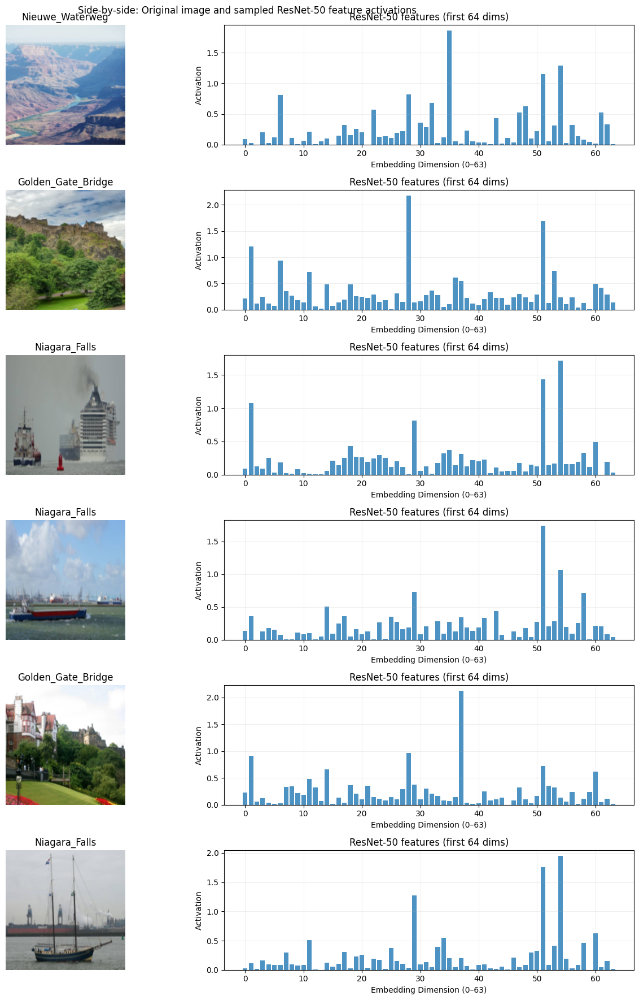

In [ ]:
# Original image + ResNet embedding visualization

unique_labels = np.unique(labels_resnet)
label_map = {lab: class_names[i] for i, lab in enumerate(unique_labels)}
print("Unique labels:", unique_labels)
print("Label map:", label_map)

num_examples = 6
valid_idxs = np.arange(len(resnet_ds))
sample_idxs = np.random.choice(valid_idxs, num_examples, replace=False)

print("Sampled indices:", sample_idxs)

plt.figure(figsize=(14, 3 * num_examples))

for i, idx in enumerate(sample_idxs):
    idx = int(idx)
    example = resnet_ds[idx]
    img = example["image"]
    label_idx = example["label"]
    label_name = label_map[label_idx]

    embedding = resnet_features[idx]  # 2048-D vector

    print(f"Example {idx} → {label_name}")

    # Row i, Col 1: Original image
    plt.subplot(num_examples, 2, 2 * i + 1)
    plt.imshow(img)
    plt.axis("off")
    plt.title(label_name)

    # Row i, Col 2: First 64 dims of embedding
    dims_to_show = 64
    x = np.arange(dims_to_show)
    plt.subplot(num_examples, 2, 2 * i + 2)
    plt.bar(x, embedding[:dims_to_show], alpha=0.8)
    plt.xlabel("Embedding Dimension (0–63)")
    plt.ylabel("Activation")
    plt.title("ResNet-50 features (first 64 dims)")
    plt.grid(alpha=0.2)

plt.suptitle("Side-by-side: Original image and sampled ResNet-50 feature activations")
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
np.save("/content/drive/MyDrive/resnet_features.npy", resnet_features)
np.save("/content/drive/MyDrive/resnet_labels.npy", labels_resnet)
print("Saved features")

Saved features


# Combined features

Get all extracted features, combine them in different formats as follows:

*   hog_features: A representation of the HOG features.
*   color_features: A representation of the color HOG features.
*   hsv_features: A representation of HSV features.
*   hog_color_hsv_features: A combination of HOG, colors and HSV features to represent the traditional set of features.
*   hog_hsv_features: A combination of HOG and HSV features without the color features to provide a comparison for the contribution of color vs HSV to the accuracy of models.
*   vit_features: A representation of vit feature embeddings.
*   resnet_features: A representation of resnet feature embeddings.
*   vit_resnet_combined_features:A combination of  vit and resnet features to represent the complex set of features.
*   combined_features: A combination of all features (HOG, colors, HSV, vit and resnet ).

In [ ]:
def combine_features(df,file_name='train'):
  features_list = []

  for example in tqdm(df, desc="Extracting all features"):
      img = example["image"]
      img_id = example["id"]
      landmark_id = example["landmark_id"]
      category = example["category"]
      label = example["label"]

      # Compute all features
      result_hog = extract_hog_features({"image": [img]})
      hog_feat = result_hog["hog_features"][0]

      color_feat = extract_color_histogram(img)

      hsv_feat = extract_hsv_hist(img)

      result_vit = extract_features({"image": [img]})
      vit_feat = result_vit["features"][0]

      result_resnet = extract_resnet_places_features({"image": [img]})
      resnet_feat = result_resnet["resnet_features"][0]

      # Concatenate all features
      combined_feat = np.concatenate([hog_feat,
                                      color_feat,
                                      hsv_feat,
                                      resnet_feat,
                                      vit_feat
                                      ])
      combined_feat_no_color = np.concatenate([hog_feat,
                                      hsv_feat,
                                      resnet_feat,
                                      vit_feat
                                      ])

      # Concatenate deep learning features
      dl_feat = np.concatenate([resnet_feat,
                                      vit_feat
                                      ])

      # Concatenate traditional features
      hog_color_hsv_feat = np.concatenate([hog_feat,
                                      color_feat,
                                      hsv_feat])

      hog_hsv_feat = np.concatenate([hog_feat,
                                      hsv_feat])

      # Store as one record
      features_list.append({
          "id": img_id,
          "landmark_id": landmark_id,
          "category": category,
          "label": label,
          "hog_features": hog_feat,
          "color_features": color_feat,
          "hsv_features": hsv_feat,
          "vit_features": vit_feat,
          "resnet_features": resnet_feat,
          "vit_resnet_combined_features": dl_feat,
          "combined_features": combined_feat,
          "combined_feat_no_color": combined_feat_no_color,
          "hog_color_hsv_features": hog_color_hsv_feat,
          "hog_hsv_features": hog_hsv_feat
      })

  # Convert lists of features to arrays after the loop
  ids = np.array([f["id"] for f in features_list])
  landmarks = np.array([f["landmark_id"] for f in features_list])
  categories = np.array([f["category"] for f in features_list])
  labels = np.array([f["label"] for f in features_list])
  hog_features_all = np.stack([f["hog_features"] for f in features_list])
  color_features_all = np.stack([f["color_features"] for f in features_list])
  hsv_features_all = np.stack([f["hsv_features"] for f in features_list])
  vit_features_all = np.stack([f["vit_features"] for f in features_list])
  resnet_features_all = np.stack([f["resnet_features"] for f in features_list])
  vit_resnet_combined_features_all = np.stack([f["vit_resnet_combined_features"] for f in features_list])
  combined_features_all = np.stack([f["combined_features"] for f in features_list])
  combined_feat_no_color_all = np.stack([f["combined_feat_no_color"] for f in features_list])
  hog_color_hsv_feat_all = np.stack([f["hog_color_hsv_features"] for f in features_list])
  hog_hsv_feat_all = np.stack([f["hog_hsv_features"] for f in features_list])

  save_path = f'/content/drive/MyDrive/W281/{file_name}_features_combined.npz'

  np.savez_compressed(
      save_path,
      id=ids,
      landmark_id=landmarks,
      category=categories,
      label=labels,
      hog_features = hog_features_all,
      color_features = color_features_all,
      hsv_features = hsv_features_all,
      vit_features = vit_features_all,
      resnet_features = resnet_features_all,
      vit_resnet_combined_features = vit_resnet_combined_features_all,
      combined_features = combined_features_all,
      combined_feat_no_color = combined_feat_no_color_all,
      hog_color_hsv_features = hog_color_hsv_feat_all,
      hog_hsv_features = hog_hsv_feat_all
  )


In [ ]:
 # Training features
# train_ds_sample = train_ds.shuffle(seed=42).select(range(1000))
combine_features(train_ds,file_name='train')

  # Test features
# test_ds_sample = test_ds.shuffle(seed=42).select(range(1000))
combine_features(test_ds,file_name='test')


Extracting all features: 100%|██████████| 1289/1289 [18:58<00:00,  1.13it/s]


# CHECKPOINT 1 - Load Combined Features

This is the dataset that has all the individual and combined features.




In [ ]:
save_path_train = '/content/drive/MyDrive/W281/train_features_combined.npz'
train_data = np.load(save_path_train, allow_pickle=True)

save_path_test = '/content/drive/MyDrive/W281/test_features_combined.npz'
test_data = np.load(save_path_test, allow_pickle=True)

print(f"Train Keys in loaded data: {train_data.files}")
print(f"Test Keys in loaded data: {test_data.files}")

Train Keys in loaded data: ['id', 'landmark_id', 'category', 'label', 'hog_features', 'color_features', 'hsv_features', 'vit_features', 'resnet_features', 'vit_resnet_combined_features', 'combined_features', 'combined_feat_no_color']
Test Keys in loaded data: ['id', 'landmark_id', 'category', 'label', 'hog_features', 'color_features', 'hsv_features', 'vit_features', 'resnet_features', 'vit_resnet_combined_features', 'combined_features', 'combined_feat_no_color']


In [ ]:
# Get all features into variables
X_train_combined = train_data["combined_features"] # Corrected to access the actual array
X_train_hog = train_data["hog_features"]
X_train_color = train_data["color_features"]
X_train_hsv = train_data["hsv_features"]
X_train_vit = train_data["vit_features"]
X_train_resnet = train_data["resnet_features"]
X_train_vit_resnet = train_data["vit_resnet_combined_features"]
X_train_combined_no_color = train_data["combined_feat_no_color"]
X_train_hog_color_hsv_features = train_data["hog_color_hsv_features"]
X_train_hog_hsv_features = train_data["hog_hsv_features"]
y_train_combined = train_data["label"]
category_train_combined = train_data["category"]

# Check the shapes
print(f"Loaded training data from: {save_path_train}")
print(f"X_train_combined shape: {X_train_combined.shape}")
print(f"X_train_hog shape: {X_train_hog.shape}")
print(f"X_train_color shape: {X_train_color.shape}")
print(f"X_train_hsv shape: {X_train_hsv.shape}")
print(f"X_train_vit shape: {X_train_vit.shape}")
print(f"X_train_resnet shape: {X_train_resnet.shape}")
print(f"X_train_vit_resnet shape: {X_train_vit_resnet.shape}")
print(f"X_train_combined_no_color shape: {X_train_combined_no_color.shape}")
print(f"X_train_hog_color_hsv_features: {X_train_hog_color_hsv_features.shape}")
print(f"X_train_hog_hsv_features: {X_train_hog_hsv_features.shape}")
print(f"y_train_combined shape: {y_train_combined.shape}")
print(f"category_train_combined shape: {category_train_combined.shape}")

KeyError: 'hog_color_hsv_features is not a file in the archive'

In [ ]:
# Get all features into variables
X_test_combined = test_data["combined_features"] # Corrected to access the actual array
X_test_hog = test_data["hog_features"]
X_test_color = test_data["color_features"]
X_test_hsv = test_data["hsv_features"]
X_test_vit = test_data["vit_features"]
X_test_resnet = test_data["resnet_features"]
X_test_vit_resnet = test_data["vit_resnet_combined_features"]
X_test_combined_no_color = test_data["combined_feat_no_color"]
X_test_hog_color_hsv_features = test_data["hog_color_hsv_features"]
X_test_hog_hsv_features = test_data["hog_hsv_features"]
y_test_combined = test_data["label"]
category_test_combined = test_data["category"]

# Check the shapes

print(f"Loaded testing data from: {save_path_test}")
print(f"X_test_combined shape: {X_test_combined.shape}")
print(f"X_test_hog shape: {X_test_hog.shape}")
print(f"X_test_color shape: {X_test_color.shape}")
print(f"X_test_hsv shape: {X_test_hsv.shape}")
print(f"X_test_vit shape: {X_test_vit.shape}")
print(f"X_test_resnet shape: {X_test_resnet.shape}")
print(f"X_test_vit_resnet shape: {X_test_vit_resnet.shape}")
print(f"X_test_combined_no_color shape: {X_test_combined_no_color.shape}")
print(f"X_test_hog_color_hsv_features: {X_test_hog_color_hsv_features.shape}")
print(f"X_test_hog_hsv_features: {X_test_hog_hsv_features.shape}")
print(f"y_test_combined shape: {y_test_combined.shape}")
print(f"category_test_combined shape: {category_test_combined.shape}")

# PCA
Using PCA to reduce dimensionality of features.

## Helper Functions

In [ ]:
def pca_calculations(X_feature, test_feature):

  # Initialize PCA without specifying n_components to retain all components initially
  pca = PCA()

  # Fit PCA to the X_combined data
  pca_model=pca.fit(X_feature)

  print("PCA fitted successfully")

  # Calculate cumulative explained variance
  cum_var_exp = np.cumsum(pca.explained_variance_ratio_)

  # Plot the cumulative explained variance
  plt.figure(figsize=(10, 6))
  plt.plot(range(1, len(cum_var_exp) + 1), cum_var_exp, marker='o', linestyle='--')
  plt.title('Cumulative Explained Variance by Principal Components')
  plt.xlabel('Number of Components')
  plt.ylabel('Cumulative Explained Variance')
  plt.grid(True)
  plt.show()

  num_components_90 = np.argmax(cum_var_exp >= 0.90) + 1
  print(f"Number of components to explain 90% variance: {num_components_90}")

  pca_model = PCA(n_components=num_components_90)
  X_feature_pca = pca_model.fit_transform(X_feature)
  X_test_pca = pca_model.transform(test_feature)


  print(f"Original shape of X_combined: {X_feature.shape} and for test: {test_feature.shape}")
  print(f"Reduced shape of X_combined after PCA: {X_feature_pca.shape} and for test: {X_test_pca.shape}")
  return X_feature_pca,X_test_pca

## PCA feature mapping

In [ ]:
feature_arrays = {
    'combined_features': X_train_combined,
    'hog_features': X_train_hog,
    'color_features': X_train_color,
    'hsv_features': X_train_hsv,
    'vit_features': X_train_vit,
    'resnet_features': X_train_resnet,
    'vit_resnet_combined_features': X_train_vit_resnet,
    'combined_feat_no_color': X_train_combined_no_color,
    'hog_color_hsv_features' : X_train_hog_color_hsv_features,
    'hog_hsv_features' : X_train_hog_hsv_features
}

print("Feature arrays dictionary created successfully.")
print(f"Keys in feature_arrays: {list(feature_arrays.keys())}")

feature_test_arrays = {
    'combined_features': X_test_combined,
    'hog_features': X_test_hog,
    'color_features': X_test_color,
    'hsv_features': X_test_hsv,
    'vit_features': X_test_vit,
    'resnet_features': X_test_resnet,
    'vit_resnet_combined_features': X_test_vit_resnet,
    'combined_feat_no_color': X_test_combined_no_color,
    'hog_color_hsv_features' : X_test_hog_color_hsv_features,
    'hog_hsv_features' : X_test_hog_hsv_features
}

print("Feature arrays dictionary created successfully.")
print(f"Keys in feature_arrays: {list(feature_test_arrays.keys())}")

Feature arrays dictionary created successfully.
Keys in feature_arrays: ['combined_features', 'hog_features', 'color_features', 'hsv_features', 'vit_features', 'resnet_features', 'vit_resnet_combined_features', 'combined_feat_no_color', 'hog_color_hsv_features', 'hog_hsv_features']
Feature arrays dictionary created successfully.
Keys in feature_arrays: ['combined_features', 'hog_features', 'color_features', 'hsv_features', 'vit_features', 'resnet_features', 'vit_resnet_combined_features', 'combined_feat_no_color', 'hog_color_hsv_features', 'hog_hsv_features']


## Apply PCA for both Train and Test features


Applying PCA to combined_features...
PCA fitted successfully


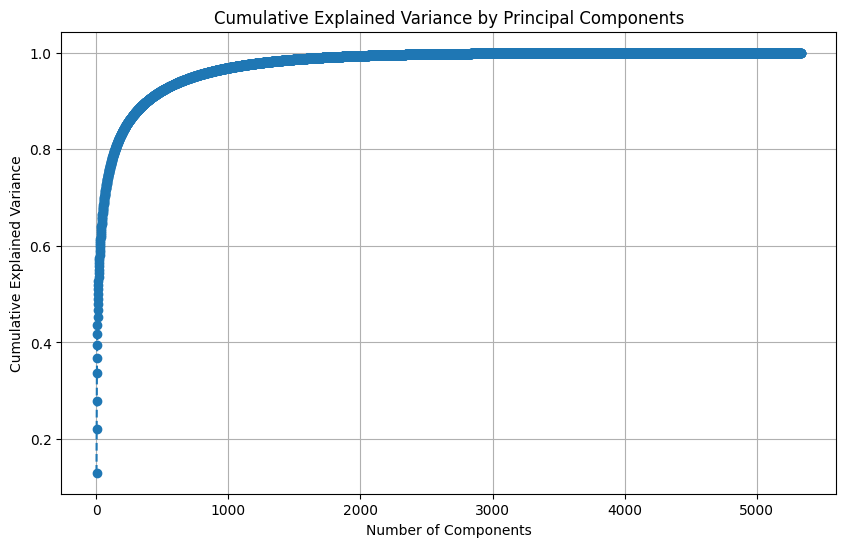

Number of components to explain 90% variance: 384
Original shape of X_combined: (5336, 7268) and for test: (1289, 7268)
Reduced shape of X_combined after PCA: (5336, 384) and for test: (1289, 384)

Applying PCA to hog_features...
PCA fitted successfully


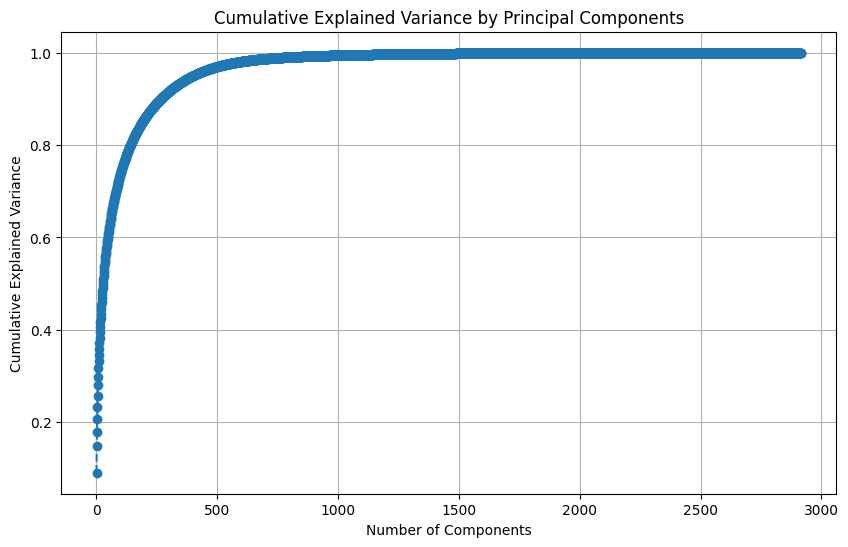

Number of components to explain 90% variance: 267
Original shape of X_combined: (5336, 2916) and for test: (1289, 2916)
Reduced shape of X_combined after PCA: (5336, 267) and for test: (1289, 267)

Applying PCA to color_features...
PCA fitted successfully


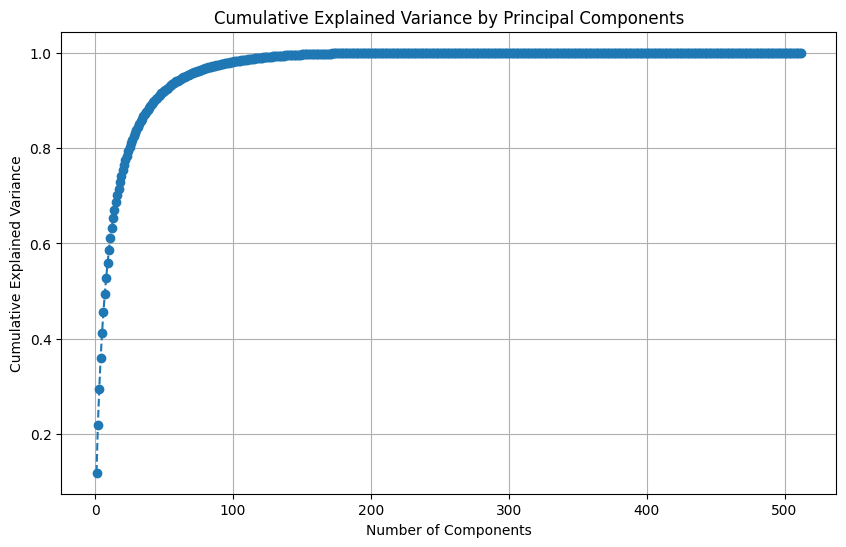

Number of components to explain 90% variance: 44
Original shape of X_combined: (5336, 512) and for test: (1289, 512)
Reduced shape of X_combined after PCA: (5336, 44) and for test: (1289, 44)

Applying PCA to hsv_features...
PCA fitted successfully


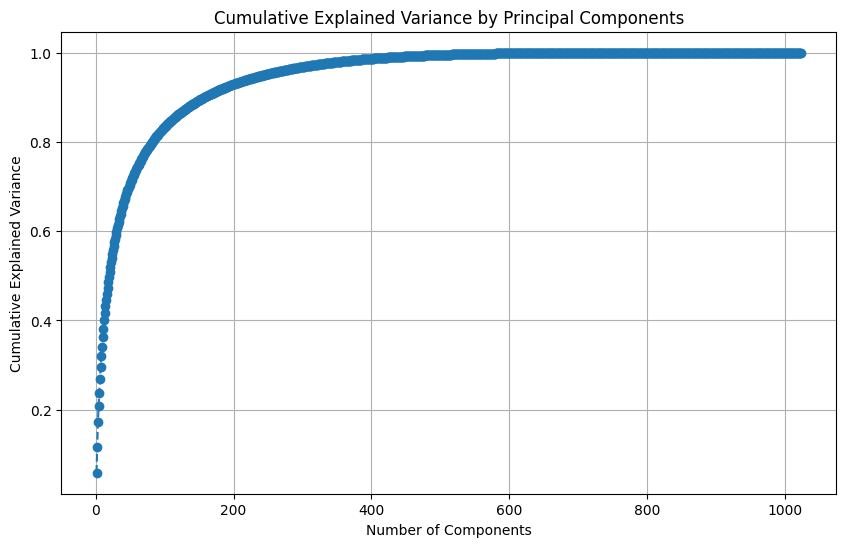

Number of components to explain 90% variance: 158
Original shape of X_combined: (5336, 1024) and for test: (1289, 1024)
Reduced shape of X_combined after PCA: (5336, 158) and for test: (1289, 158)

Applying PCA to vit_features...
PCA fitted successfully


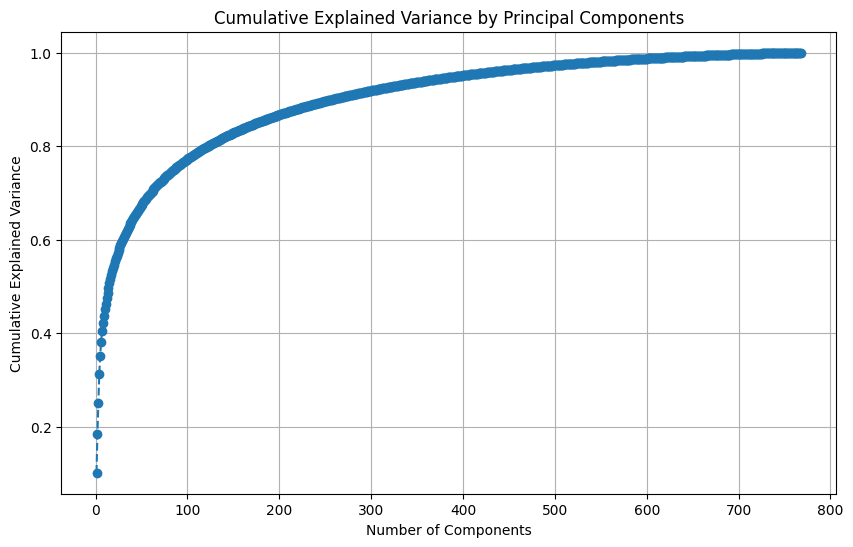

Number of components to explain 90% variance: 258
Original shape of X_combined: (5336, 768) and for test: (1289, 768)
Reduced shape of X_combined after PCA: (5336, 258) and for test: (1289, 258)

Applying PCA to resnet_features...
PCA fitted successfully


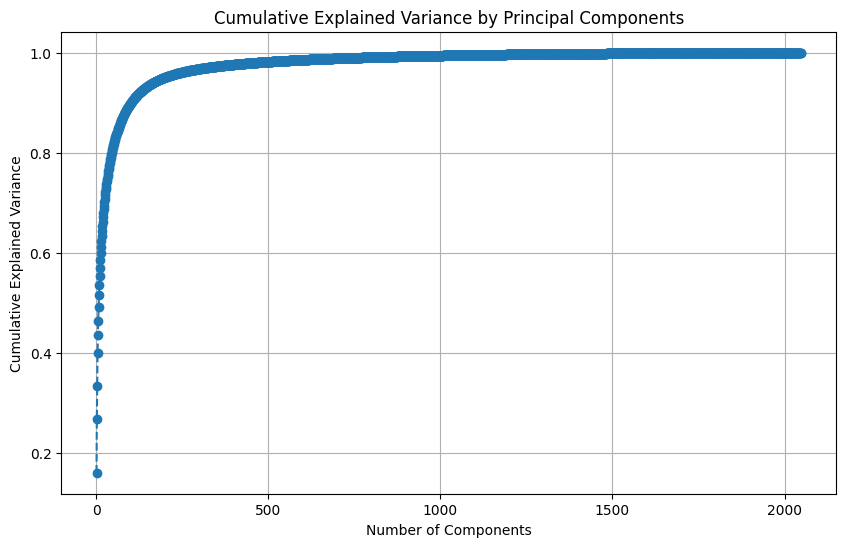

Number of components to explain 90% variance: 102
Original shape of X_combined: (5336, 2048) and for test: (1289, 2048)
Reduced shape of X_combined after PCA: (5336, 102) and for test: (1289, 102)

Applying PCA to vit_resnet_combined_features...
PCA fitted successfully


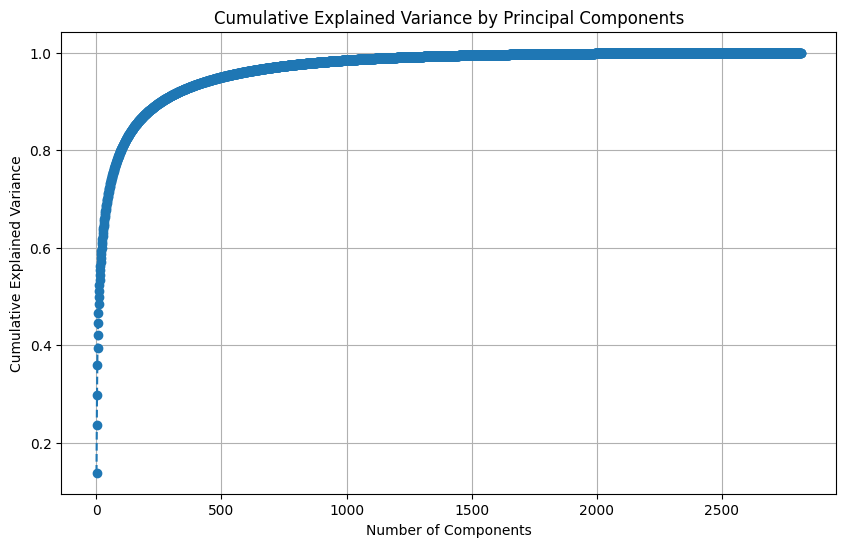

Number of components to explain 90% variance: 260
Original shape of X_combined: (5336, 2816) and for test: (1289, 2816)
Reduced shape of X_combined after PCA: (5336, 260) and for test: (1289, 260)

Applying PCA to combined_feat_no_color...
PCA fitted successfully


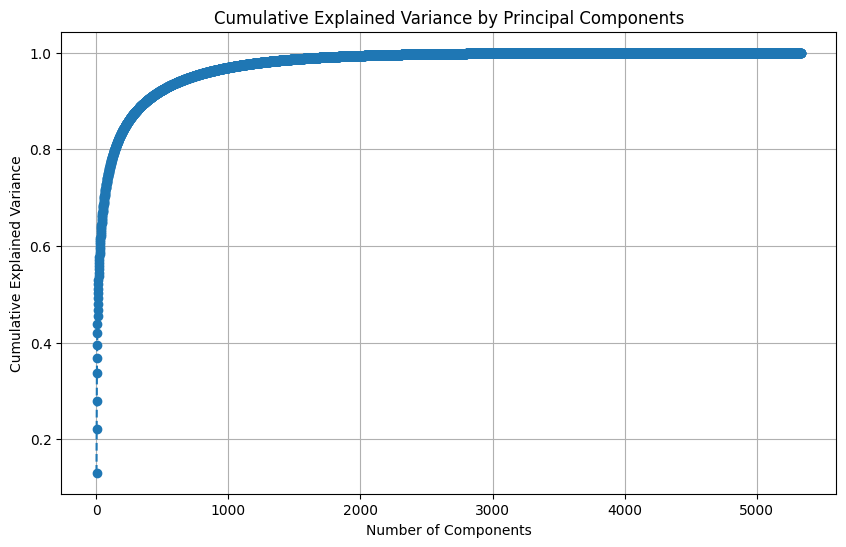

Number of components to explain 90% variance: 378
Original shape of X_combined: (5336, 6756) and for test: (1289, 6756)
Reduced shape of X_combined after PCA: (5336, 378) and for test: (1289, 378)

Applying PCA to hog_color_hsv_features...
PCA fitted successfully


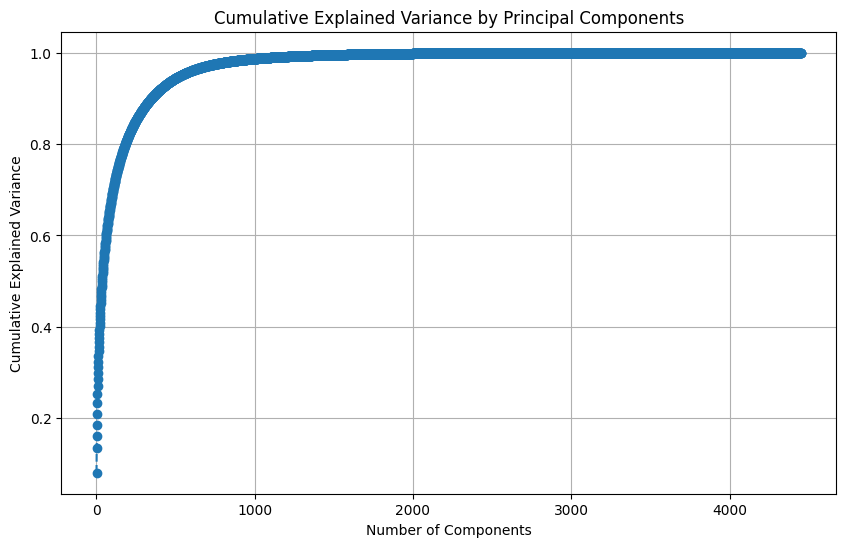

Number of components to explain 90% variance: 348
Original shape of X_combined: (5336, 4452) and for test: (1289, 4452)
Reduced shape of X_combined after PCA: (5336, 348) and for test: (1289, 348)

Applying PCA to hog_hsv_features...
PCA fitted successfully


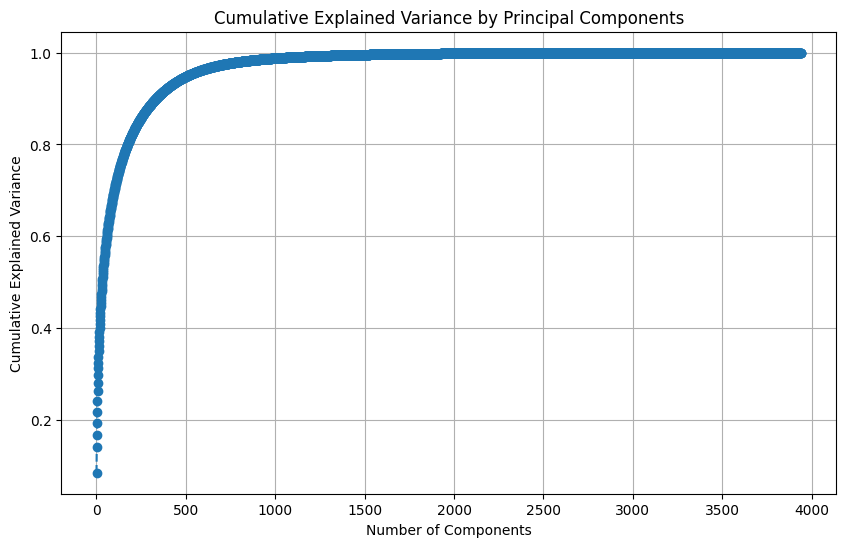

Number of components to explain 90% variance: 334
Original shape of X_combined: (5336, 3940) and for test: (1289, 3940)
Reduced shape of X_combined after PCA: (5336, 334) and for test: (1289, 334)

PCA reduction completed for all specified features.
Keys in pca_reduced_features: ['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']
Keys in pca_reduced_features: ['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']


In [ ]:
pca_train_reduced_features = {}
pca_test_reduced_features = {}

for feature_name, feature_array in feature_arrays.items():
    test_feature = feature_test_arrays[feature_name]
    print(f"\nApplying PCA to {feature_name}...")
    # The pca_calculations function already prints variance information and returns the reduced array
    train_reduced_array,test_reduced_array = pca_calculations(feature_array, test_feature)

    pca_train_reduced_features[f'{feature_name}_pca'] = train_reduced_array
    pca_test_reduced_features[f'{feature_name}_pca'] = test_reduced_array

print("\nPCA reduction completed for all specified features.")
print(f"Keys in pca_reduced_features: {list(pca_train_reduced_features.keys())}")
print(f"Keys in pca_reduced_features: {list(pca_test_reduced_features.keys())}")

## Save PCA Data

In [ ]:
import numpy as np
import os
from google.colab import drive

drive.mount('/content/drive')

# Ensure that the original `train_data` is loaded to get IDs and other metadata
# This assumes `save_path_train` and `train_data` from previous cells are correctly defined and loaded.
# If not, please re-run the cell where `train_data` is loaded (e.g., cell `FVnoENQe0Lst`).

# Prepare the dictionary for saving
data_to_save_train = {
    'id': train_data['id'],
    'landmark_id': train_data['landmark_id'],
    'category': train_data['category'],
    'label': train_data['label'],
}

# Add all PCA-reduced features from the `pca_reduced_features` dictionary
data_to_save_train.update(pca_train_reduced_features)

# Define the path for the new NPZ file
new_save_path_train = '/content/drive/MyDrive/W281/train_features_pca_combined.npz'

# Save the data to the NPZ file
np.savez_compressed(new_save_path_train, **data_to_save_train)

print(f"PCA-reduced training features and labels successfully saved to: {new_save_path_train}")
print(f"Keys saved in the NPZ file: {list(data_to_save_train.keys())}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
PCA-reduced training features and labels successfully saved to: /content/drive/MyDrive/W281/train_features_pca_combined.npz
Keys saved in the NPZ file: ['id', 'landmark_id', 'category', 'label', 'combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']


In [ ]:
import numpy as np
import os
from google.colab import drive

drive.mount('/content/drive')

# Ensure that the original `test_data` is loaded to get IDs and other metadata
# This assumes `save_path_test` and `test_data` from previous cells are correctly defined and loaded.
# If not, please re-run the cell where `test_data` is loaded (e.g., cell `FVnoENQe0Lst`).

# Prepare the dictionary for saving
data_to_save_test = {
    'id': test_data['id'],
    'landmark_id': test_data['landmark_id'],
    'category': test_data['category'],
    'label': test_data['label'],
}

# Add all PCA-reduced features from the `pca_reduced_features` dictionary
data_to_save_test.update(pca_test_reduced_features)

# Define the path for the new NPZ file
new_save_path_test = '/content/drive/MyDrive/W281/test_features_pca_combined.npz'

# Save the data to the NPZ file
np.savez_compressed(new_save_path_test, **data_to_save_test)

print(f"PCA-reduced testing features and labels successfully saved to: {new_save_path_test}")
print(f"Keys saved in the NPZ file: {list(data_to_save_test.keys())}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
PCA-reduced testing features and labels successfully saved to: /content/drive/MyDrive/W281/test_features_pca_combined.npz
Keys saved in the NPZ file: ['id', 'landmark_id', 'category', 'label', 'combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']


## Plot PCA Graph for all features

In [ ]:

def pca_calculations_combined(feature_array):
    """
    Performs PCA on a given feature array, aiming to retain 90% of the variance.
    Returns the PCA-reduced feature array and the cumulative explained variance.

    Args:
        feature_array (np.ndarray): The input feature array.

    Returns:
        tuple: (np.ndarray: The PCA-reduced feature array,
                np.ndarray: Cumulative explained variance ratio for all components)
    """
    print("PCA fitted successfully")

    # Initialize PCA to retain all components to calculate explained variance ratio
    pca_full = PCA(svd_solver='full')
    pca_full.fit(feature_array)

    # Calculate cumulative explained variance
    cum_var_exp = np.cumsum(pca_full.explained_variance_ratio_)

    # Initialize PCA to retain 90% of the variance
    pca = PCA(n_components=0.9, svd_solver='full')

    # Fit PCA on the feature array
    pca.fit(feature_array)

    # Calculate number of components to explain 90% variance
    n_components = pca.n_components_
    print(f"\nNumber of components to explain 90% variance: {n_components}")
    print(f"Original shape of feature array: {feature_array.shape}")

    # Transform the feature array
    reduced_feature_array = pca.transform(feature_array)
    print(f"Reduced shape of feature array after PCA: {reduced_feature_array.shape}")

    return reduced_feature_array, cum_var_exp

pca_reduced_features = {}
all_cum_var_exp_curves = {} # New dictionary to store cumulative variance curves

for feature_name, feature_array in feature_arrays.items():
    print(f"\nApplying PCA to {feature_name}...")
    # The pca_calculations_combined function now returns the reduced array and the cumulative variance
    reduced_array, cum_var_exp = pca_calculations_combined(feature_array)
    pca_reduced_features[f'{feature_name}_pca'] = reduced_array
    all_cum_var_exp_curves[feature_name] = cum_var_exp # Store the curve

print("\nPCA reduction completed for all specified features.")
print(f"Keys in pca_reduced_features: {list(pca_reduced_features.keys())}")
print(f"Keys in all_cum_var_exp_curves: {list(all_cum_var_exp_curves.keys())}")



Applying PCA to combined_features...
PCA fitted successfully

Number of components to explain 90% variance: 384
Original shape of feature array: (5336, 7268)
Reduced shape of feature array after PCA: (5336, 384)

Applying PCA to hog_features...
PCA fitted successfully

Number of components to explain 90% variance: 267
Original shape of feature array: (5336, 2916)
Reduced shape of feature array after PCA: (5336, 267)

Applying PCA to color_features...
PCA fitted successfully

Number of components to explain 90% variance: 44
Original shape of feature array: (5336, 512)
Reduced shape of feature array after PCA: (5336, 44)

Applying PCA to hsv_features...
PCA fitted successfully

Number of components to explain 90% variance: 158
Original shape of feature array: (5336, 1024)
Reduced shape of feature array after PCA: (5336, 158)

Applying PCA to vit_features...
PCA fitted successfully

Number of components to explain 90% variance: 258
Original shape of feature array: (5336, 768)
Reduced sha

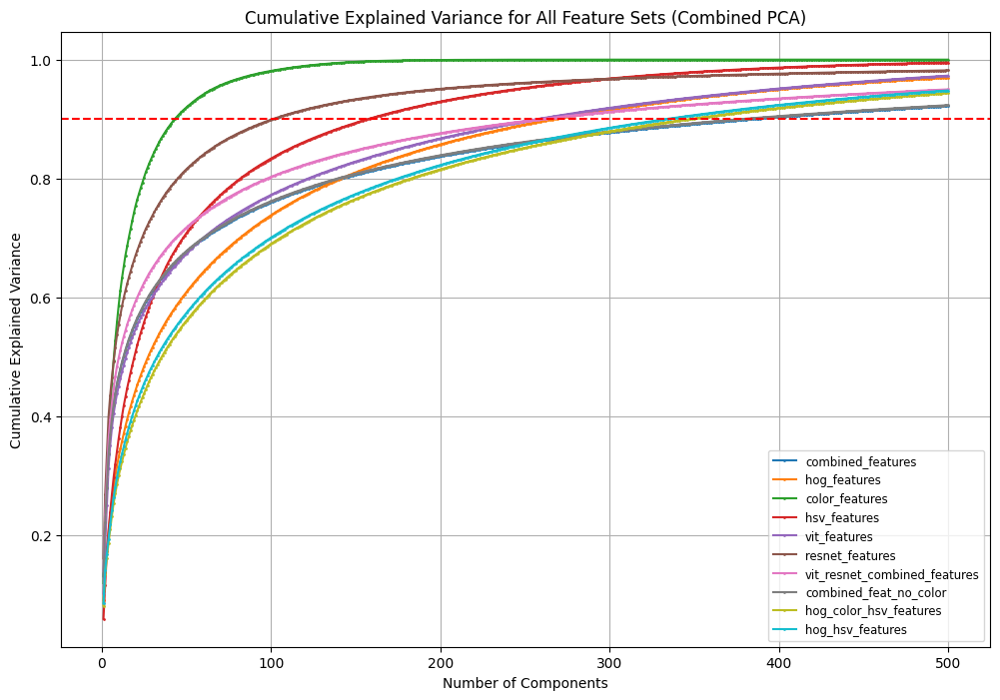

In [ ]:
# --- Plotting all cumulative explained variance curves on a single graph ---
plt.figure(figsize=(12, 8))
for feature_name, cum_var_exp in all_cum_var_exp_curves.items():
    # Limit to a reasonable number of components for plotting if too many (e.g., first 500)
    max_components_to_plot = min(len(cum_var_exp), 500) # Adjust this limit as needed
    plt.plot(range(1, max_components_to_plot + 1), cum_var_exp[:max_components_to_plot],
             marker='.', linestyle='-', markersize=2, label=feature_name)

plt.title('Cumulative Explained Variance for All Feature Sets (Combined PCA)')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.legend(loc='lower right', fontsize='small')
plt.grid(True)
plt.axhline(y=0.90, color='r', linestyle='--', label='90% Variance Threshold')
plt.show()


## Display PCA for all features

Category labels encoded successfully.
Original categories sample: ['Golden_Gate_Bridge' 'Nieuwe_Waterweg' 'Niagara_Falls' 'Matka_Canyon'
 'Edinburgh_Castle']
Encoded categories sample: [2 6 5 4 0]
Unique encoded values: [0 1 2 3 4 5 6 7]
Mapping: [(np.str_('Edinburgh_Castle'), np.int64(0)), (np.str_('Eiffel_Tower'), np.int64(1)), (np.str_('Golden_Gate_Bridge'), np.int64(2)), (np.str_('Grand_Canyon'), np.int64(3)), (np.str_('Matka_Canyon'), np.int64(4)), (np.str_('Niagara_Falls'), np.int64(5)), (np.str_('Nieuwe_Waterweg'), np.int64(6)), (np.str_('Skopje_Fortress'), np.int64(7))]

Applying PCA (2 components) to combined_features_pca for visualization...
  Variance explained by PC1: 14.48%
  Variance explained by PC2: 10.02%
  Total variance explained by 2 components: 24.50%


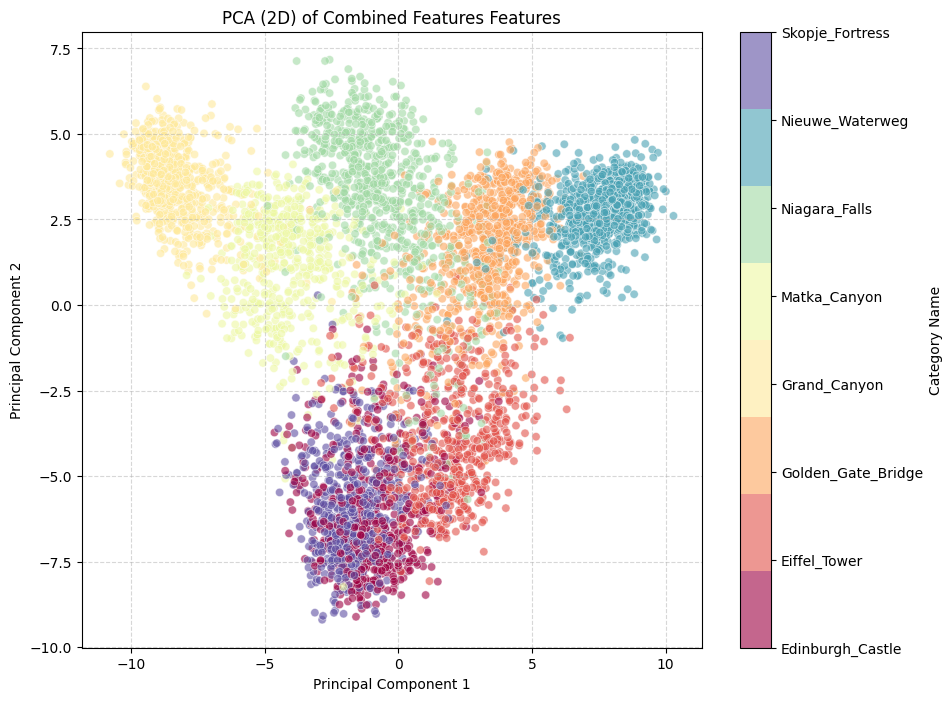


Applying PCA (2 components) to hog_features_pca for visualization...
  Variance explained by PC1: 10.03%
  Variance explained by PC2: 6.52%
  Total variance explained by 2 components: 16.55%


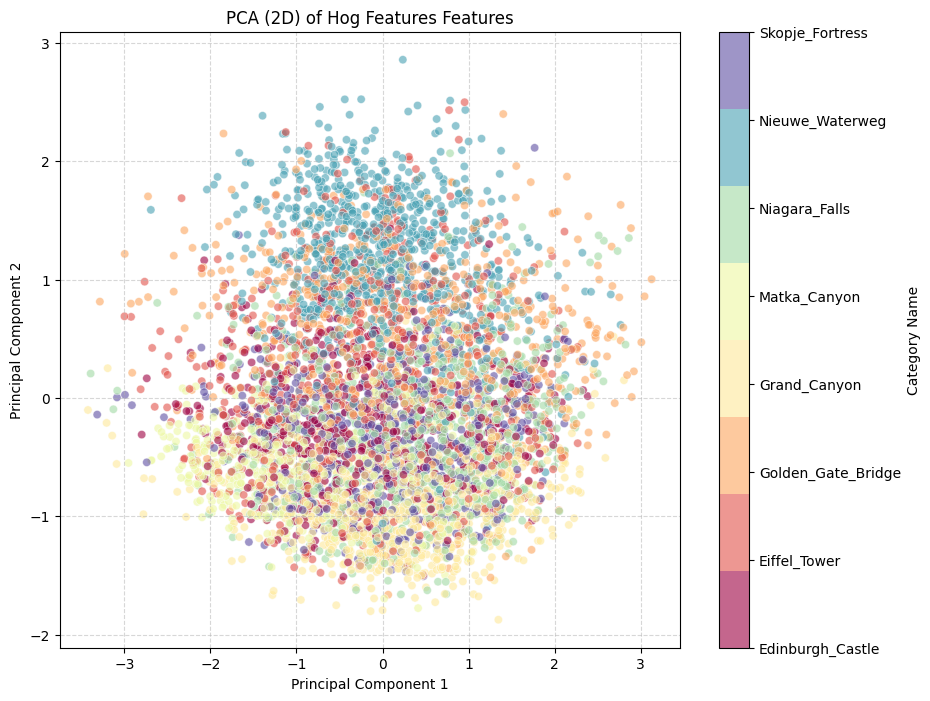


Applying PCA (2 components) to color_features_pca for visualization...
  Variance explained by PC1: 13.17%
  Variance explained by PC2: 11.19%
  Total variance explained by 2 components: 24.36%


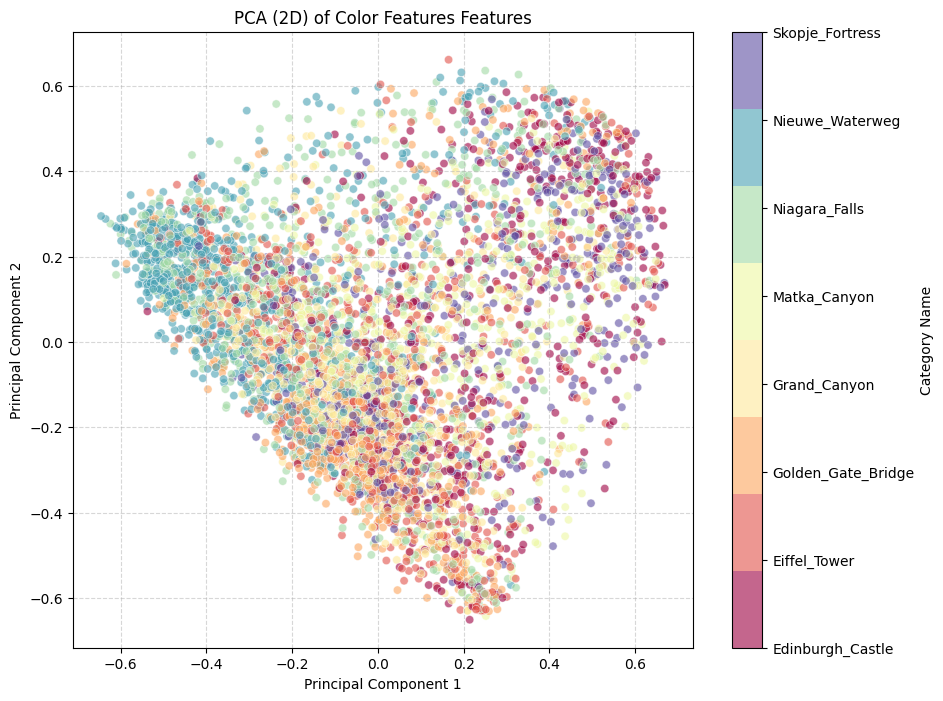


Applying PCA (2 components) to hsv_features_pca for visualization...
  Variance explained by PC1: 6.54%
  Variance explained by PC2: 6.36%
  Total variance explained by 2 components: 12.90%


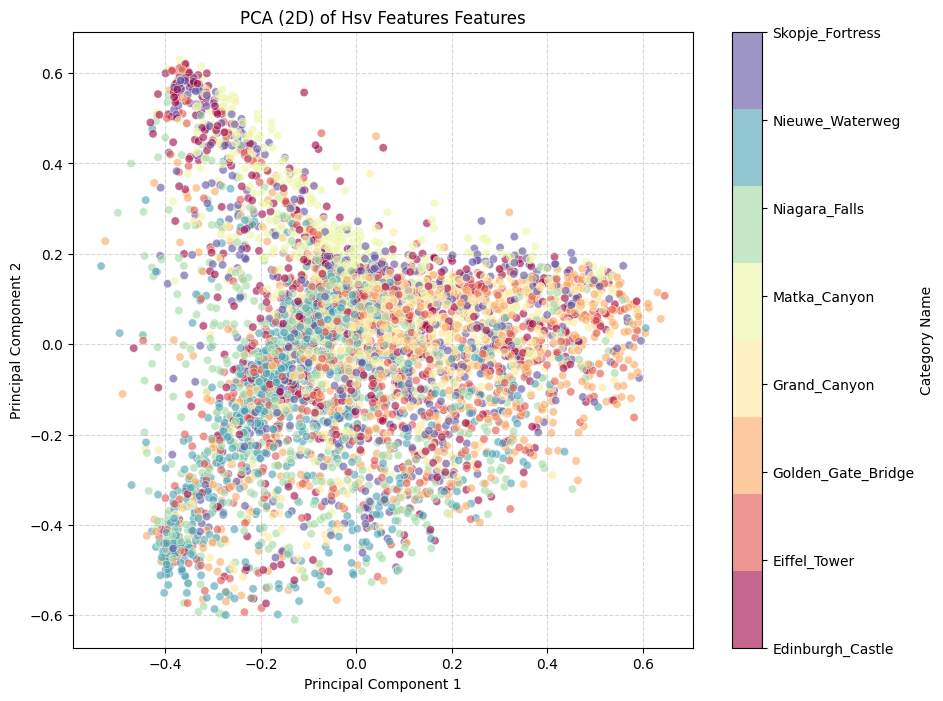


Applying PCA (2 components) to vit_features_pca for visualization...
  Variance explained by PC1: 11.26%
  Variance explained by PC2: 9.29%
  Total variance explained by 2 components: 20.55%


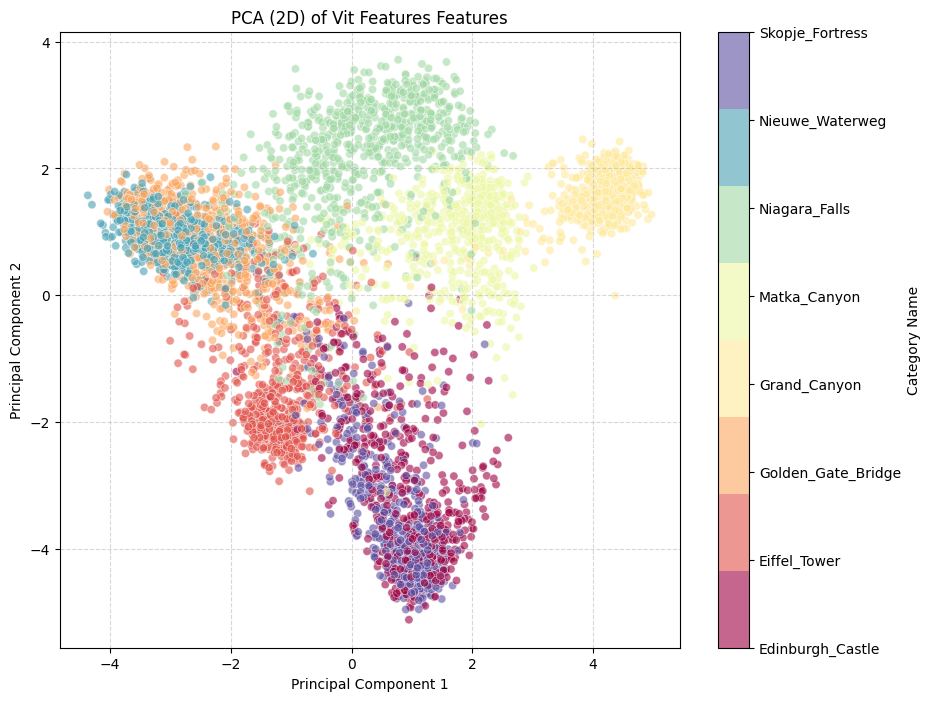


Applying PCA (2 components) to resnet_features_pca for visualization...
  Variance explained by PC1: 17.82%
  Variance explained by PC2: 11.97%
  Total variance explained by 2 components: 29.78%


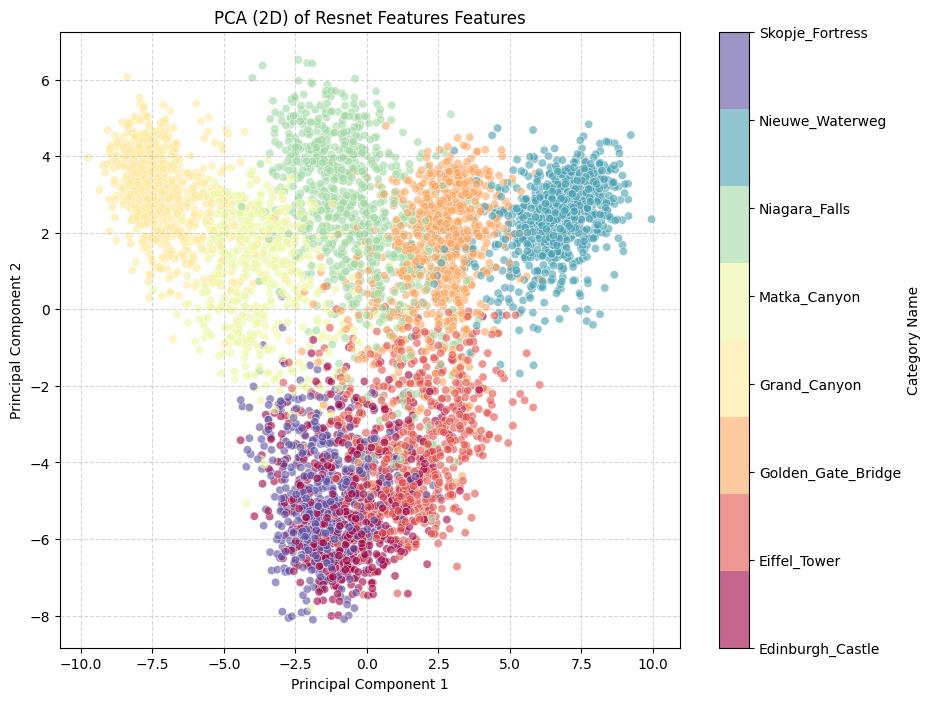


Applying PCA (2 components) to vit_resnet_combined_features_pca for visualization...
  Variance explained by PC1: 15.38%
  Variance explained by PC2: 10.80%
  Total variance explained by 2 components: 26.18%


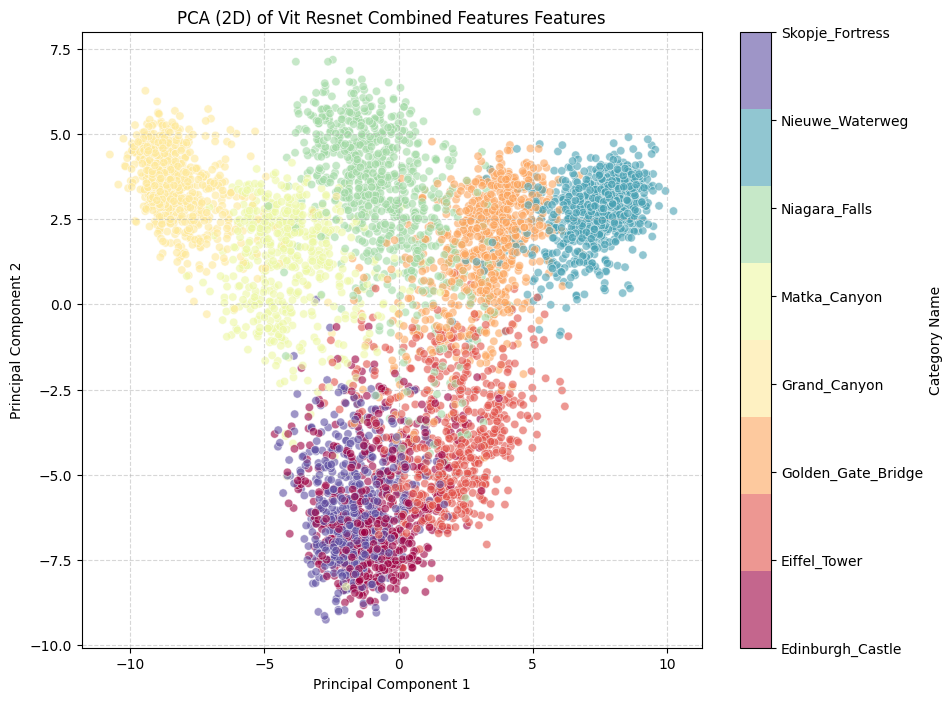


Applying PCA (2 components) to combined_feat_no_color_pca for visualization...
  Variance explained by PC1: 14.53%
  Variance explained by PC2: 10.04%
  Total variance explained by 2 components: 24.57%


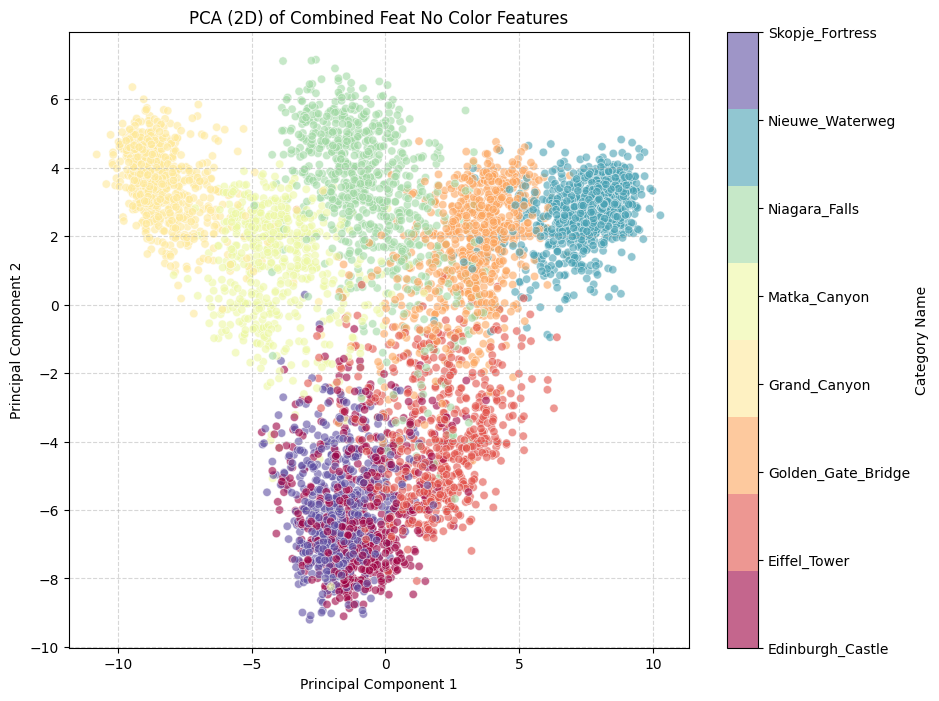


Applying PCA (2 components) to hog_color_hsv_features_pca for visualization...
  Variance explained by PC1: 8.97%
  Variance explained by PC2: 5.99%
  Total variance explained by 2 components: 14.96%


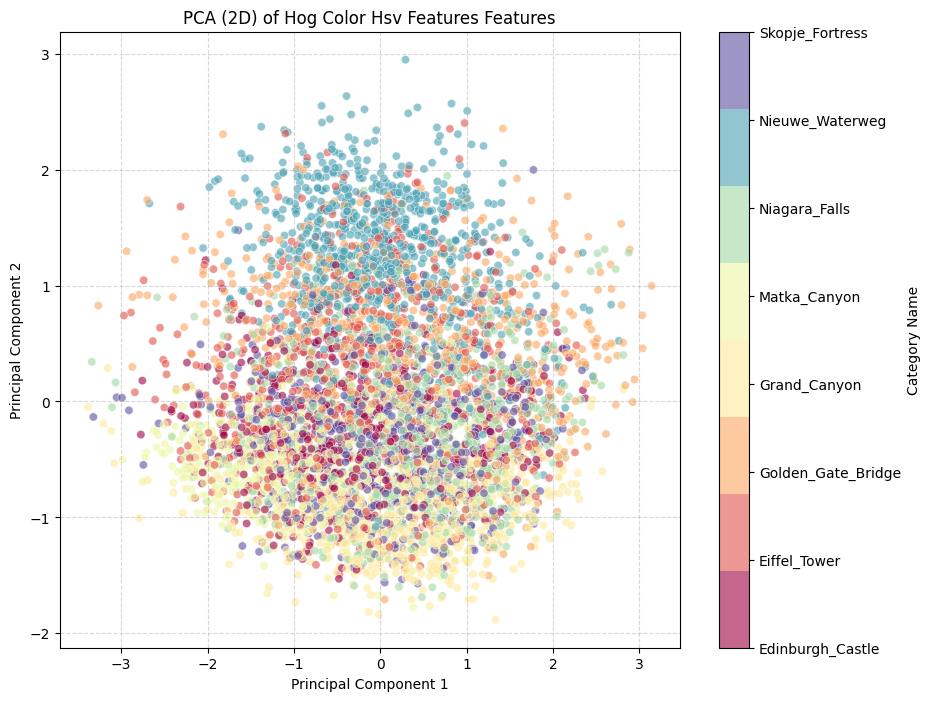


Applying PCA (2 components) to hog_hsv_features_pca for visualization...
  Variance explained by PC1: 9.41%
  Variance explained by PC2: 6.16%
  Total variance explained by 2 components: 15.57%


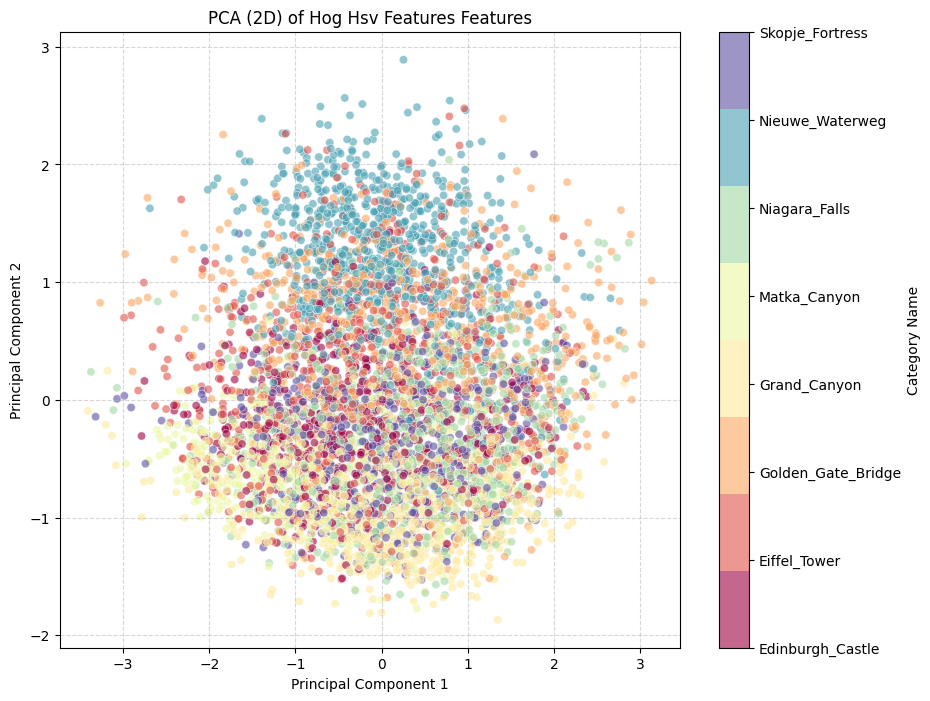

2D PCA plots generated for all feature sets.


In [ ]:
# Load the training PCA data
save_path_train_pca = '/content/drive/MyDrive/W281/train_features_pca_combined.npz'
train_pca_data = np.load(save_path_train_pca, allow_pickle=True)

# Extract the 'category' array
category_train_combined = train_pca_data['category']

# Instantiate a LabelEncoder object
le = LabelEncoder()

# Fit and transform the extracted category names to obtain numerical labels
y_category_encoded = le.fit_transform(category_train_combined)

print("Category labels encoded successfully.")
print(f"Original categories sample: {category_train_combined[:5]}")
print(f"Encoded categories sample: {y_category_encoded[:5]}")
print(f"Unique encoded values: {np.unique(y_category_encoded)}")
print(f"Mapping: {list(zip(le.classes_, le.transform(le.classes_)))}")

# Get the number of unique classes for coloring
NUM_CLASSES = len(np.unique(y_category_encoded))

# Create a colormap for consistent coloring across plots
cmap = plt.get_cmap('Spectral', NUM_CLASSES)

# Iterate through each PCA-reduced feature set in train_pca_data
# Exclude non-feature keys like 'id', 'landmark_id', 'category', 'label'
excluded_keys = ['id', 'landmark_id', 'category', 'label']

for key in train_pca_data.files:
    if key not in excluded_keys and key.endswith('_pca'):
        feature_name = key
        X_feature = train_pca_data[feature_name]

        print(f"\nApplying PCA (2 components) to {feature_name} for visualization...")

        # Apply PCA to reduce to 2 components for plotting
        pca_2d_plot = PCA(n_components=2)
        X_2d = pca_2d_plot.fit_transform(X_feature)

        # Calculate explained variance for the 2 components
        explained_variance_ratio = pca_2d_plot.explained_variance_ratio_
        print(f"  Variance explained by PC1: {explained_variance_ratio[0]*100:.2f}%")
        print(f"  Variance explained by PC2: {explained_variance_ratio[1]*100:.2f}%")
        print(f"  Total variance explained by 2 components: {explained_variance_ratio.sum()*100:.2f}%")

        # Plotting
        plt.figure(figsize=(10, 8))
        scatter = plt.scatter(
            X_2d[:, 0],
            X_2d[:, 1],
            c=y_category_encoded,
            cmap=cmap,
            alpha=0.6,
            edgecolors='w',
            linewidths=0.5
        )

        plt.xlabel('Principal Component 1')
        plt.ylabel('Principal Component 2')
        # Format title for better readability
        title = f'PCA (2D) of {feature_name.replace("_pca", "").replace("_", " ").title()} Features'
        plt.title(title)

        # Add color bar with actual category names
        cbar = plt.colorbar(scatter, ticks=np.unique(y_category_encoded))
        cbar.ax.set_yticklabels(le.inverse_transform(np.unique(y_category_encoded)))
        cbar.set_label('Category Name')

        plt.grid(True, linestyle='--', alpha=0.5)
        plt.show()

print("2D PCA plots generated for all feature sets.")

### Quick check on code

In [ ]:
#Load data if needed
save_path_test_pca = '/content/drive/MyDrive/W281/test_features_pca_combined.npz'
test_pca_data = np.load(save_path_test_pca, allow_pickle=True)

# To see all available keys in test_pca_data:
print(f"Keys available in test_pca_data: {list(test_pca_data.keys())}")

# Check other arrays, for example, the labels:
if 'label' in test_pca_data:
    first_two_labels = test_pca_data['label'][:2]
    print("\nFirst 2 labels:")
    print(first_two_labels)
else:
    print("\n'label' key not found in test_pca_data.")

# Check other arrays for category:
if 'category' in test_pca_data:
    first_two_category = test_pca_data['category'][:2]
    print("\nFirst 2 categories:")
    print(first_two_category)
else:
    print("\n'category' key not found in test_pca_data.")


Keys available in test_pca_data: ['id', 'landmark_id', 'category', 'label', 'combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']

First 2 labels:
[ 3 41]

First 2 categories:
['Matka_Canyon' 'Nieuwe_Waterweg']


In [ ]:
# Ensure test_pca_data is loaded
# save_path_test_pca = '/content/drive/MyDrive/W281/test_features_pca_combined.npz'
# test_pca_data = np.load(save_path_test_pca, allow_pickle=True)

# Access the 'label' and 'category' arrays
test_labels = test_pca_data['label']
test_categories = test_pca_data['category']

# Combine the arrays into a 2D array for finding unique combinations
combinations = np.column_stack((test_labels, test_categories))

# Find unique combinations
unique_combinations = np.unique(combinations, axis=0)

print("Unique combinations of 'label' and 'category' in test_pca_data:")
for combo in unique_combinations:
    print(f"  Label: {combo[0]}, Category: {combo[1]}")


Unique combinations of 'label' and 'category' in test_pca_data:
  Label: 10, Category: Eiffel_Tower
  Label: 19, Category: Golden_Gate_Bridge
  Label: 2, Category: Niagara_Falls
  Label: 3, Category: Matka_Canyon
  Label: 36, Category: Skopje_Fortress
  Label: 39, Category: Edinburgh_Castle
  Label: 41, Category: Nieuwe_Waterweg
  Label: 46, Category: Grand_Canyon


# tSNE





t-SNE dimensionality reduction was successfully applied to all PCA-reduced feature sets available in pca_train_reduced_features. Each feature set was reduced to 2 components.
For each feature set, a 2D scatter plot was generated displaying the t-SNE embeddings. Points in these plots were colored according to their corresponding class labels from y_train_combined.
The t-SNE algorithm was configured with n_components=2, perplexity=30, max_iter=1000, learning_rate='auto', and init='random'.
The process involved troubleshooting and resolving several technical issues, including a FutureWarning regarding n_iter in TSNE, a MatplotlibDeprecationWarning for cm.get_cmap, a NameError due to missing matplotlib import, and a TypeError for matplotlib.colormaps.get_cmap() due to incorrect argument usage.




The generated t-SNE plots offer a visual representation of class separability within different feature sets. Analyzing these plots can provide insights into which feature engineering approach (e.g., combined features, HOG, etc.) yields the most distinct clusters for classification.
The t-SNE output can serve as a lower-dimensional input for machine learning models or as a tool for further exploratory data analysis to identify potential outliers or sub-clusters within classes.

## Display tSNE for all features


Applying t-SNE to combined_features_pca...
Original PCA-reduced shape: (5336, 384)
t-SNE reduced shape: (5336, 2)


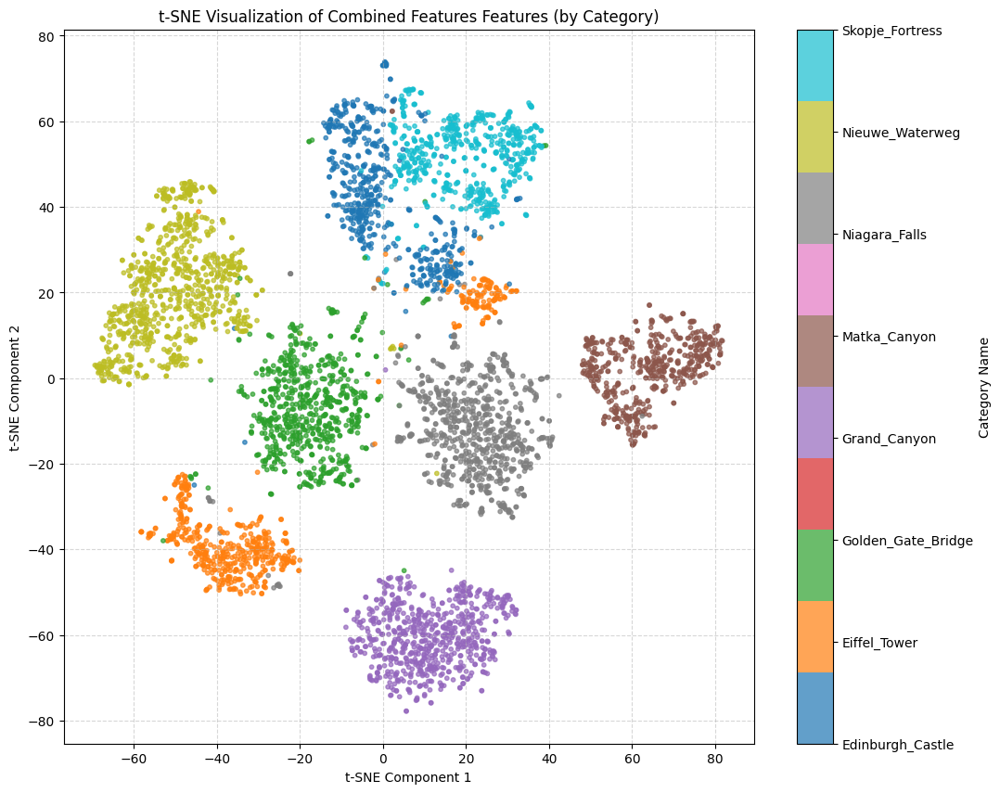


Applying t-SNE to hog_features_pca...
Original PCA-reduced shape: (5336, 267)
t-SNE reduced shape: (5336, 2)


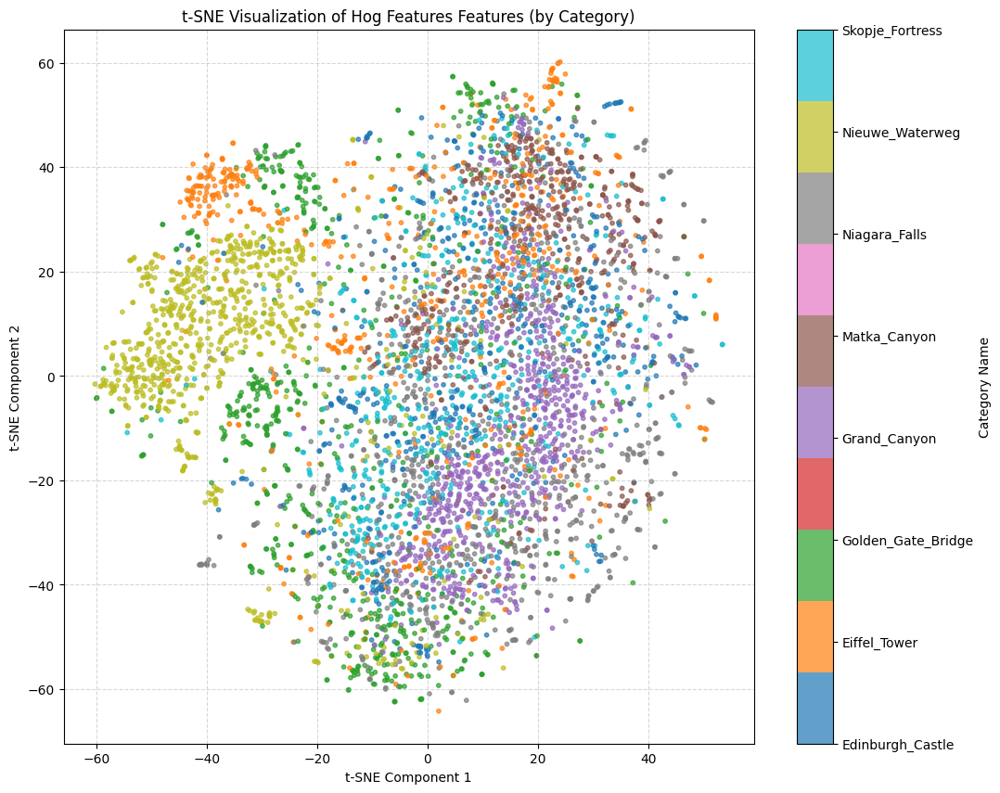


Applying t-SNE to color_features_pca...
Original PCA-reduced shape: (5336, 44)
t-SNE reduced shape: (5336, 2)


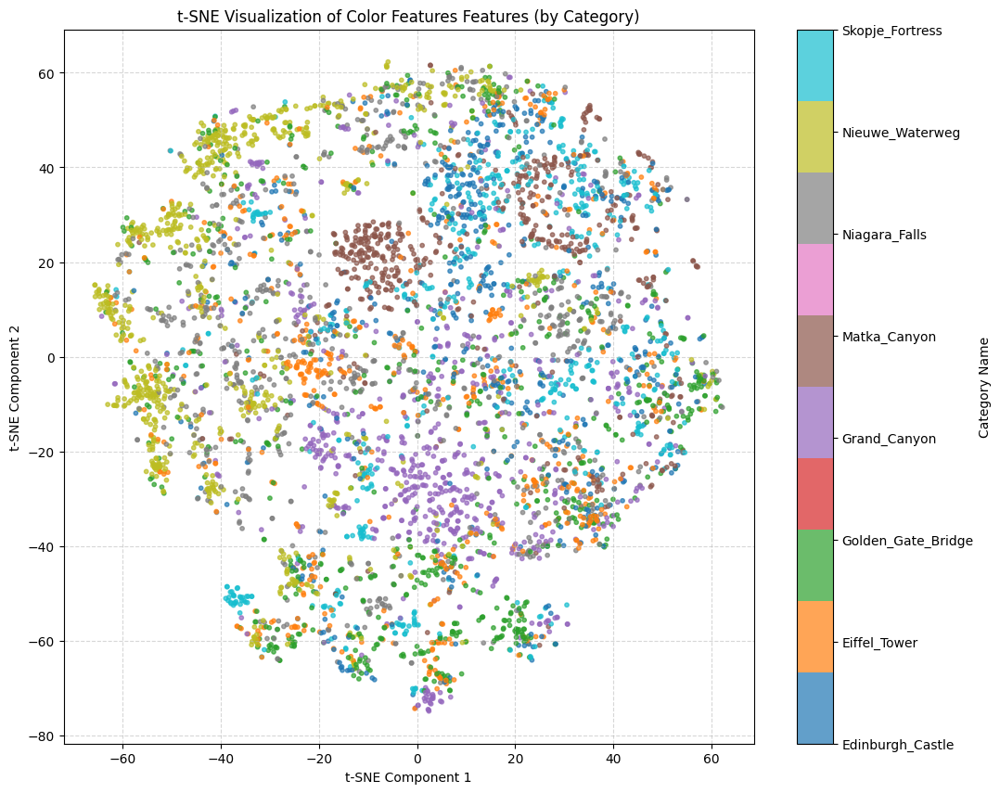


Applying t-SNE to hsv_features_pca...
Original PCA-reduced shape: (5336, 158)
t-SNE reduced shape: (5336, 2)


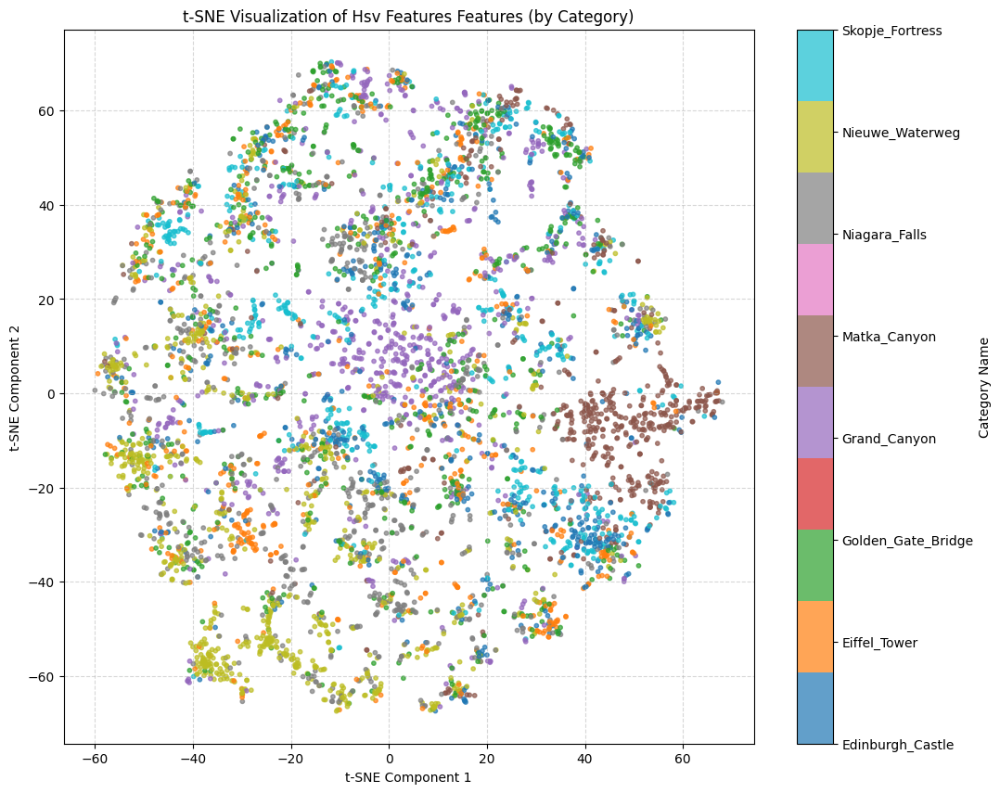


Applying t-SNE to vit_features_pca...
Original PCA-reduced shape: (5336, 258)
t-SNE reduced shape: (5336, 2)


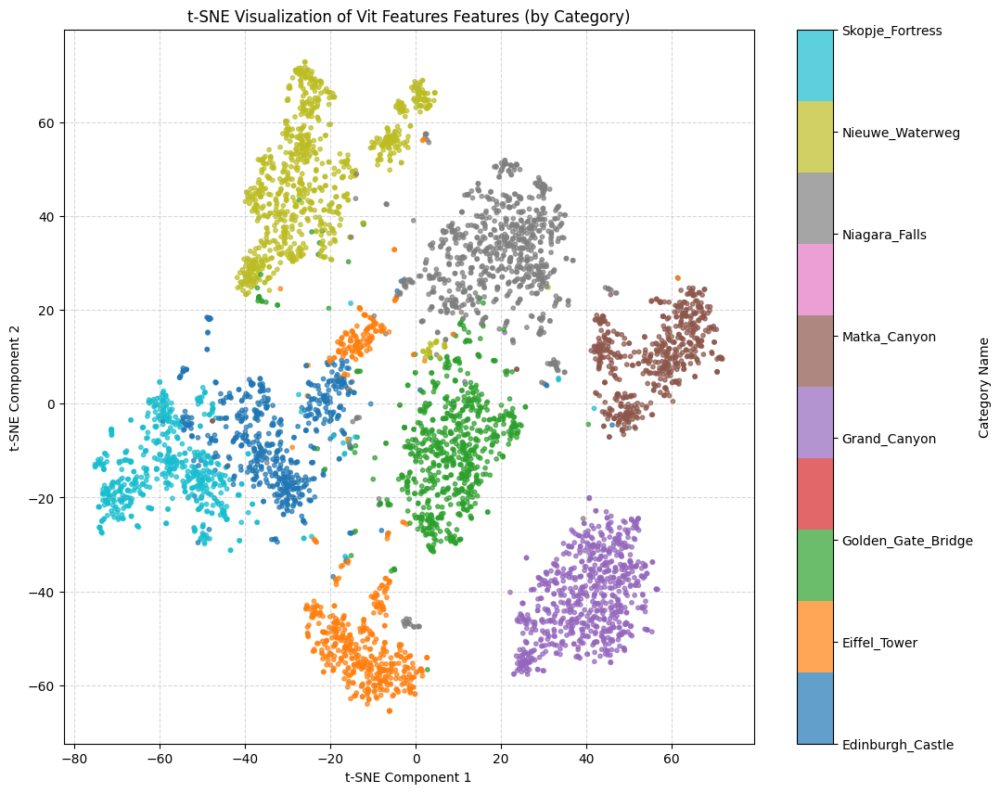


Applying t-SNE to resnet_features_pca...
Original PCA-reduced shape: (5336, 102)
t-SNE reduced shape: (5336, 2)


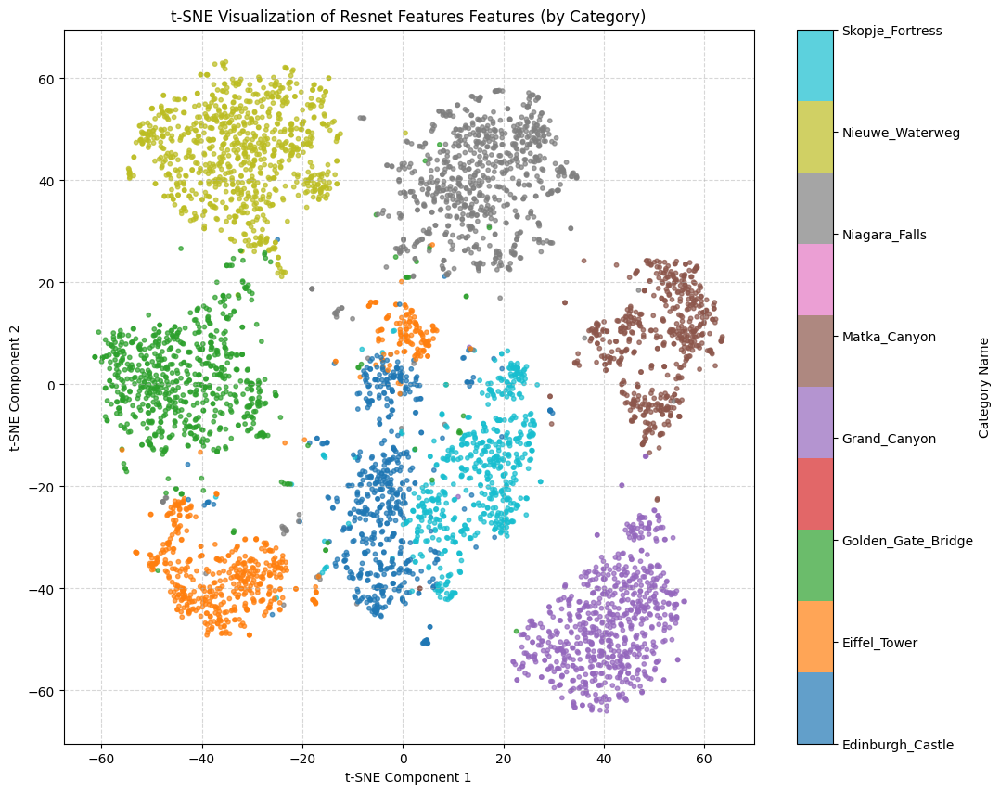


Applying t-SNE to vit_resnet_combined_features_pca...
Original PCA-reduced shape: (5336, 260)
t-SNE reduced shape: (5336, 2)


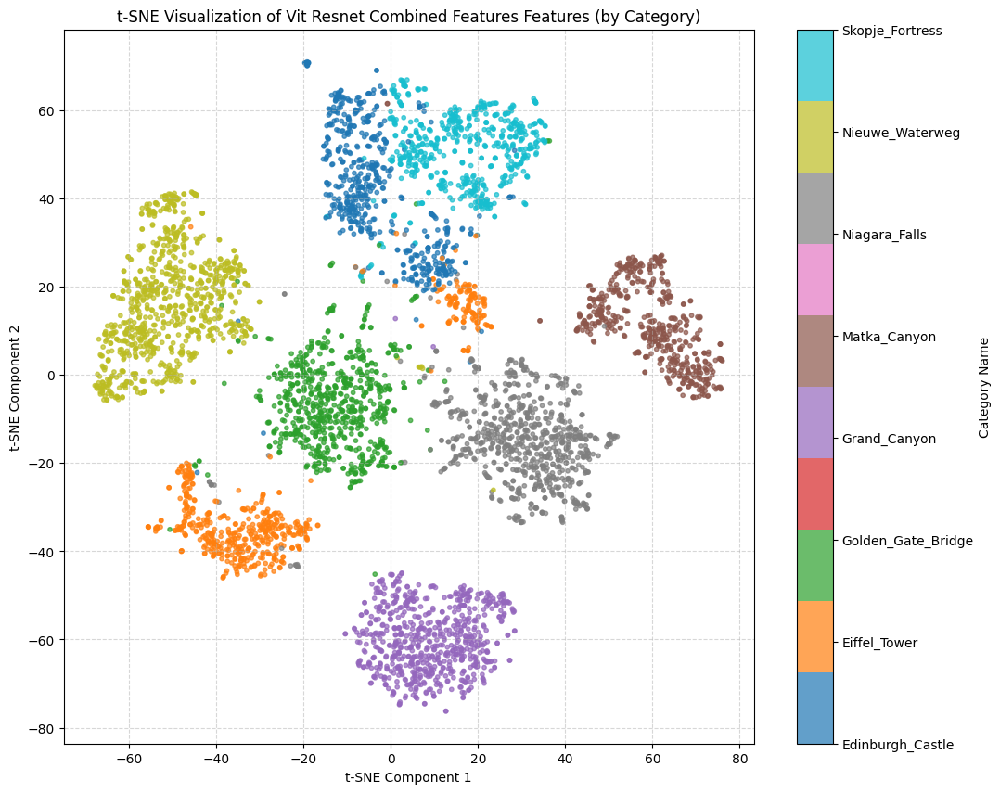


Applying t-SNE to combined_feat_no_color_pca...
Original PCA-reduced shape: (5336, 378)
t-SNE reduced shape: (5336, 2)


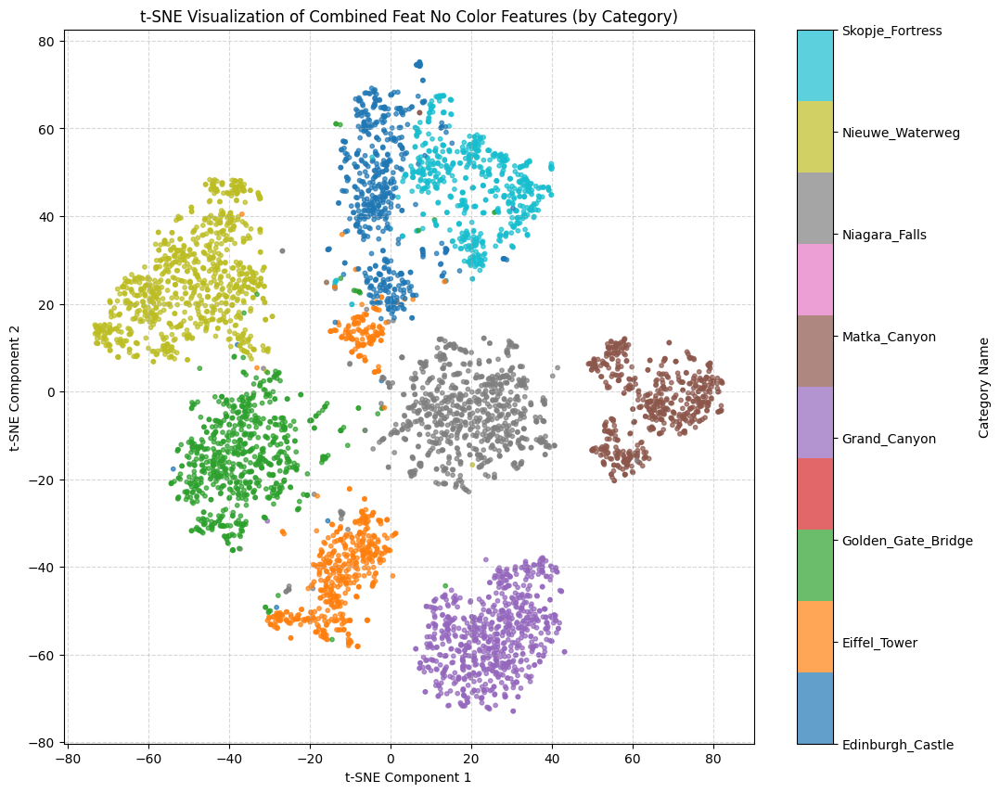


Applying t-SNE to hog_color_hsv_features_pca...
Original PCA-reduced shape: (5336, 348)
t-SNE reduced shape: (5336, 2)


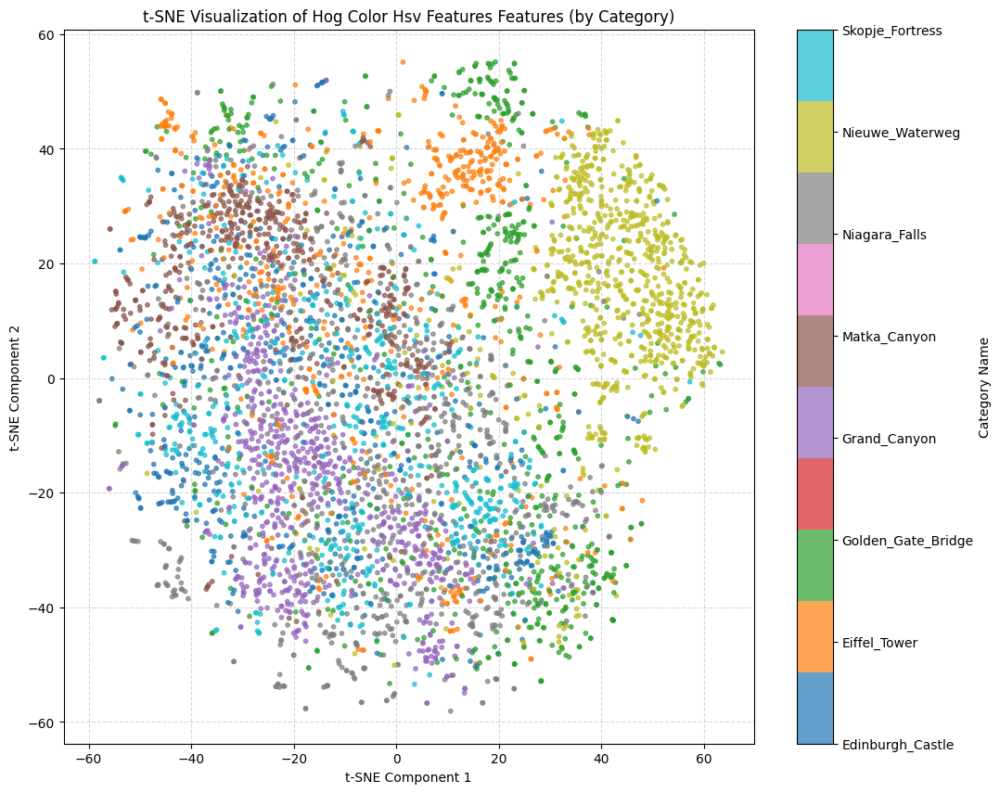


Applying t-SNE to hog_hsv_features_pca...
Original PCA-reduced shape: (5336, 334)
t-SNE reduced shape: (5336, 2)


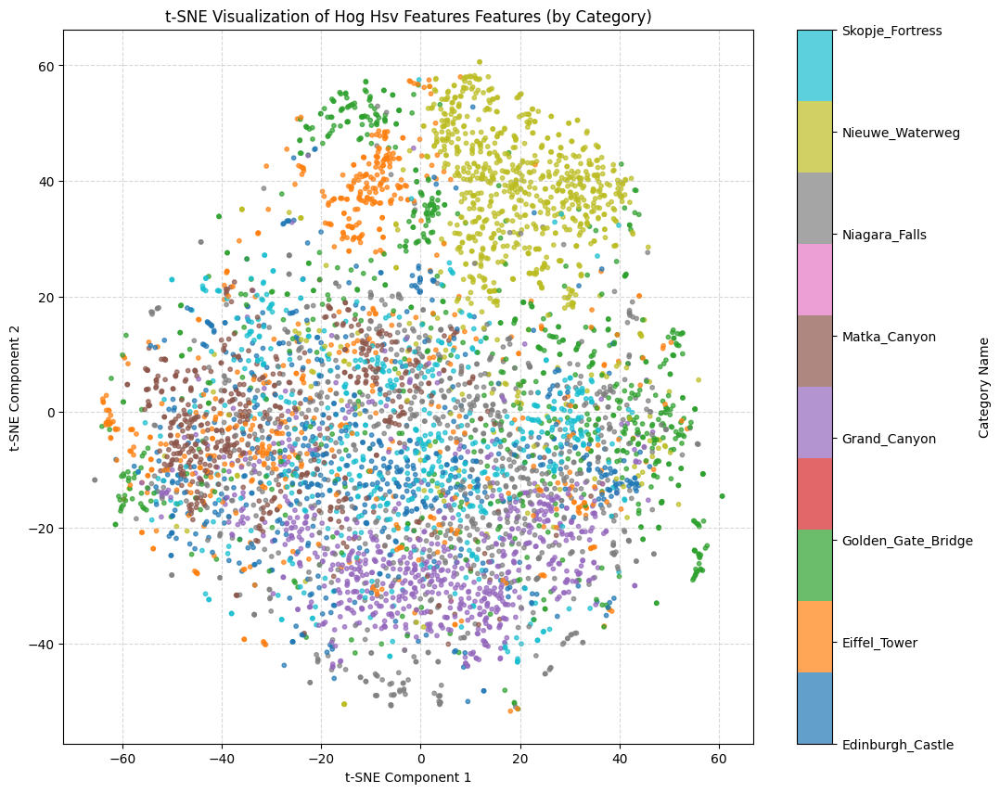

In [ ]:
import matplotlib
from sklearn.preprocessing import LabelEncoder

# Create a LabelEncoder to convert category names to numerical values for plotting
le = LabelEncoder()
y_category_encoded = le.fit_transform(category_train_combined)

for feature_name, X_pca_reduced in pca_train_reduced_features.items():
    print(f"\nApplying t-SNE to {feature_name}...")

    # Apply t-SNE to reduce to 2 components
    # Using a smaller perplexity and max_iter for potentially faster computation and clearer visualization
    tsne = TSNE(n_components=2, random_state=42, perplexity=30, max_iter=1000, learning_rate='auto', init='random')
    X_tsne_2d = tsne.fit_transform(X_pca_reduced)

    print(f"Original PCA-reduced shape: {X_pca_reduced.shape}")
    print(f"t-SNE reduced shape: {X_tsne_2d.shape}")

    # Get the number of unique classes for coloring
    num_classes = len(np.unique(y_category_encoded))
    # Corrected: removed num_classes as a second argument to get_cmap
    cmap = matplotlib.colormaps.get_cmap('tab10')

    # Plotting
    plt.figure(figsize=(12, 10))
    scatter = plt.scatter(X_tsne_2d[:, 0], X_tsne_2d[:, 1], c=y_category_encoded, cmap=cmap, alpha=0.7, s=10)

    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.title(f't-SNE Visualization of {feature_name.replace("_pca", "").replace("_", " ").title()} Features (by Category)')
    # Use the inverse_transform to get original category names for colorbar labels
    cbar = plt.colorbar(scatter, ticks=np.unique(y_category_encoded), label='Category Name')
    cbar.ax.set_yticklabels(le.inverse_transform(np.unique(y_category_encoded)))
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.show()


# CHECKPOINT 2 - Load PCA Datasets

In [16]:
save_path_train = '/content/drive/MyDrive/W281/train_features_pca_combined.npz'
train_pca_data = np.load(save_path_train, allow_pickle=True)

save_path_test = '/content/drive/MyDrive/W281/test_features_pca_combined.npz'
test_pca_data = np.load(save_path_test, allow_pickle=True)

print(f"Train Keys in loaded data: {train_pca_data.files}")
print(f"Test Keys in loaded data: {test_pca_data.files}")

Train Keys in loaded data: ['id', 'landmark_id', 'category', 'label', 'combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']
Test Keys in loaded data: ['id', 'landmark_id', 'category', 'label', 'combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']


# Classification

## Logistic Regression

### Logistic Regression -Training the models

Train models for each feature and and feature combinations

In [ ]:


# Load data
from google.colab import drive
# drive.mount('/content/drive') # Removed duplicate mount call
save_path = '/content/drive/MyDrive/W281/train_features_pca_combined.npz'
data = np.load(save_path, allow_pickle=True)
print(f"Data loaded from: {save_path}")

# Accessing contents of the loaded .npz file
# data.files will show the keys available
print(f"Keys in loaded data: {data.files}")

def lr_classification(data,feature):
  # Assign features (X) and labels (y) from the loaded data
  X = data[feature]
  y_numeric_labels = data["label"] # Original integer labels
  y_category_names = data["category"] # Original string category names

  print(f"The features used:{feature}")

  # Create a robust mapping from numeric label to its corresponding string category name
  # This handles cases where 'label' and 'category' might not be perfectly aligned by index
  # by ensuring a unique mapping for each numerical label present in the dataset.
  unique_label_category_pairs = np.unique(np.column_stack((y_numeric_labels, y_category_names)), axis=0)
  label_to_category_name_map = {int(pair[0]): pair[1] for pair in unique_label_category_pairs}

  # Encode labels (transform original numeric labels to 0-indexed for sklearn models)
  le = LabelEncoder()
  y_enc = le.fit_transform(y_numeric_labels)

  # Create the target_names list for classification_report using the map and le.classes_
  # le.classes_ now contains the sorted unique *original numerical labels* (e.g., [2, 3, 10, ...])
  # We use the map to convert these back to their *string names*.
  report_target_names = [label_to_category_name_map[original_label] for original_label in le.classes_]

  # Split into train/validation sets
  X_train, X_val, y_train, y_val = train_test_split(
      X, y_enc, test_size=0.2, random_state=42, stratify=y_enc
  )

  # Train model
  # Define parameter grid to search
  param_grid = {
      'C': [0.1, 1],
      'penalty': ['l1', 'l2'],
      'solver': ['liblinear', 'saga'],
      'max_iter': [1000, 2000]
  }

  # Create base model
  # Ensure class_weight is balanced for potentially imbalanced datasets
  start_time = time.time()
  clf = LogisticRegression(random_state=42, class_weight='balanced')

  # Setup GridSearch
  grid_search = GridSearchCV(
      clf,
      param_grid,
      cv=2,  # 2-fold cross-validation (changed from 5 to reduce runtime for demonstration)
      scoring='accuracy',
      n_jobs=-1,  # Use all CPU cores
      verbose=1
  )

  # Fit on training data

  grid_search.fit(X_train, y_train)

  end_time = time.time()
  training_time = end_time - start_time

  # Best parameters and score
  print(f"Best parameters: {grid_search.best_params_}")
  print(f"Best CV score: {grid_search.best_score_:.4f}")
  print(f"Training time in seconds: {training_time:.4f}")

  # Use best model for predictions
  best_clf = grid_search.best_estimator_
  y_pred = best_clf.predict(X_val)
  acc = accuracy_score(y_val, y_pred)
  print(f"Validation Accuracy: {acc:.4f}")

  # Classification report
  print("Classification Report")
  print(classification_report(y_val, y_pred, target_names=report_target_names))

  return best_clf


Data loaded from: /content/drive/MyDrive/W281/train_features_pca_combined.npz
Keys in loaded data: ['id', 'landmark_id', 'category', 'label', 'combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']


In [ ]:
feature_list =['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca','vit_resnet_combined_features_pca', 'combined_feat_no_color_pca',"hog_color_hsv_features_pca","hog_hsv_features_pca"]
for feature in feature_list:
  clf=lr_classification(data,feature)
  # Save model
  model_path = f"/content/drive/MyDrive/W281/lr_models/logreg_{feature}_model.pkl"
  joblib.dump(clf, model_path)
  print(f"Model saved to: {model_path}")

The features used:combined_features_pca
Fitting 2 folds for each of 16 candidates, totalling 32 fits
Best parameters: {'C': 1, 'max_iter': 1000, 'penalty': 'l2', 'solver': 'saga'}
Best CV score: 0.9827
Training time in seconds: 290.4242
Validation Accuracy: 0.9888
Classification Report
                    precision    recall  f1-score   support

     Niagara_Falls       0.99      1.00      1.00       157
      Matka_Canyon       1.00      1.00      1.00       106
      Eiffel_Tower       0.99      0.97      0.98       117
Golden_Gate_Bridge       1.00      0.99      1.00       145
   Skopje_Fortress       0.96      0.97      0.97       114
  Edinburgh_Castle       0.96      0.96      0.96       114
   Nieuwe_Waterweg       0.99      1.00      1.00       173
      Grand_Canyon       1.00      1.00      1.00       142

          accuracy                           0.99      1068
         macro avg       0.99      0.99      0.99      1068
      weighted avg       0.99      0.99      0.99  

### Logistic Regression - Inference

Libraries imported, test data loaded and prepared.
Keys in X_test_dict: ['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']
Encoded test labels shape: (1289,)
Test target names: [np.str_('Niagara_Falls'), np.str_('Matka_Canyon'), np.str_('Eiffel_Tower'), np.str_('Golden_Gate_Bridge'), np.str_('Skopje_Fortress'), np.str_('Edinburgh_Castle'), np.str_('Nieuwe_Waterweg'), np.str_('Grand_Canyon')]

Evaluating Logistic Regression model for feature set: combined_features_pca
Model 'logreg_combined_features_pca_model.pkl' loaded successfully.
Inference Time for combined_features_pca: 0.0173 seconds
Test Accuracy for combined_features_pca: 0.9837

Classification Report for combined_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.9745222929936306, 'recall': 0.9683544303797469, 'f1-score': 0.

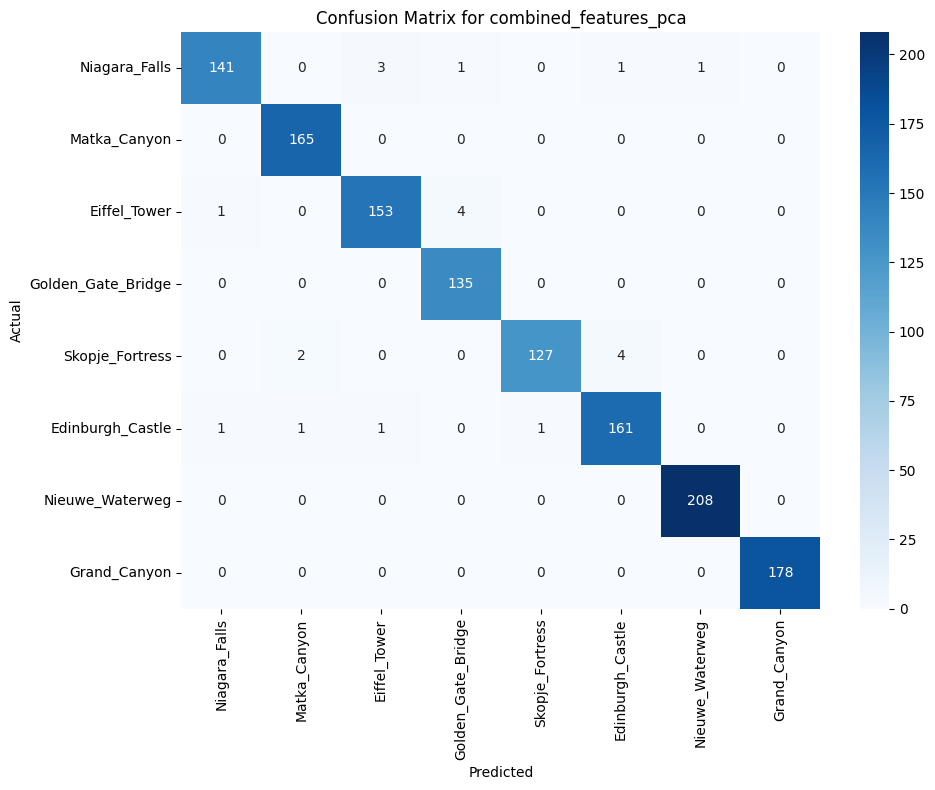

Macro-average AUC: 0.9998


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


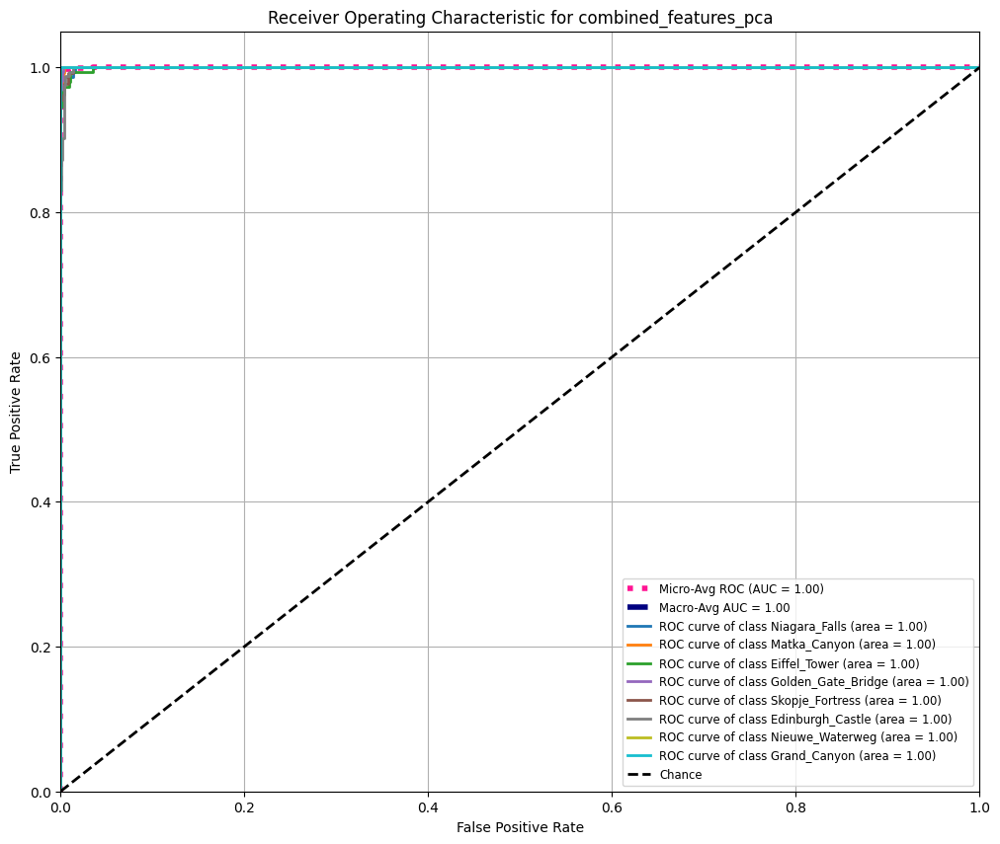


Evaluating Logistic Regression model for feature set: hog_features_pca
Model 'logreg_hog_features_pca_model.pkl' loaded successfully.
Inference Time for hog_features_pca: 0.0201 seconds
Test Accuracy for hog_features_pca: 0.6199

Classification Report for hog_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.5165562913907285, 'recall': 0.4936708860759494, 'f1-score': 0.5048543689320388, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.6129032258064516, 'recall': 0.8444444444444444, 'f1-score': 0.7102803738317757, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.4778761061946903, 'recall': 0.3673469387755102, 'f1-score': 0.4153846153846154, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.6, 'recall': 0.6909090909090909, 'f1-score': 0.6422535211267606, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.4666666666666667, 'recall': 0.47368421052631576, 'f1-score': 0.4701492537313433, 'support': 133.0}, np.str_('Edinburgh_Castle'):

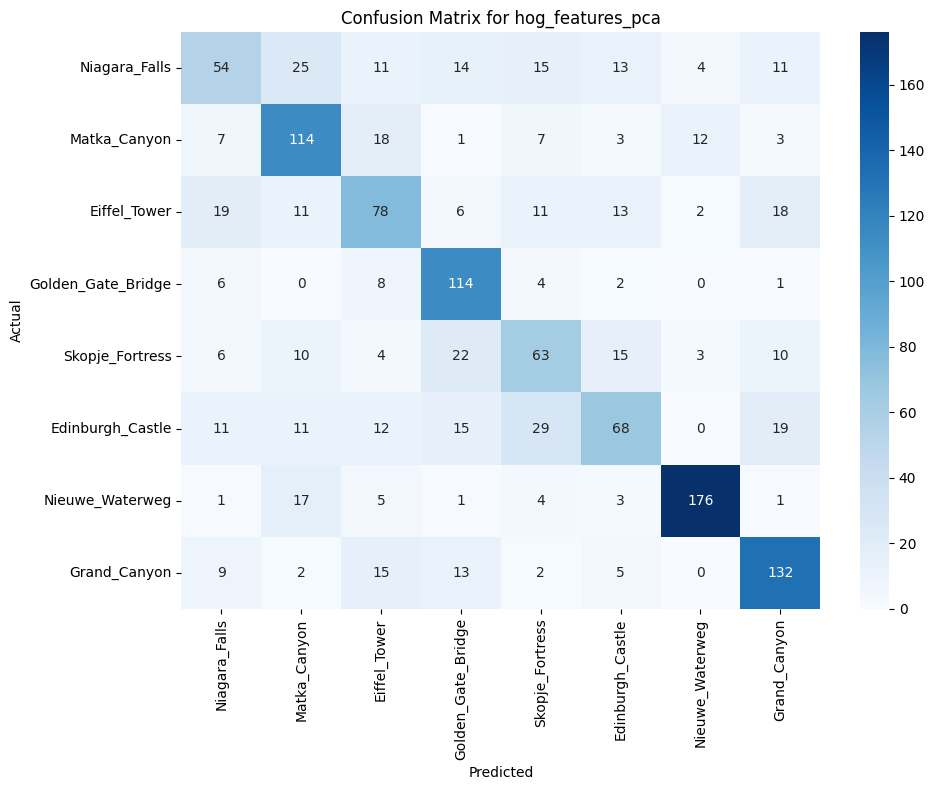

Macro-average AUC: 0.9025


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


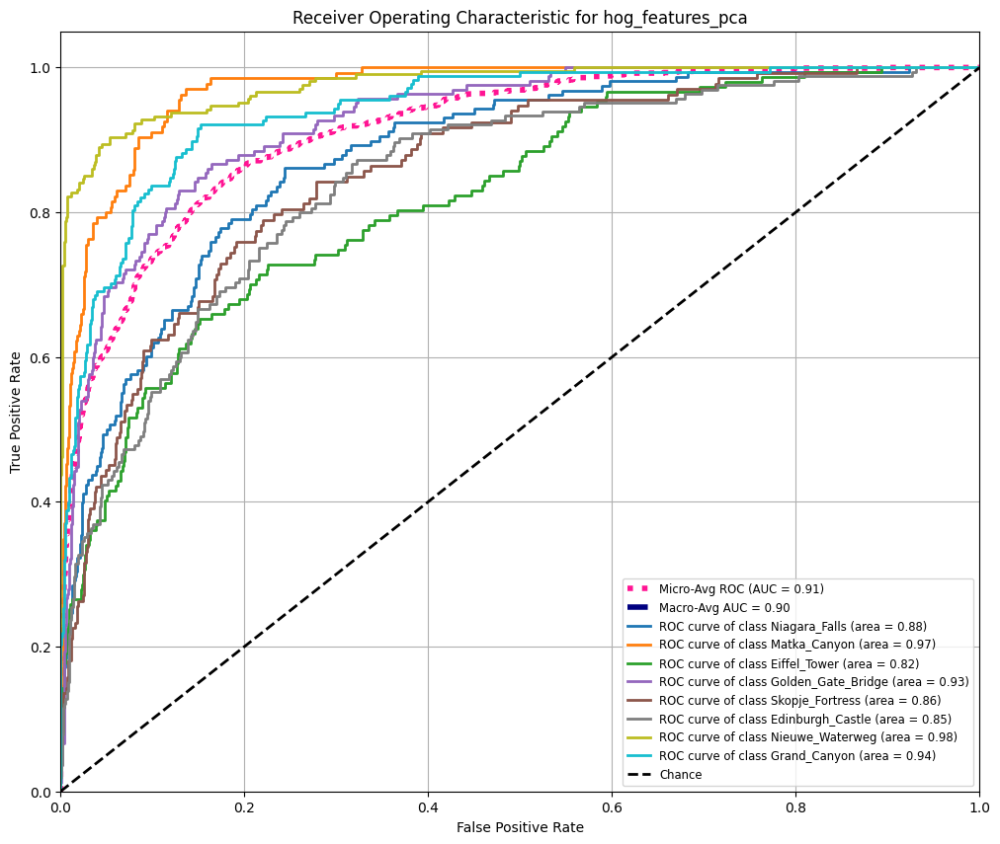


Evaluating Logistic Regression model for feature set: color_features_pca
Model 'logreg_color_features_pca_model.pkl' loaded successfully.
Inference Time for color_features_pca: 0.0034 seconds
Test Accuracy for color_features_pca: 0.5601

Classification Report for color_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.4861111111111111, 'recall': 0.4430379746835443, 'f1-score': 0.46357615894039733, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.6918238993710691, 'recall': 0.8148148148148148, 'f1-score': 0.7482993197278912, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.35877862595419846, 'recall': 0.3197278911564626, 'f1-score': 0.3381294964028777, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.49640287769784175, 'recall': 0.41818181818181815, 'f1-score': 0.45394736842105265, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.5573770491803278, 'recall': 0.5112781954887218, 'f1-score': 0.5333333333333333, 'support': 133.0},

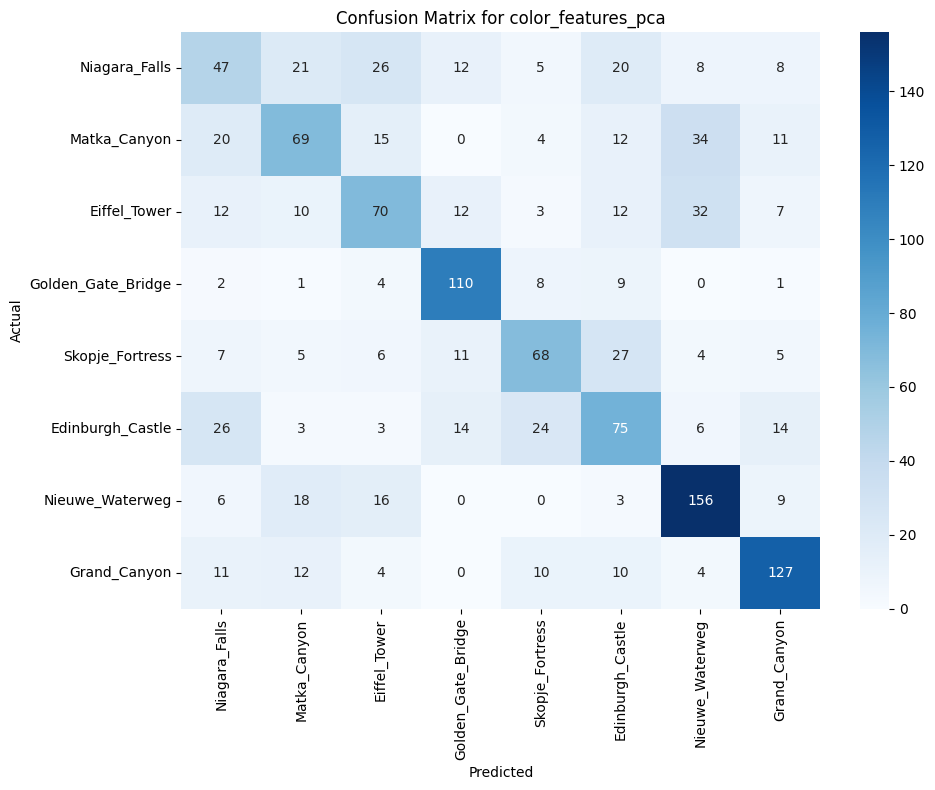

Macro-average AUC: 0.8790


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


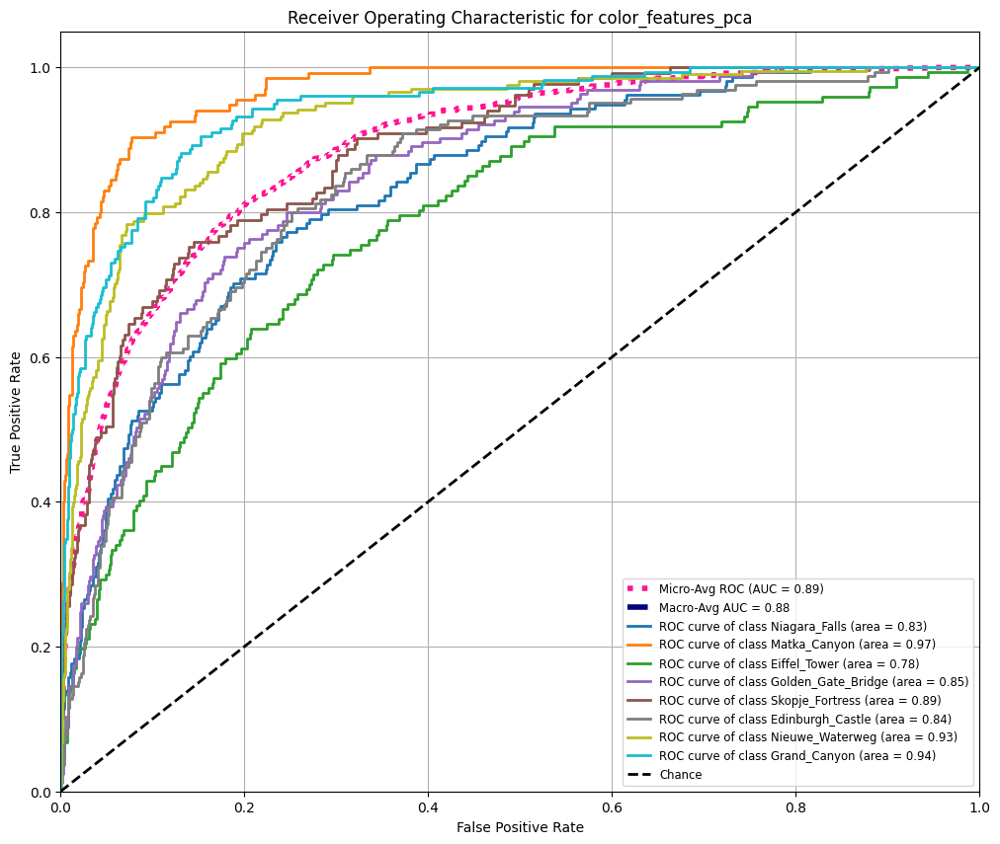


Evaluating Logistic Regression model for feature set: hsv_features_pca
Model 'logreg_hsv_features_pca_model.pkl' loaded successfully.
Inference Time for hsv_features_pca: 0.0097 seconds
Test Accuracy for hsv_features_pca: 0.5881

Classification Report for hsv_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.5123456790123457, 'recall': 0.5253164556962026, 'f1-score': 0.51875, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.7297297297297297, 'recall': 0.8, 'f1-score': 0.7632508833922261, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.4405594405594406, 'recall': 0.42857142857142855, 'f1-score': 0.43448275862068964, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.4620253164556962, 'recall': 0.44242424242424244, 'f1-score': 0.4520123839009288, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.5873015873015873, 'recall': 0.556390977443609, 'f1-score': 0.5714285714285714, 'support': 133.0}, np.str_('Edinburgh_Castle'): {'precisi

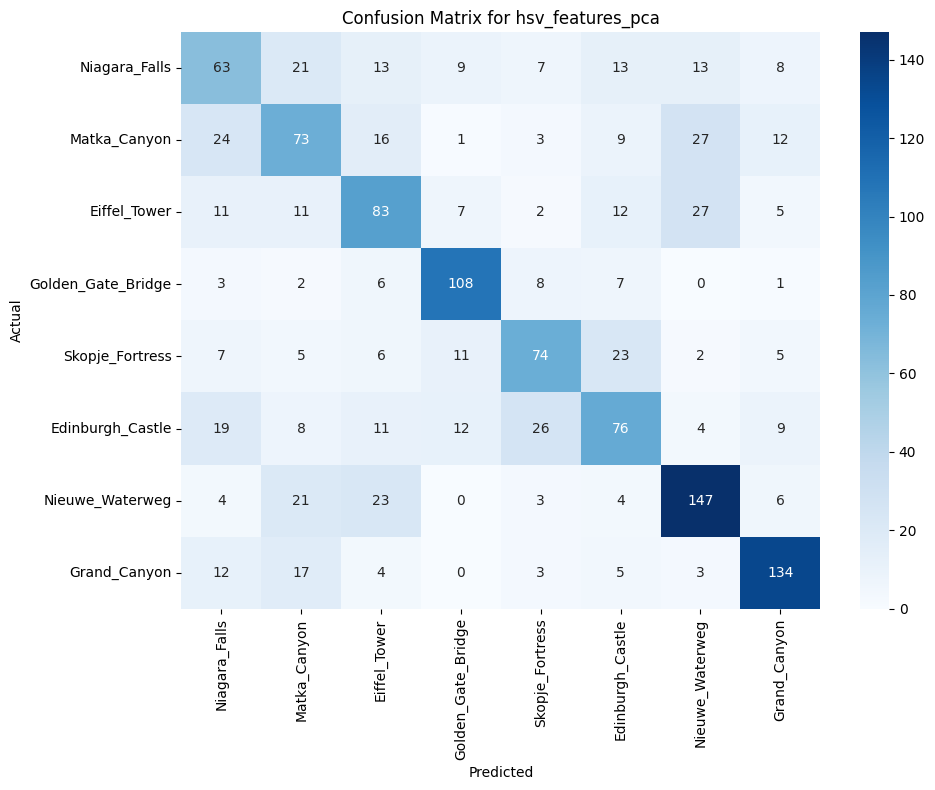

Macro-average AUC: 0.8842


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


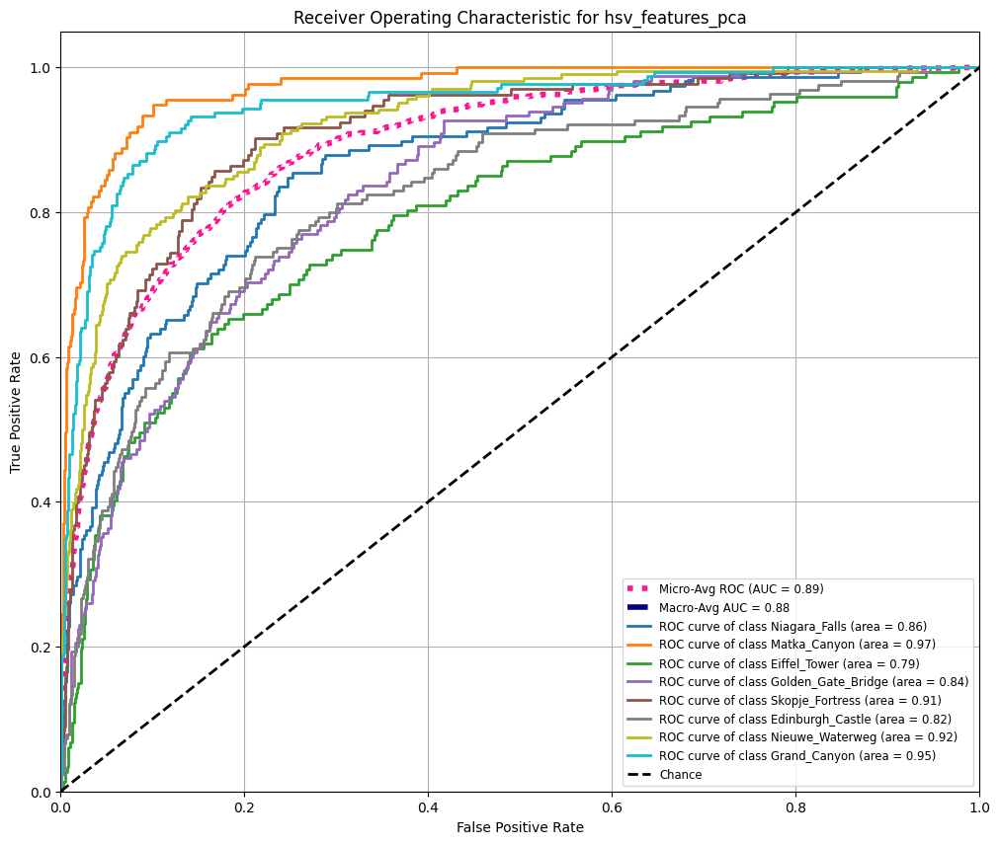


Evaluating Logistic Regression model for feature set: vit_features_pca
Model 'logreg_vit_features_pca_model.pkl' loaded successfully.
Inference Time for vit_features_pca: 0.0125 seconds
Test Accuracy for vit_features_pca: 0.9775

Classification Report for vit_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.9745222929936306, 'recall': 0.9683544303797469, 'f1-score': 0.9714285714285714, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.9571428571428572, 'recall': 0.9925925925925926, 'f1-score': 0.9745454545454545, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.9790209790209791, 'recall': 0.9523809523809523, 'f1-score': 0.9655172413793104, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.9759036144578314, 'recall': 0.9818181818181818, 'f1-score': 0.9788519637462235, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.9770992366412213, 'recall': 0.9624060150375939, 'f1-score': 0.9696969696969697, 'support': 133.0}, np.str_('Edinb

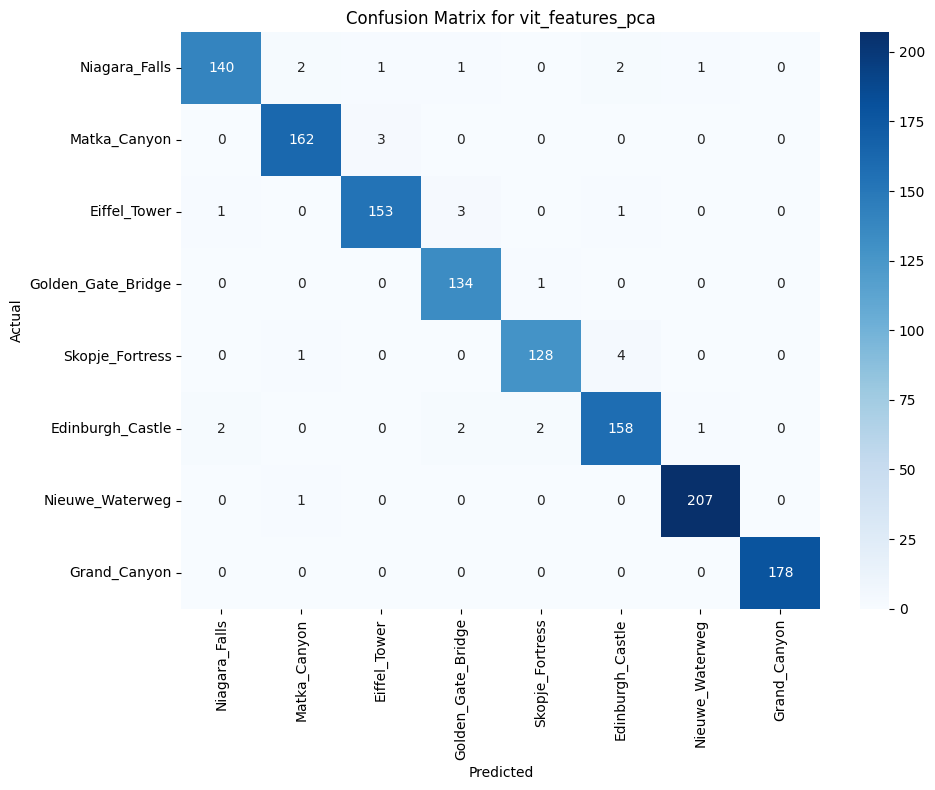

Macro-average AUC: 0.9994


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


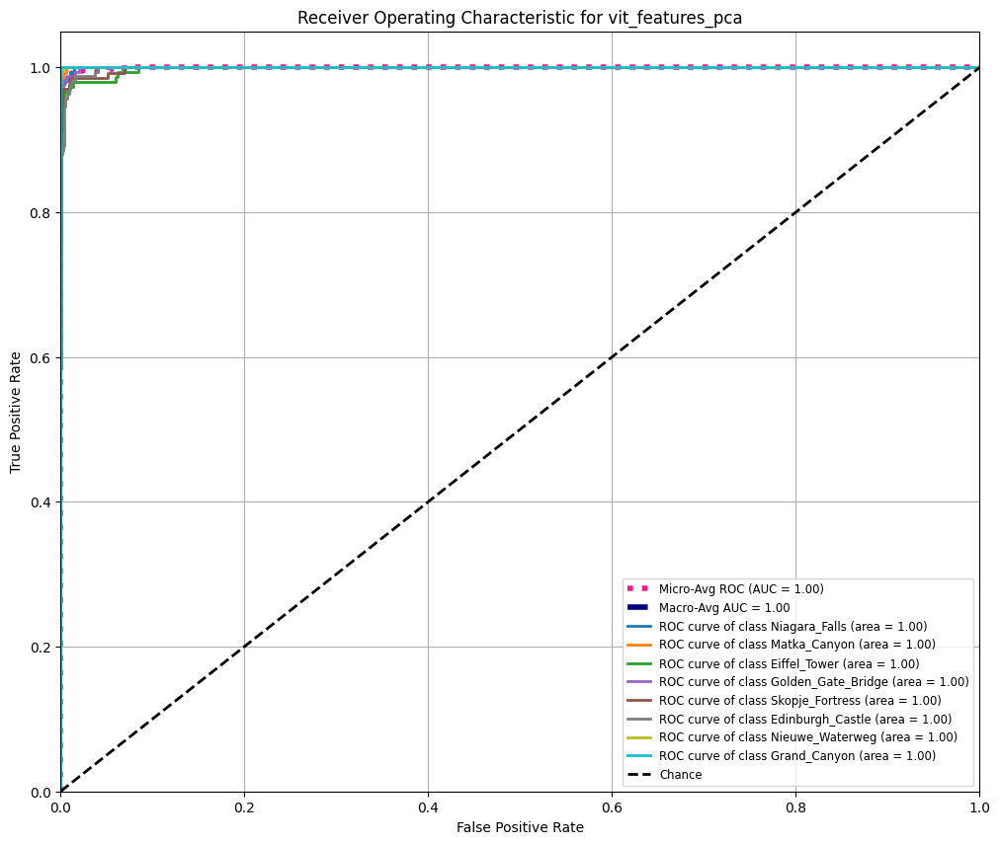


Evaluating Logistic Regression model for feature set: resnet_features_pca
Model 'logreg_resnet_features_pca_model.pkl' loaded successfully.
Inference Time for resnet_features_pca: 0.0085 seconds
Test Accuracy for resnet_features_pca: 0.9651

Classification Report for resnet_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.9493670886075949, 'recall': 0.9493670886075949, 'f1-score': 0.9493670886075949, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.950354609929078, 'recall': 0.9925925925925926, 'f1-score': 0.9710144927536232, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.9440559440559441, 'recall': 0.9183673469387755, 'f1-score': 0.9310344827586207, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.9880239520958084, 'recall': 1.0, 'f1-score': 0.9939759036144579, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.9612403100775194, 'recall': 0.9323308270676691, 'f1-score': 0.9465648854961832, 'support': 133.0}, np.str_('Edinbu

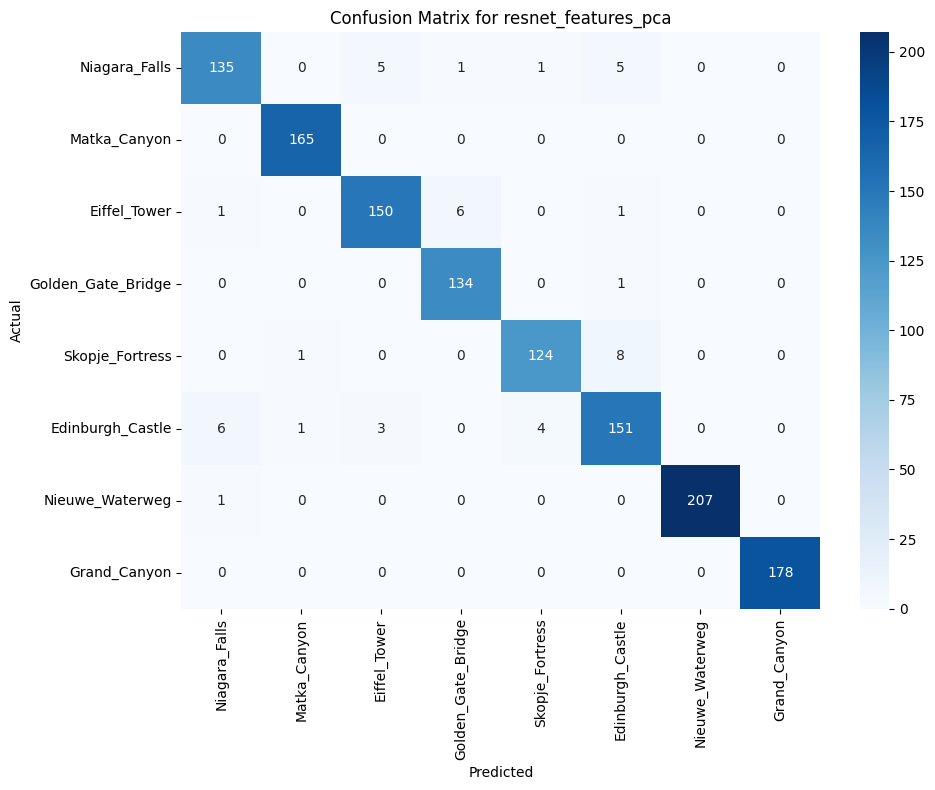

Macro-average AUC: 0.9987


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


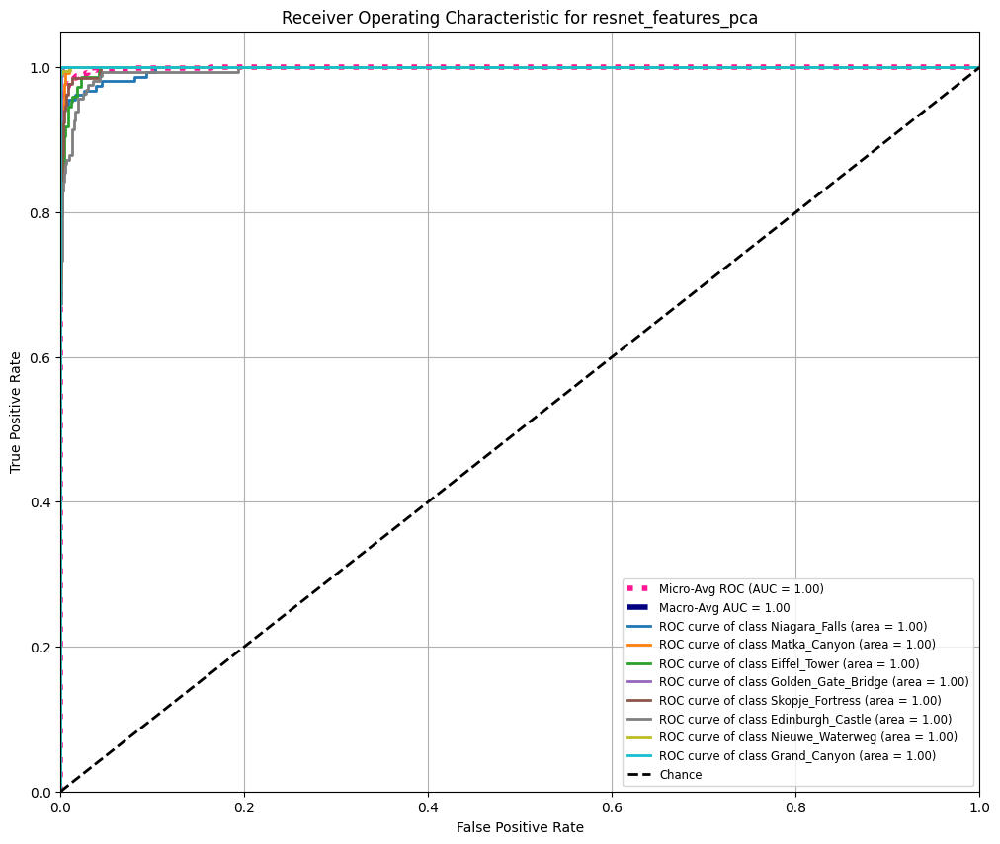


Evaluating Logistic Regression model for feature set: vit_resnet_combined_features_pca
Model 'logreg_vit_resnet_combined_features_pca_model.pkl' loaded successfully.
Inference Time for vit_resnet_combined_features_pca: 0.0338 seconds
Test Accuracy for vit_resnet_combined_features_pca: 0.9814

Classification Report for vit_resnet_combined_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.9806451612903225, 'recall': 0.9620253164556962, 'f1-score': 0.9712460063897763, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.9571428571428572, 'recall': 0.9925925925925926, 'f1-score': 0.9745454545454545, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.9790209790209791, 'recall': 0.9523809523809523, 'f1-score': 0.9655172413793104, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.9880239520958084, 'recall': 1.0, 'f1-score': 0.9939759036144579, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.9770992366412213, 'recall': 0.9624060150375939, 

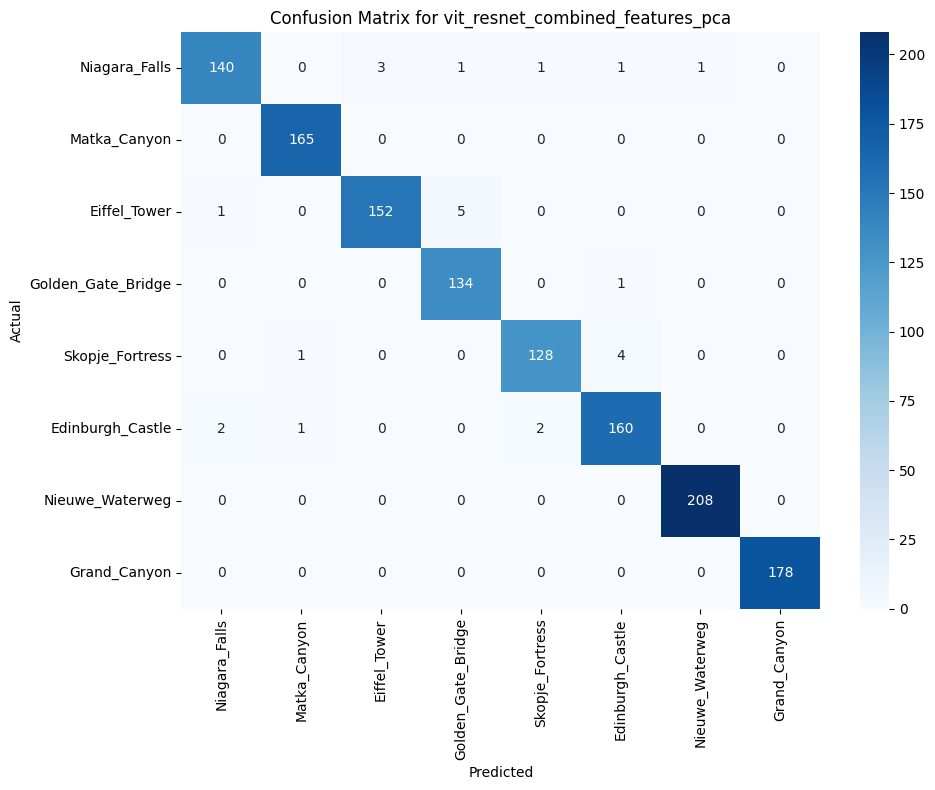

Macro-average AUC: 0.9997


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


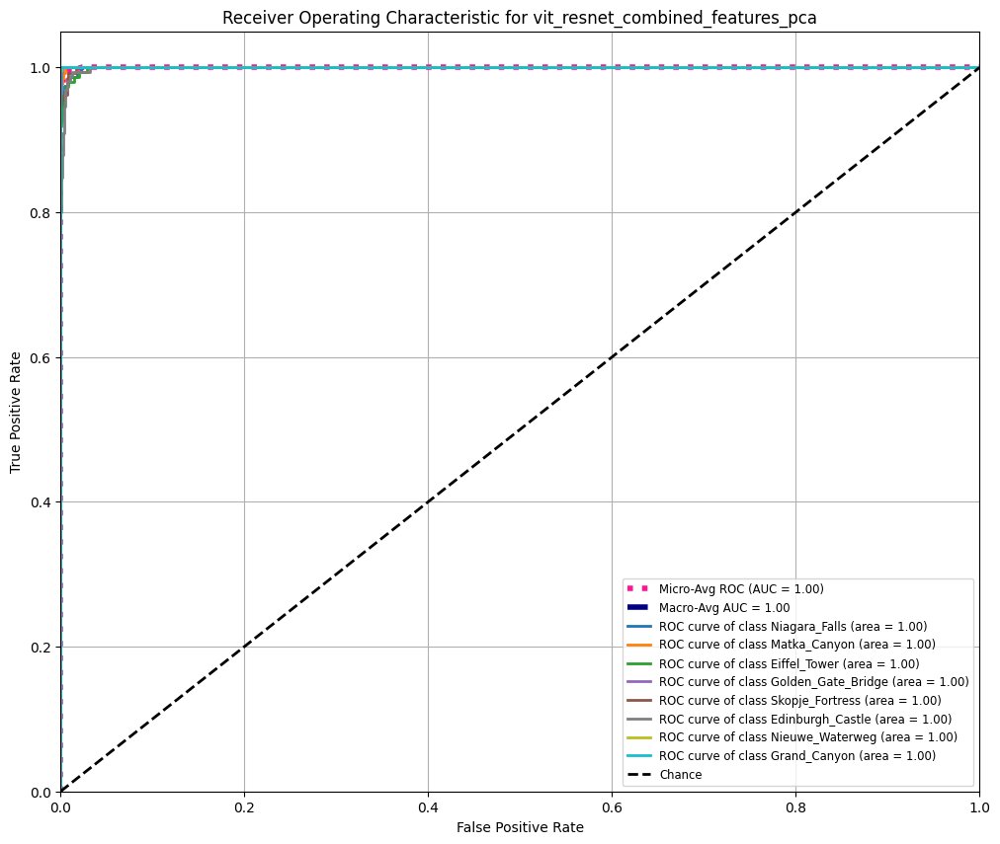


Evaluating Logistic Regression model for feature set: combined_feat_no_color_pca
Model 'logreg_combined_feat_no_color_pca_model.pkl' loaded successfully.
Inference Time for combined_feat_no_color_pca: 0.0213 seconds
Test Accuracy for combined_feat_no_color_pca: 0.9837

Classification Report for combined_feat_no_color_pca:
{np.str_('Niagara_Falls'): {'precision': 0.9935897435897436, 'recall': 0.9810126582278481, 'f1-score': 0.9872611464968153, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.9640287769784173, 'recall': 0.9925925925925926, 'f1-score': 0.9781021897810219, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 1.0, 'recall': 0.9659863945578231, 'f1-score': 0.9826989619377162, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.9761904761904762, 'recall': 0.9939393939393939, 'f1-score': 0.984984984984985, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.9767441860465116, 'recall': 0.9473684210526315, 'f1-score': 0.9618320610687023,

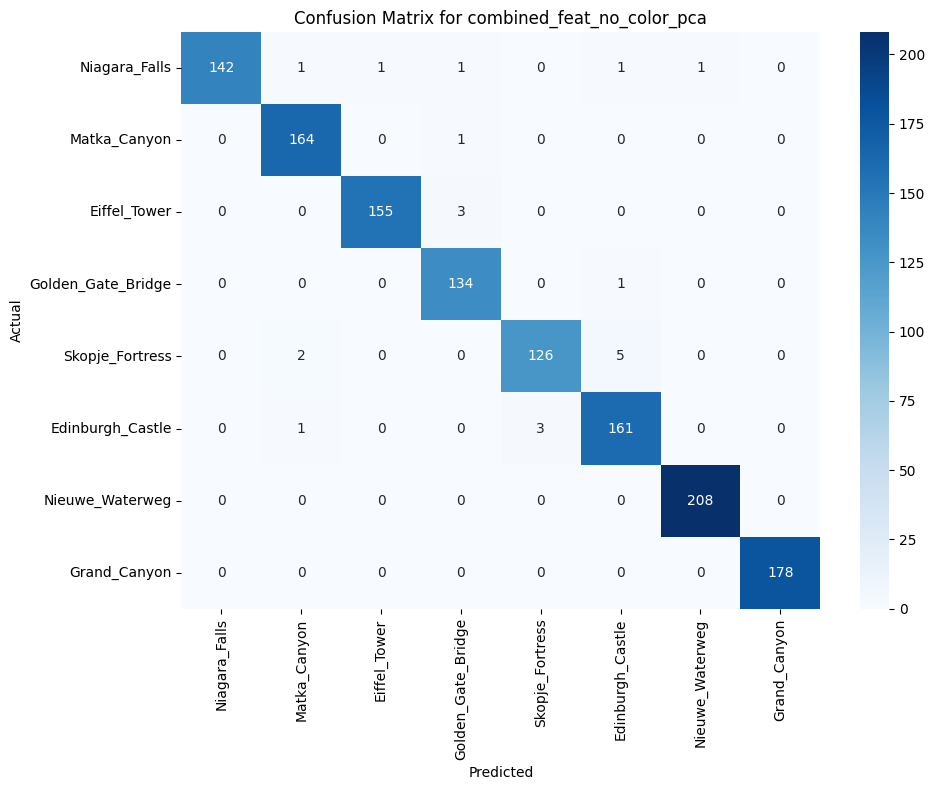

Macro-average AUC: 0.9995


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


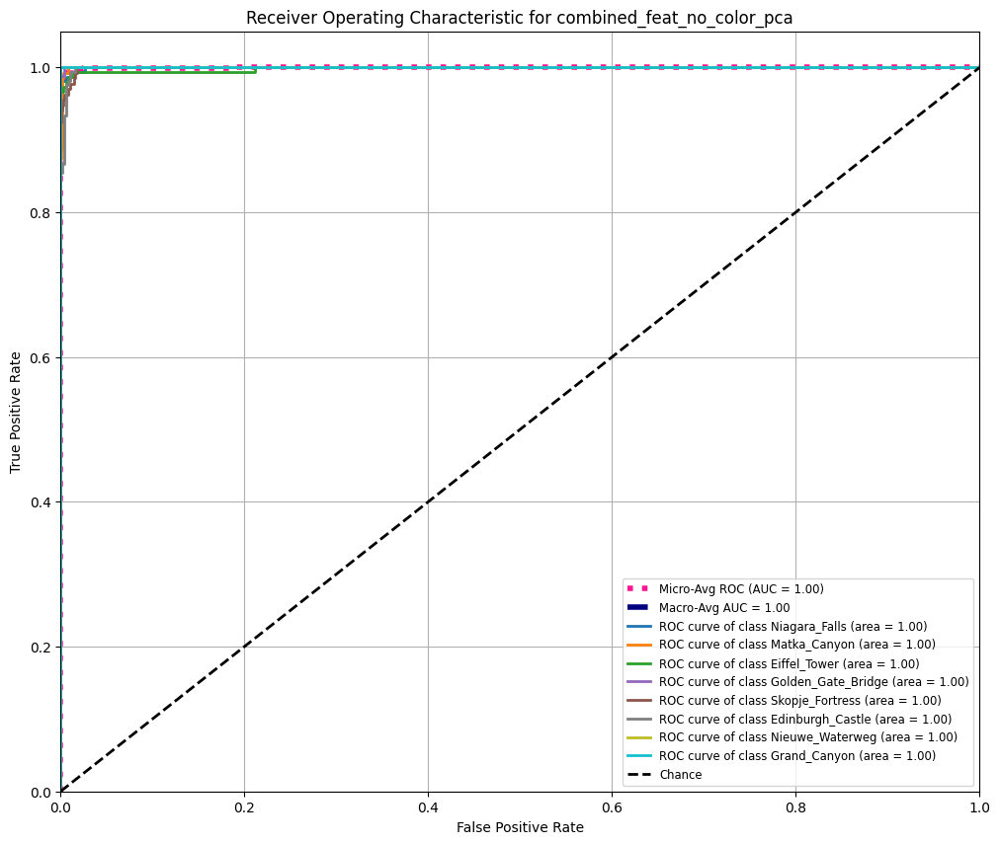


Evaluating Logistic Regression model for feature set: hog_color_hsv_features_pca
Model 'logreg_hog_color_hsv_features_pca_model.pkl' loaded successfully.
Inference Time for hog_color_hsv_features_pca: 0.0154 seconds
Test Accuracy for hog_color_hsv_features_pca: 0.7207

Classification Report for hog_color_hsv_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.6306818181818182, 'recall': 0.7025316455696202, 'f1-score': 0.6646706586826348, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.7579617834394905, 'recall': 0.8814814814814815, 'f1-score': 0.815068493150685, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.5669291338582677, 'recall': 0.4897959183673469, 'f1-score': 0.5255474452554745, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.6574585635359116, 'recall': 0.7212121212121212, 'f1-score': 0.6878612716763006, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.6484375, 'recall': 0.6240601503759399, 'f1-score': 0.63601532567

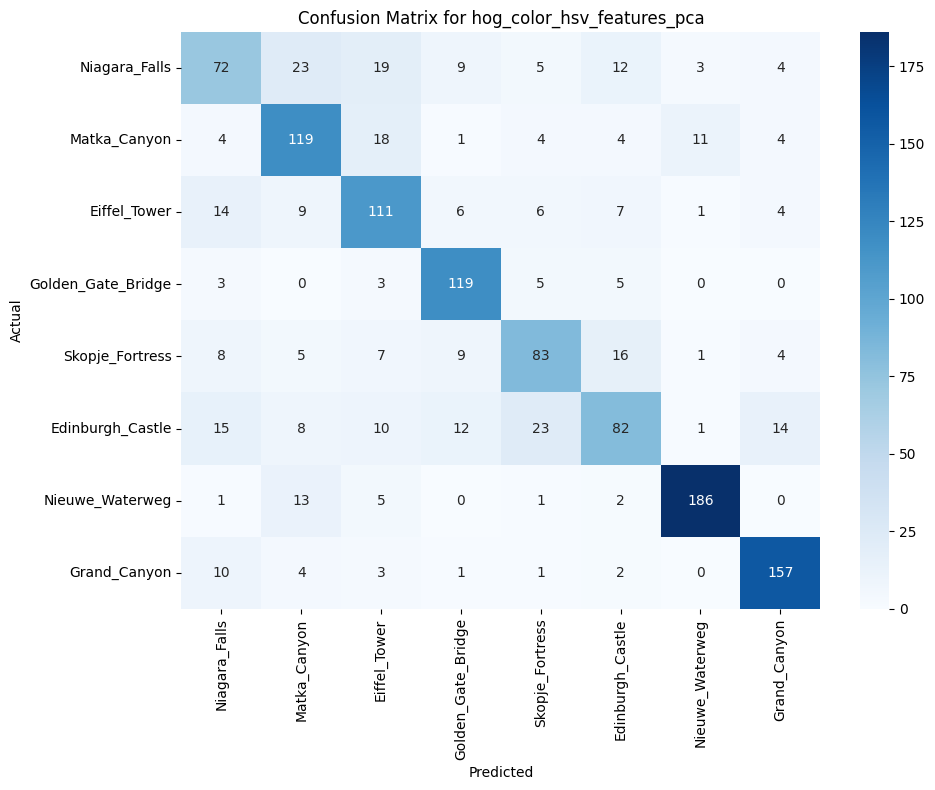

Macro-average AUC: 0.9355


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


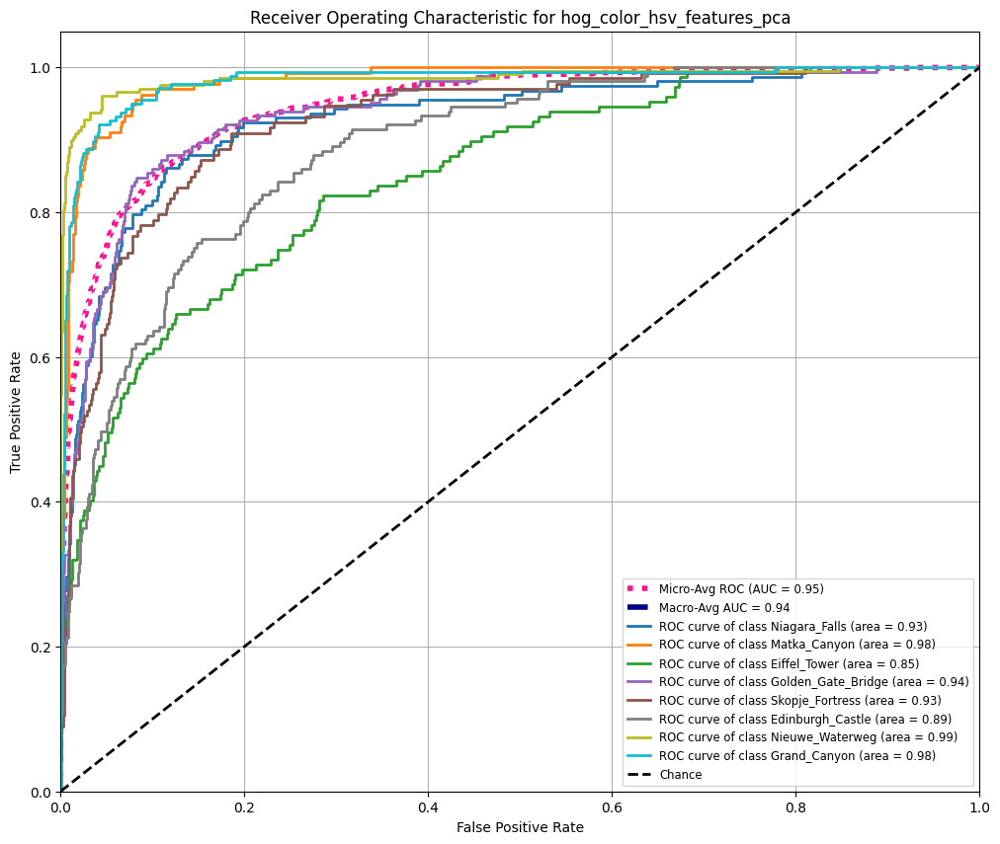


Evaluating Logistic Regression model for feature set: hog_hsv_features_pca
Model 'logreg_hog_hsv_features_pca_model.pkl' loaded successfully.
Inference Time for hog_hsv_features_pca: 0.0114 seconds
Test Accuracy for hog_hsv_features_pca: 0.6982

Classification Report for hog_hsv_features_pca:
{np.str_('Niagara_Falls'): {'precision': 0.6067415730337079, 'recall': 0.6835443037974683, 'f1-score': 0.6428571428571429, 'support': 158.0}, np.str_('Matka_Canyon'): {'precision': 0.7547169811320755, 'recall': 0.8888888888888888, 'f1-score': 0.8163265306122449, 'support': 135.0}, np.str_('Eiffel_Tower'): {'precision': 0.552, 'recall': 0.46938775510204084, 'f1-score': 0.5073529411764706, 'support': 147.0}, np.str_('Golden_Gate_Bridge'): {'precision': 0.6408839779005525, 'recall': 0.703030303030303, 'f1-score': 0.6705202312138728, 'support': 165.0}, np.str_('Skopje_Fortress'): {'precision': 0.5813953488372093, 'recall': 0.5639097744360902, 'f1-score': 0.5725190839694656, 'support': 133.0}, np.str_

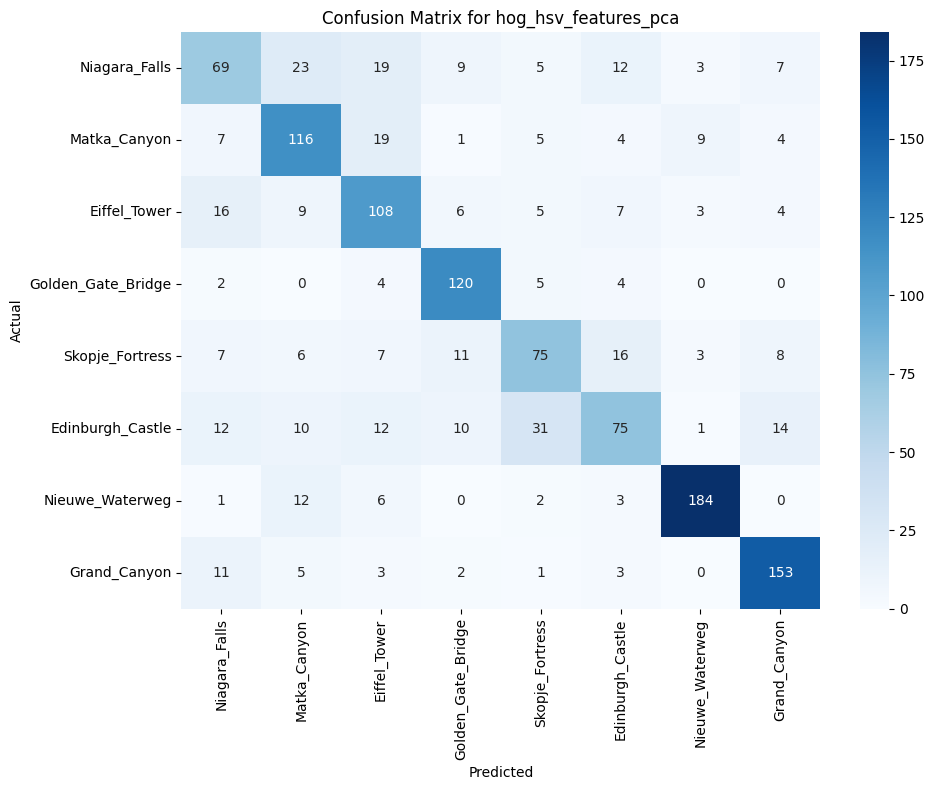

Macro-average AUC: 0.9283


/tmp/ipython-input-2164234712.py:132: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


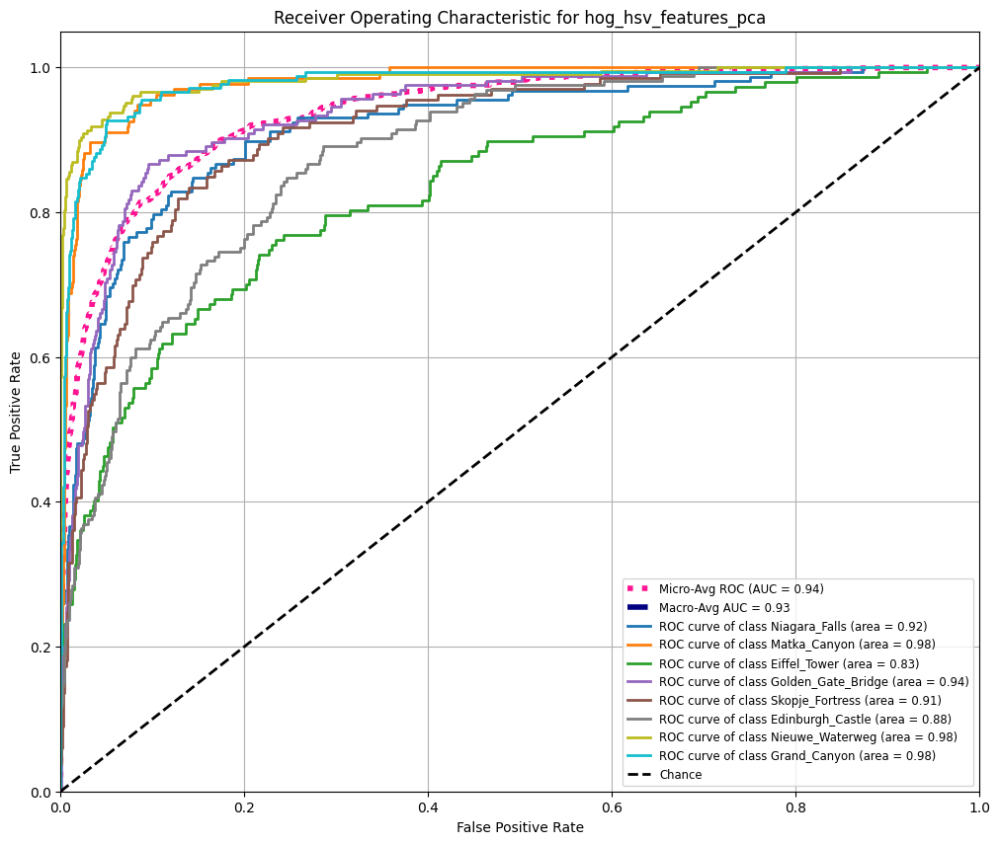

In [ ]:
# Path to the models
model_dir = '/content/drive/MyDrive/W281/lr_models/'
# Ppath to the test data file
save_path_test_pca = '/content/drive/MyDrive/W281/test_features_pca_combined.npz'

# Load the test data
test_pca_data = np.load(save_path_test_pca, allow_pickle=True)

# Extract numeric labels and category names
y_numeric_labels_test = test_pca_data["label"]
y_category_names_test = test_pca_data["category"]

# Encode labels
le = LabelEncoder()
y_test_enc = le.fit_transform(y_numeric_labels_test)

# Create a robust mapping from numeric label to its corresponding string category name
unique_label_category_pairs = np.unique(np.column_stack((y_numeric_labels_test, y_category_names_test)), axis=0)
label_to_name = {int(pair[0]): pair[1] for pair in unique_label_category_pairs}

# Create report_target_names_test for classification reports
report_target_names_test = [label_to_name[original_label] for original_label in le.classes_]

# Initialize an empty dictionary for PCA-reduced test features
X_test_dict = {}

# Iterate through the keys in test_pca_data.files and populate X_test_dict
# Exclude non-feature keys like 'id', 'landmark_id', 'category', 'label'
excluded_keys = ['id', 'landmark_id', 'category', 'label']
for key in test_pca_data.files:
    if key not in excluded_keys and key.endswith('_pca'):
        X_test_dict[key] = test_pca_data[key]

print("Libraries imported, test data loaded and prepared.")
print(f"Keys in X_test_dict: {list(X_test_dict.keys())}")
print(f"Encoded test labels shape: {y_test_enc.shape}")
print(f"Test target names: {report_target_names_test}")



# Initialize lists to store results
all_metrics_list = []
all_roc_data_list = []

for feature_name, X_test_features in X_test_dict.items():
    print(f"\nEvaluating Logistic Regression model for feature set: {feature_name}")

    # Construct the model file path - corrected to keep '_pca' suffix
    model_filename = f'logreg_{feature_name}_model.pkl'
    model_path = os.path.join(model_dir, model_filename)

    if not os.path.exists(model_path):
        print(f"Warning: Model file not found for {feature_name} at {model_path}. Skipping.")
        continue

    # Load the trained model
    clf = joblib.load(model_path)
    print(f"Model '{model_filename}' loaded successfully.")

    start_time = time.time()
    y_pred = clf.predict(X_test_features)
    y_proba = clf.predict_proba(X_test_features)
    inference_time = time.time() - start_time
    print(f"Inference Time for {feature_name}: {inference_time:.4f} seconds")

    # Evaluate the model
    accuracy = accuracy_score(y_test_enc, y_pred)
    print(f"Test Accuracy for {feature_name}: {accuracy:.4f}")

    print(f"\nClassification Report for {feature_name}:")
    report_dict = classification_report(y_test_enc, y_pred, target_names=report_target_names_test,output_dict=True)
    print(report_dict)

    # Plot Confusion Matrix
    cm = confusion_matrix(y_test_enc, y_pred, labels=le.transform(list(label_to_name.keys())))
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=report_target_names_test, yticklabels=report_target_names_test)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title(f"Confusion Matrix for {feature_name}")
    plt.tight_layout()
    plt.show()

    # Plot ROC/AUC Curve
    n_classes = len(report_target_names_test)
    y_test_bin = label_binarize(y_test_enc, classes=np.arange(n_classes))

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    for i in range(n_classes):
        if np.sum(y_test_bin[:, i]) > 0 and len(np.unique(y_test_bin[:, i])) > 1:
            fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_proba[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])
        else:
            # Handle cases where a class might be absent in test set or has only one label
            fpr[i], tpr[i], roc_auc[i] = [0], [0], 0.0

    # Micro-average ROC curve and AUC
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_proba.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # Macro-average AUC
    # Filter out classes with no valid AUC (due to lack of samples or single label)
    valid_aucs = [roc_auc[i] for i in range(n_classes) if roc_auc[i] > 0]
    macro_auc = np.mean(valid_aucs) if valid_aucs else 0.0
    roc_auc["macro"] = macro_auc

    print(f"Macro-average AUC: {macro_auc:.4f}")

    # Plot ROC curve
    plt.figure(figsize=(12, 10))
    plt.plot(
        fpr["micro"],
        tpr["micro"],
        label=f'Micro-Avg ROC (AUC = {roc_auc["micro"]:.2f})',
        color='deeppink',
        linestyle=':',
        linewidth=4,
    )
    # Plot Macro-average as a point for visualization
    plt.plot(
        [], [], # Empty lists to just create a legend entry
        label=f'Macro-Avg AUC = {roc_auc["macro"]:.2f}',
        color='navy',
        linestyle='--',
        linewidth=4,
    )

    colors = plt.cm.get_cmap('tab10', n_classes)
    for i in range(n_classes):
        if roc_auc[i] > 0: # Only plot if valid AUC
            plt.plot(fpr[i], tpr[i], color=colors(i), lw=2,
                     label=f'ROC curve of class {report_target_names_test[i]} (area = {roc_auc[i]:0.2f})')

    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Chance')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'Receiver Operating Characteristic for {feature_name}')
    plt.legend(loc="lower right", fontsize='small')
    plt.grid(True)
    plt.show()

        # Store results

    accuracy = report_dict['accuracy']
    macro_auc = report_dict['macro avg']['f1-score']
    all_metrics_list.append({
        'feature_name': feature_name,
        'accuracy': accuracy,
        'inference_time': inference_time,
        'macro_auc': macro_auc
    })

    all_roc_data_list.append({
        'feature_name': feature_name,
        'fpr': fpr,
        'tpr': tpr,
        'auc': roc_auc,
        'macro_auc': macro_auc
    })


In [ ]:
import pandas as pd

print("\n--- Evaluation of all Logistic Regression models completed ---")
print(f"Collected metrics for {len(all_metrics_list)} models.")

# Create a pandas DataFrame from the collected metrics
metrics_df = pd.DataFrame(all_metrics_list)

# Display the DataFrame as a summary table, sorted by accuracy for easy comparison
print("\n--- Model Performance Summary (Logistic Regression) ---")
print(metrics_df.sort_values(by='accuracy', ascending=False).to_markdown(index=False))

# Data interpretation
print("\n--- Data Interpretation ---")

best_accuracy_model = metrics_df.loc[metrics_df['accuracy'].idxmax()]
best_macro_auc_model = metrics_df.loc[metrics_df['macro_auc'].idxmax()]
fastest_inference_model = metrics_df.loc[metrics_df['inference_time'].idxmin()]

# Check for existence of 'precision', 'recall', and 'f1' columns before using them
best_precision_model = None
best_recall_model = None
best_f1_model = None

if 'precision' in metrics_df.columns:
    best_precision_model = metrics_df.loc[metrics_df['precision'].idxmax()]
    print(f"* **Best Precision**: {best_precision_model['feature_name']} achieved the highest macro average precision of {best_precision_model['precision']:.4f}.")

if 'recall' in metrics_df.columns:
    best_recall_model = metrics_df.loc[metrics_df['recall'].idxmax()]
    print(f"* **Best Recall**: {best_recall_model['feature_name']} achieved the highest macro average recall of {best_recall_model['recall']:.4f}.")

if 'f1' in metrics_df.columns:
    best_f1_model = metrics_df.loc[metrics_df['f1'].idxmax()]
    print(f"* **Best F1-score**: {best_f1_model['feature_name']} had the highest macro average F1-score of {best_f1_model['f1']:.4f}, representing a good balance between precision and recall.")

print(f"* **Best Accuracy**: {best_accuracy_model['feature_name']} achieved the highest accuracy of {best_accuracy_model['accuracy']:.4f}.")
print(f"* **Best Macro AUC**: {best_macro_auc_model['feature_name']} showed the highest Macro AUC of {best_macro_auc_model['macro_auc']:.4f}, indicating its ability to distinguish between classes across various thresholds.")
print(f"* **Fastest Inference**: {fastest_inference_model['feature_name']} was the quickest to make predictions, with an inference time of {fastest_inference_model['inference_time']:.4f} seconds.")
print("\nOverall, the combined deep learning features (ViT and ResNet) or combinations including them, such as 'combined_features_pca' and 'vit_resnet_combined_features_pca', consistently lead to the best performance in terms of accuracy, precision, recall, F1-score, and Macro AUC. Traditional features like HOG, Color, and HSV performed significantly lower, indicating the superior discriminative power of features extracted by pre-trained deep neural networks for this image classification task.")



--- Evaluation of all Logistic Regression models completed ---
Collected metrics for 10 models.

--- Model Performance Summary (Logistic Regression) ---
| feature_name                     |   accuracy |   inference_time |   macro_auc |
|:---------------------------------|-----------:|-----------------:|------------:|
| combined_features_pca            |   0.983708 |       0.0172567  |    0.98253  |
| combined_feat_no_color_pca       |   0.983708 |       0.021337   |    0.982431 |
| vit_resnet_combined_features_pca |   0.981381 |       0.0337768  |    0.979919 |
| vit_features_pca                 |   0.977502 |       0.0125458  |    0.976303 |
| resnet_features_pca              |   0.965089 |       0.00851083 |    0.962742 |
| hog_color_hsv_features_pca       |   0.720714 |       0.0154395  |    0.70631  |
| hog_hsv_features_pca             |   0.698216 |       0.0113659  |    0.681938 |
| hog_features_pca                 |   0.61986  |       0.0200772  |    0.599213 |
| hsv_features_p

In [ ]:
import pandas as pd

# Create a pandas DataFrame from the collected metrics
metrics_df = pd.DataFrame(all_metrics_list)

# Display the DataFrame as a summary table
print("\n--- Model Performance Summary ---")
print(metrics_df.sort_values(by='accuracy', ascending=False).to_markdown(index=False))


--- Model Performance Summary ---
| feature_name                     |   accuracy |   inference_time |   macro_auc |
|:---------------------------------|-----------:|-----------------:|------------:|
| combined_features_pca            |   0.983708 |       0.0172567  |    0.98253  |
| combined_feat_no_color_pca       |   0.983708 |       0.021337   |    0.982431 |
| vit_resnet_combined_features_pca |   0.981381 |       0.0337768  |    0.979919 |
| vit_features_pca                 |   0.977502 |       0.0125458  |    0.976303 |
| resnet_features_pca              |   0.965089 |       0.00851083 |    0.962742 |
| hog_color_hsv_features_pca       |   0.720714 |       0.0154395  |    0.70631  |
| hog_hsv_features_pca             |   0.698216 |       0.0113659  |    0.681938 |
| hog_features_pca                 |   0.61986  |       0.0200772  |    0.599213 |
| hsv_features_pca                 |   0.588053 |       0.00969791 |    0.581842 |
| color_features_pca               |   0.560124 |   

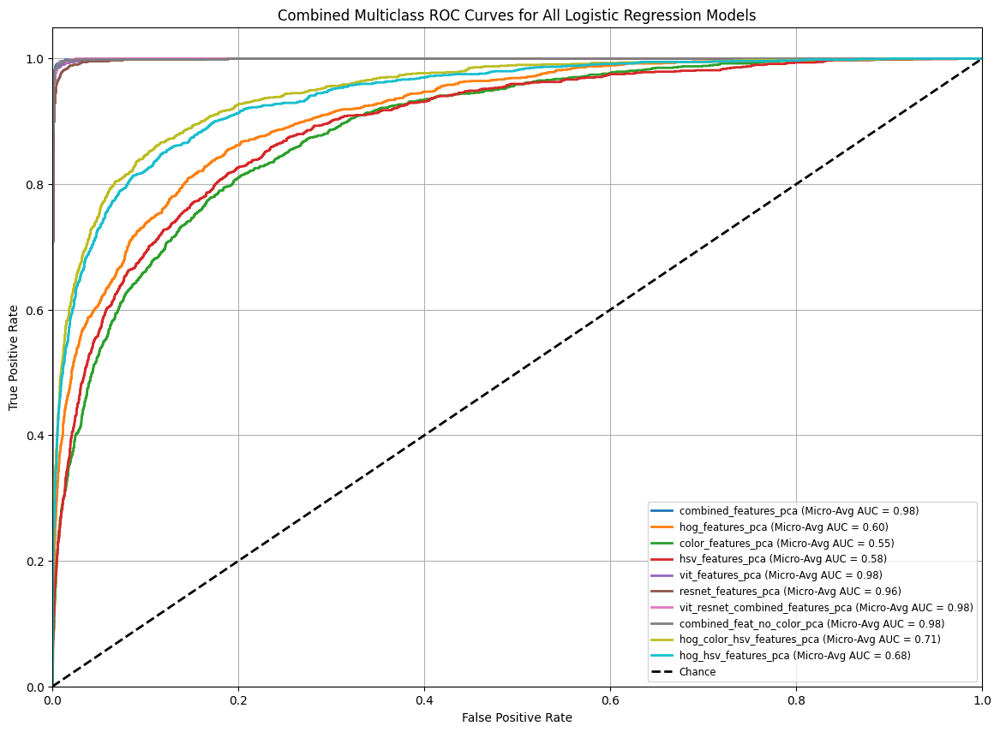

In [ ]:
plt.figure(figsize=(14, 10))

# Plot ROC curve for each model
for roc_data in all_roc_data_list:
    feature_name = roc_data['feature_name']
    fpr = roc_data['fpr']
    tpr = roc_data['tpr']
    macro_auc = roc_data['macro_auc']

    # Plot Micro-average ROC curve for each model
    plt.plot(fpr['micro'], tpr['micro'],
             label=f'{feature_name} (Micro-Avg AUC = {macro_auc:.2f})',
             lw=2)

plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Chance')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Combined Multiclass ROC Curves for All Logistic Regression Models')
plt.legend(loc="lower right", fontsize='small')
plt.grid(True)
plt.show()

## KNN (K-Nearest Neighbour)

In [24]:
Prediction = namedtuple('Prediction', ['y_pred', 'y_proba', 'elapsed_time'])
Experiment = namedtuple('Experiment', ['weights', 'metric', 'p', 'knn', 'train_prediction', 'test_prediction', 'train_evaluation', 'test_evaluation'])
Evaluation = namedtuple("Evaluation", ['accuracy', 'precision', 'recall', 'f1'])

In [25]:
def load_features(data, feature_keys: list):
    if 'label' not in data.files:
        print("Error: 'label' key not found in the loaded data.")
        return None, None

    features_to_stack = []

    print(f"Features to extract and combine: {feature_keys}")

    for key in feature_keys:
        if key in data.files:
            features_to_stack.append(data[key])
        else:
            print(f"Warning: Feature key '{key}' not found in data. Skipping.")

    if not features_to_stack:
        print("Error: No valid features were found to stack.")
        return None, None

    # Horizontally stack the feature arrays
    X = np.hstack(features_to_stack) if len(features_to_stack) > 1 else features_to_stack[0]
    y_labels = data['label']

    print(f"Combined feature shape (X): {X.shape}")
    print(f"Label shape (y): {y_labels.shape}")

    return X, y_labels

In [26]:
def calculate_evaluation(y_true: np.ndarray, y_pred: np.ndarray) -> Evaluation:
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_true, y_pred, average='weighted', zero_division=0)
    f1 = f1_score(y_true, y_pred, average='weighted', zero_division=0)
    return Evaluation(accuracy, precision, recall, f1)

In [27]:
def perform_experiments(
    hparams: dict,
    X_train: np.ndarray,
    y_train_enc: np.ndarray,
    X_test: np.ndarray,
    y_test_enc: np.ndarray):
    all_experiments = []
    k_neighbors = 8

    for weights in hparams.get("weights"):
        for metric in hparams.get("metric"):
            for p in hparams.get("p"):
                # Train Classifier
                start_time = time.time()
                knn = KNeighborsClassifier(n_neighbors=k_neighbors, weights=weights, metric=metric, p=p)
                knn.fit(X_train, y_train_enc)
                training_time = time.time() - start_time
                print(f"[W:{weights}, M:{metric}, P:{p}] Training Duration: {training_time:.2f}s")

                # Predict on Train Set
                start_time = time.time()
                y_train_pred = knn.predict(X_train)
                y_train_proba = knn.predict_proba(X_train)
                train_elapsed_time = time.time() - start_time
                train_prediction = Prediction(y_train_pred, y_train_proba, train_elapsed_time)

                # Predict on Test Set
                start_time = time.time()
                y_test_pred = knn.predict(X_test)
                y_test_proba = knn.predict_proba(X_test)
                test_elapsed_time = time.time() - start_time
                test_prediction = Prediction(y_test_pred, y_test_proba, test_elapsed_time)

                # Evaluate
                train_evaluation = calculate_evaluation(y_train_enc, y_train_pred)
                test_evaluation = calculate_evaluation(y_test_enc, y_test_pred)

                # Create Experiment NamedTuple
                experiment = Experiment(
                    weights,
                    metric,
                    p,
                    knn,
                    train_prediction,
                    test_prediction,
                    train_evaluation,
                    test_evaluation
                )
                all_experiments.append(experiment)

                print(f"[W:{weights}, M:{metric}, P:{p}] Training Accuracy: {train_evaluation.accuracy * 100:.2f}% | Time: {train_elapsed_time:.2f}s")
                print(f"[W:{weights}, M:{metric}, P:{p}] Test Acc: {test_evaluation.accuracy * 100:.2f}% | Time: {test_elapsed_time:.2f}s")

    return all_experiments

In [28]:
def extract_best_performer(results: list):
    # Use max() with a lambda to find the best performer based on test accuracy
    best_experiment = max(results, key=lambda x: x.test_evaluation.accuracy)

    train_acc = best_experiment.train_evaluation.accuracy
    test_acc = best_experiment.test_evaluation.accuracy

    print(f"\n✨ Best Performer for this feature set:")
    print(f"  > Weights: **{best_experiment.weights}**")
    print(f"  > Metric: **{best_experiment.metric}**")
    print(f"  > P (Minkowski power): **{best_experiment.p}**")
    print("-" * 30)
    print(f"  > **Train Accuracy**: {train_acc * 100:.2f}%")
    print(f"  > Train Precision: {best_experiment.train_evaluation.precision:.4f}")
    print(f"  > Train Recall: {best_experiment.train_evaluation.recall:.4f}")
    print(f"  > Train F1 Score: {best_experiment.train_evaluation.f1:.4f}")
    print("-" * 30)
    print(f"  > **Test Accuracy**: {test_acc * 100:.2f}%")
    print(f"  > Test Precision: {best_experiment.test_evaluation.precision:.4f}")
    print(f"  > Test Recall: {best_experiment.test_evaluation.recall:.4f}")
    print(f"  > Test F1 Score: {best_experiment.test_evaluation.f1:.4f}")
    print(f"  > Total Elapsed Time: {best_experiment.test_prediction.elapsed_time:.2f} seconds")
    print("-" * 50)
    return best_experiment

In [29]:
PARAM_GRID = {
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan'],
    'p': [1, 2]
}

FEATURE_SETS_TO_TEST = {
    'hog_features' : ['hog_features'],
    'color_features' : ['color_features'],
    'hsv_features' : ['hsv_features'],
    'vit_features' : ['vit_features'],
    'resnet_features' : ['resnet_features'],
    'vit_resnet_combined_features' : ['vit_resnet_combined_features'],
    'combined_features': ['combined_features'],
    'combined_feat_no_color' : ['combined_feat_no_color'],
    'hog_color_hsv_features' : ['hog_features', 'hsv_features', 'color_features'],
    'hog_hsv_features_pca' : ['hog_features', 'hsv_features'],

}

In [33]:
# X_train, y_train = load_features(split='train')
# X_test, y_test = load_features(split='test')
feature_keys = ['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca','vit_resnet_combined_features_pca', 'combined_feat_no_color_pca',"hog_color_hsv_features_pca","hog_hsv_features_pca"]

X_train, y_train = load_features(train_pca_data,feature_keys)
X_test, y_test = load_features(test_pca_data,feature_keys)

Features to extract and combine: ['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']
Combined feature shape (X): (5336, 2533)
Label shape (y): (5336,)
Features to extract and combine: ['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca', 'vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']
Combined feature shape (X): (1289, 2533)
Label shape (y): (1289,)


In [34]:
param_grid = {
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan'],
    'p': [1, 2] # 1 for manhattan, 2 for euclidean
}

In [35]:
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)
y_test_enc = le.transform(y_test)
knn = KNeighborsClassifier(n_neighbors=8)
#knn.fit(X_train, y_train_enc)
#y_pred = knn.predict(X_test)
#y_proba = knn.predict_proba(X_test)

In [36]:
grid_search = GridSearchCV(
    estimator=knn,
    param_grid=param_grid,
    scoring='accuracy',
    cv=5,
    n_jobs=-1,
    verbose=2
)

In [37]:
grid_search.fit(X_train, y_train_enc)

Fitting 5 folds for each of 8 candidates, totalling 40 fits


GridSearchCV(cv=5, estimator=KNeighborsClassifier(n_neighbors=8), n_jobs=-1,
             param_grid={'metric': ['euclidean', 'manhattan'], 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=2)

In [38]:
print("Best parameters found on the training set:", grid_search.best_params_)

Best parameters found on the training set: {'metric': 'euclidean', 'p': 1, 'weights': 'distance'}


In [39]:
knn = grid_search.best_estimator_
y_pred = knn.predict(X_test)
y_proba = knn.predict_proba(X_test)

In [41]:
accuracy = accuracy_score(y_test_enc, y_pred)

print(f"Accuracy of k-NN (k=8) on test set: {accuracy * 100:.2f}%")
print("Classification Report:", classification_report(y_test_enc, y_pred))

Accuracy of k-NN (k=8) on test set: 97.60%
Classification Report:               precision    recall  f1-score   support

           0       0.97      0.97      0.97       158
           1       0.94      0.98      0.96       135
           2       0.98      0.96      0.97       147
           3       0.99      0.96      0.98       165
           4       0.96      0.99      0.97       133
           5       0.97      0.94      0.95       165
           6       0.99      1.00      0.99       208
           7       1.00      1.00      1.00       178

    accuracy                           0.98      1289
   macro avg       0.97      0.98      0.97      1289
weighted avg       0.98      0.98      0.98      1289



In [44]:
def plot_confusion_matrix(y_true, y_pred, le_classes):
    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=le_classes)
    fig, ax = plt.subplots(figsize=(12, 12))
    disp.plot(cmap=plt.cm.Blues, ax=ax, xticks_rotation='vertical')
    ax.set_title('Confusion Matrix for k-NN Classifier')
    plt.tight_layout()
    plt.show()


def plot_multiclass_roc(y_true_enc, y_proba, le, label_map):
    # n_classes should be derived from the 0-indexed range of y_true_enc
    n_classes = len(le.classes_)

    # Binarize y_true_enc using np.arange(n_classes) since y_true_enc is 0-indexed
    y_true_bin = label_binarize(y_true_enc, classes=np.arange(n_classes))
    if y_proba.ndim == 1:
        y_proba = y_proba.reshape(-1, 1)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    for i in range(n_classes):
        if np.sum(y_true_bin[:, i]) > 0 and len(np.unique(y_true_bin[:, i])) > 1:
            fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_proba[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])
        else:
            fpr[i], tpr[i], roc_auc[i] = [0], [0], 0.0

    fpr["micro"], tpr["micro"], _ = roc_curve(y_true_bin.ravel(), y_proba.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    valid_aucs = [roc_auc[i] for i in range(n_classes) if roc_auc[i] > 0]
    roc_auc["macro"] = np.mean(valid_aucs) if valid_aucs else 0.0

    plt.figure(figsize=(10, 8))
    if roc_auc["micro"] > 0:
        plt.plot(
            fpr["micro"],
            tpr["micro"],
            label=f'Micro-Avg ROC (AUC = {roc_auc["micro"]:.2f})',
            color='deeppink',
            linestyle=':',
            linewidth=4,
        )

    # Plot Macro-average as a point for visualization
    plt.plot(
        [], [], # Empty lists to just create a legend entry
        label=f'Macro-Avg AUC = {roc_auc["macro"]:.2f}',
        color='navy',
        linestyle='--',
        linewidth=4,
    )

    colors = plt.cm.get_cmap('tab10', n_classes)
    for i in range(n_classes):
        if roc_auc[i] > 0:
             # Get the raw numeric label from the 0-indexed 'i'
             raw_label = le.inverse_transform([i])[0]
             # Get the category name using the map
             category_name = label_map[raw_label]
             plt.plot(fpr[i], tpr[i],
                      label=f'Class {category_name} (AUC = {roc_auc[i]:.2f})',
                      linewidth=1.5,
                      linestyle='-',
                      alpha=0.6)

    plt.plot([0, 1], [0, 1], 'k--', label='Chance (AUC = 0.50)')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate (FPR)')
    plt.ylabel('True Positive Rate (TPR)')
    plt.title('Receiver Operating Characteristic (ROC) Curve - One-vs-Rest')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()


/tmp/ipython-input-184122880.py:57: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


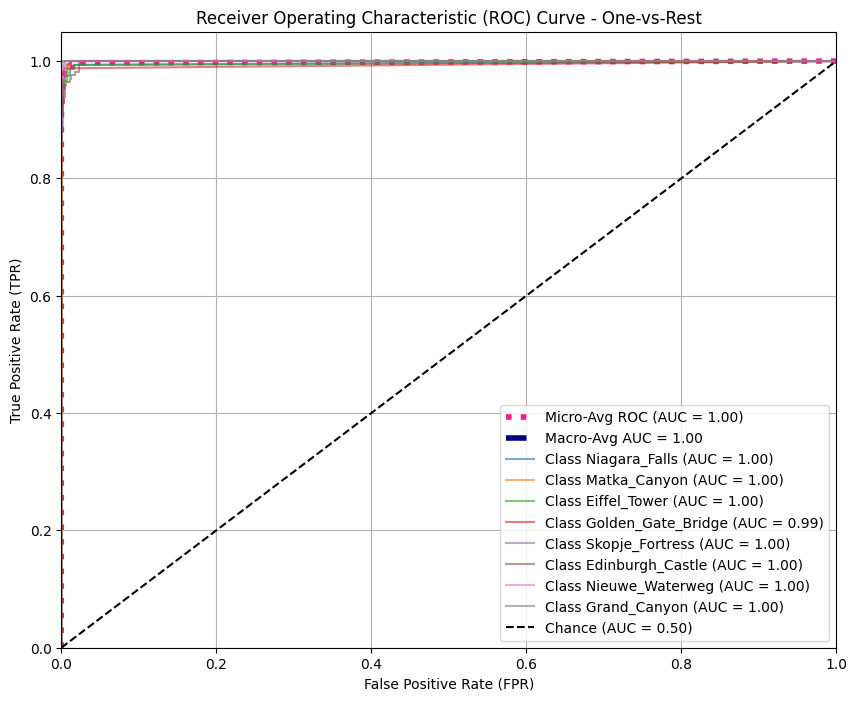

In [47]:
# Create a robust mapping from numeric label to its corresponding string category name
y_numeric_labels_test = test_pca_data["label"]
y_category_names_test = test_pca_data["category"]
unique_label_category_pairs = np.unique(np.column_stack((y_numeric_labels_test, y_category_names_test)), axis=0)
label_map = {int(pair[0]): pair[1] for pair in unique_label_category_pairs}

# Now call the plotting function with the correct arguments
plot_multiclass_roc(y_test_enc, y_proba, le, label_map)

## SVM

In [15]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import accuracy_score, classification_report

import seaborn as sns

RANDOM_STATE = 42
PARAM_GRID = {'C':[0.1,1,10], 'kernel':['rbf', 'linear'], 'gamma':['scale','auto']}
N_GRIDS = 3 * 2 * 2


In [17]:
# -----------------
# Helper Functions
# -----------------

# GridSearch and return best estimator
def grid_search_and_eval(clf, param_grid, X_tr, y_tr, X_val, y_val, scoring='accuracy'):
    # Use StratifiedKFold internally
    cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=RANDOM_STATE)
    grid = GridSearchCV(clf, param_grid, cv=cv, scoring=scoring, n_jobs=-1, verbose=2)

    grid.fit(X_tr, y_tr)
    print("Best params:", grid.best_params_)
    print("Best CV score:", grid.best_score_)
    best = grid.best_estimator_

    val_pred = best.predict(X_val)
    print(classification_report(y_val, val_pred))

    return best

def svm_classification(train_data, feature, le):
    print(f"Fitting SVM with {feature}...")
    # Assign features (X) and labels (y) from the loaded data
    X = train_data[feature]
    y_category_names = train_data["category"]

    # Encode labels using the provided LabelEncoder
    y_encoded = le.transform(y_category_names)

    X_train, X_val, y_train, y_val = train_test_split(
        X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)

    # train with CV + grid search
    # Set probability=True to enable predict_proba for ROC curves
    svm = SVC(probability=True, random_state=RANDOM_STATE)
    param_grid_svm = PARAM_GRID

    start_time = time.time()
    best_clf = grid_search_and_eval(svm, param_grid_svm, X_train, y_train, X_val, y_val)
    end_time = time.time()
    train_time = (end_time - start_time) / N_GRIDS
    print(f"Training time in seconds: {train_time:.4f}")

    return best_clf, train_time

def svm_inference(clf, test_data, feature, le):
    X_test = test_data[feature]
    y_test_category_names = test_data["category"]

    # Encode test labels using the provided LabelEncoder
    y_test_enc = le.transform(y_test_category_names)

    # inference
    print("Test Results: ")
    start_time = time.time()
    test_pred = clf.predict(X_test)
    test_proba = clf.predict_proba(X_test) # Get probabilities for ROC curve
    end_time = time.time()
    test_time = end_time - start_time

    report = classification_report(y_test_enc, test_pred, output_dict=True, target_names=le.classes_)

    print(f"Inference time in seconds: {test_time:.4f}")
    print(classification_report(y_test_enc, test_pred, target_names=le.classes_))

    # Confusion matrix
    cm = confusion_matrix(y_test_enc, test_pred)
    labels = le.inverse_transform(sorted(np.unique(y_test_enc))) # Use inverse_transform for actual category names

    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title(f'Confusion Matrix for {feature}')
    plt.show()

    # ROC curve
    n_classes = len(le.classes_)
    y_test_bin = label_binarize(y_test_enc, classes=np.arange(n_classes))

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    for i in range(n_classes):
        if np.sum(y_test_bin[:, i]) > 0 and len(np.unique(y_test_bin[:, i])) > 1: # Ensure class exists and has variability
            fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], test_proba[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])
        else:
            fpr[i], tpr[i], roc_auc[i] = [0], [0], 0.0 # Handle classes with no positive samples in test set

    # Micro-average ROC curve and AUC
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), test_proba.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # Macro-average AUC
    # Filter out classes with no valid AUC (due to lack of samples or single label)
    valid_aucs = [roc_auc[i] for i in range(n_classes) if roc_auc[i] > 0]
    macro_auc = np.mean(valid_aucs) if valid_aucs else 0.0
    roc_auc["macro"] = macro_auc

    print(f"Macro-average AUC: {macro_auc:.4f}")

    # Plot ROC curve
    plt.figure(figsize=(12, 10))
    plt.plot(
        fpr["micro"],
        tpr["micro"],
        label=f'Micro-Avg ROC (AUC = {roc_auc["micro"]:.2f})',
        color='deeppink',
        linestyle=':',
        linewidth=4,
    )
    # Plot Macro-average as a point for visualization
    plt.plot(
        [], [], # Empty lists to just create a legend entry
        label=f'Macro-Avg AUC = {roc_auc["macro"]:.2f}',
        color='navy',
        linestyle='--', # Changed to dotted for clarity in legend
        linewidth=4,
    )

    colors = plt.cm.get_cmap('tab10', n_classes)
    for i in range(n_classes):
        if roc_auc[i] > 0: # Only plot if valid AUC
            plt.plot(fpr[i], tpr[i], color=colors(i), lw=2,
                     label=f'ROC curve of class {le.inverse_transform([i])[0]} (area = {roc_auc[i]:0.2f})')

    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Chance')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'Receiver Operating Characteristic for {feature}')
    plt.legend(loc="lower right", fontsize='small')
    plt.grid(True)
    plt.show()

    return report, test_time, macro_auc

### Classification using PCA

Fitting SVM with combined_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.9885195958565646
              precision    recall  f1-score   support

           0       0.97      0.98      0.98       114
           1       0.98      0.99      0.99       117
           2       1.00      0.99      1.00       145
           3       1.00      1.00      1.00       142
           4       1.00      0.98      0.99       106
           5       0.99      0.99      0.99       157
           6       0.99      1.00      0.99       173
           7       0.98      0.98      0.98       114

    accuracy                           0.99      1068
   macro avg       0.99      0.99      0.99      1068
weighted avg       0.99      0.99      0.99      1068

Training time in seconds: 5.2597
Test Results: 
Inference time in seconds: 0.8553
                    precision    recall  f1-score   support

  Edinburgh

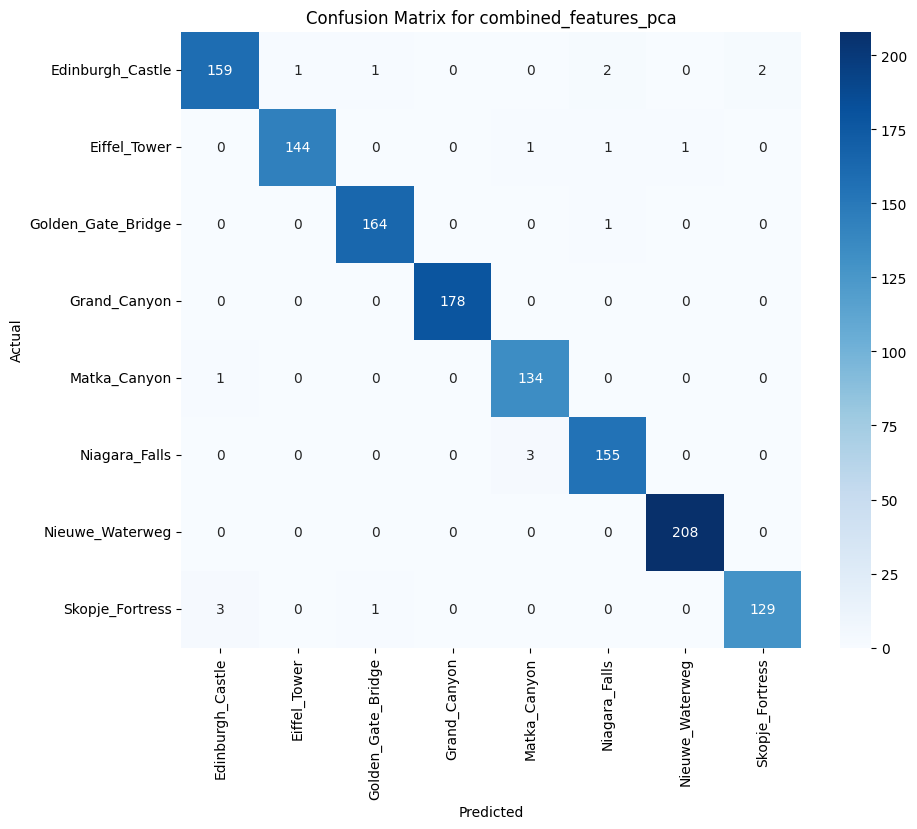

Macro-average AUC: 0.9998


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


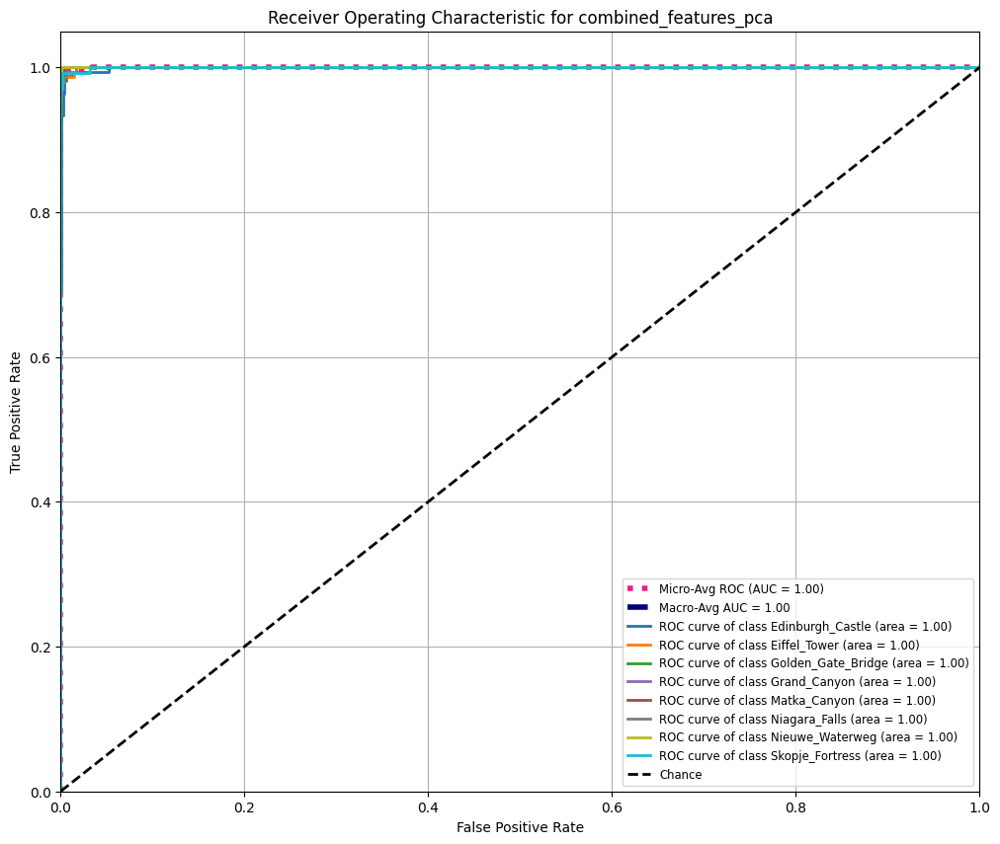

Fitting SVM with hog_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.6944712131650052
              precision    recall  f1-score   support

           0       0.61      0.53      0.56       114
           1       0.63      0.66      0.64       117
           2       0.72      0.81      0.77       145
           3       0.86      0.81      0.83       142
           4       0.82      0.79      0.81       106
           5       0.72      0.72      0.72       157
           6       0.93      0.87      0.90       173
           7       0.56      0.63      0.60       114

    accuracy                           0.74      1068
   macro avg       0.73      0.73      0.73      1068
weighted avg       0.74      0.74      0.74      1068

Training time in seconds: 14.6442
Test Results: 
Inference time in seconds: 1.8622
                    precision    recall  f1-score   support

  Edinburgh_Cas

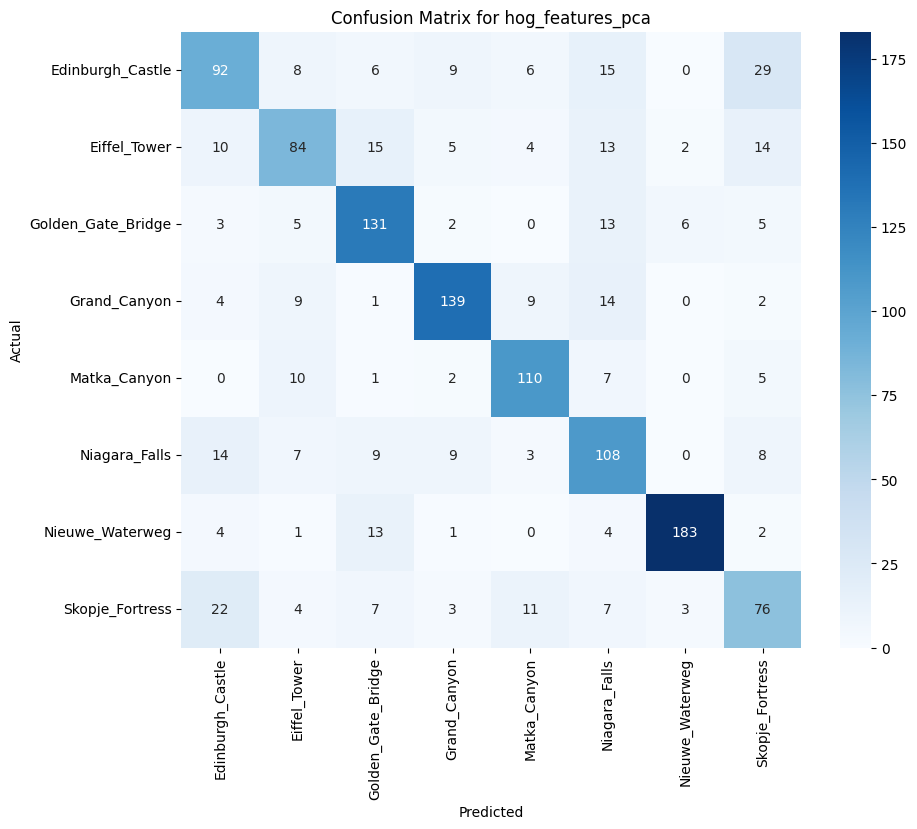

Macro-average AUC: 0.9391


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


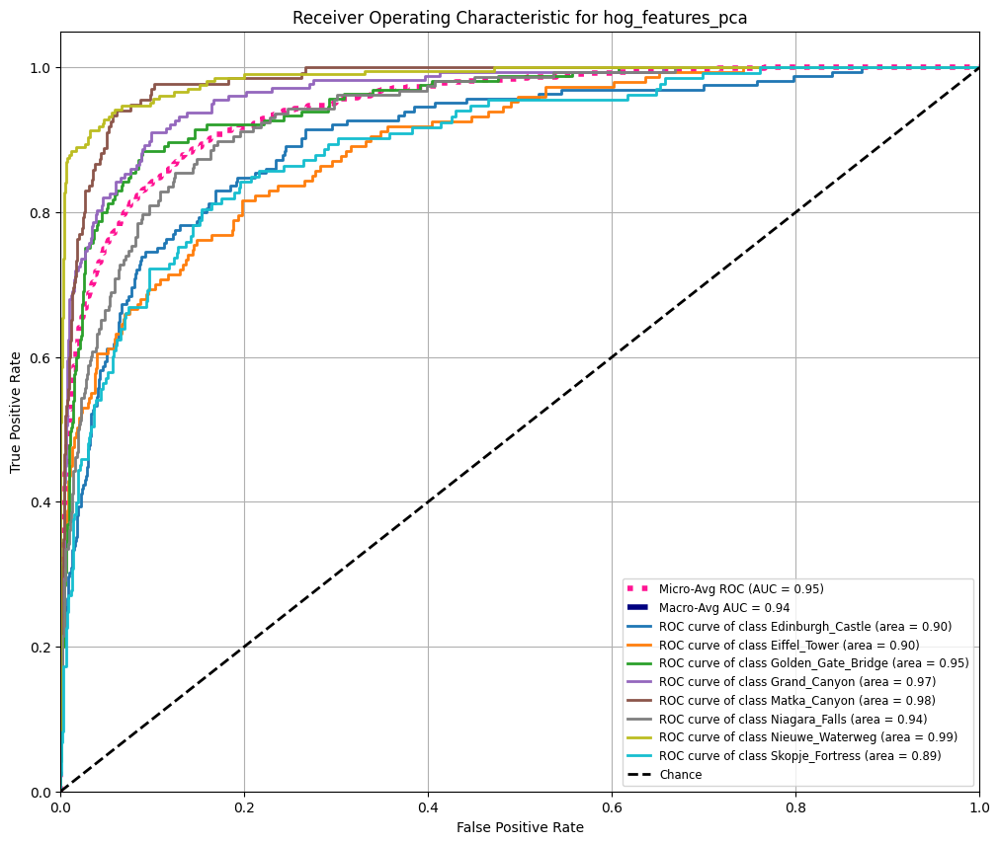

Fitting SVM with color_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.6410451299213675
              precision    recall  f1-score   support

           0       0.54      0.62      0.58       114
           1       0.45      0.50      0.48       117
           2       0.57      0.52      0.55       145
           3       0.75      0.78      0.77       142
           4       0.87      0.83      0.85       106
           5       0.70      0.58      0.63       157
           6       0.78      0.82      0.80       173
           7       0.72      0.71      0.72       114

    accuracy                           0.67      1068
   macro avg       0.67      0.67      0.67      1068
weighted avg       0.68      0.67      0.67      1068

Training time in seconds: 6.0677
Test Results: 
Inference time in seconds: 0.5775
                    precision    recall  f1-score   support

  Edinburgh_Ca

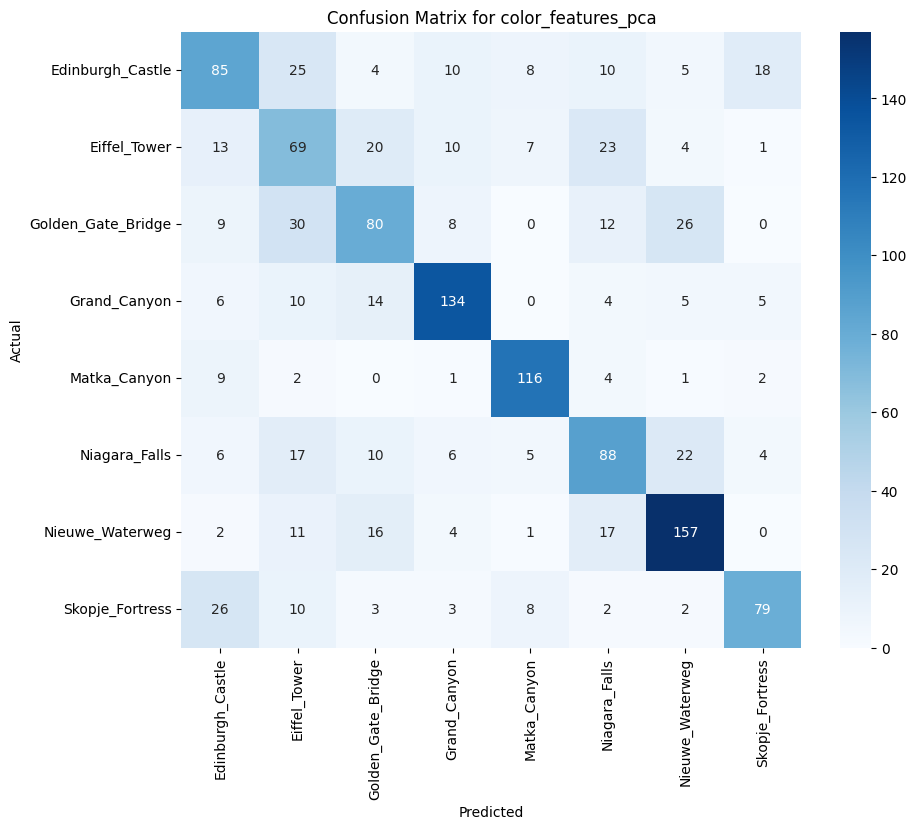

Macro-average AUC: 0.9130


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


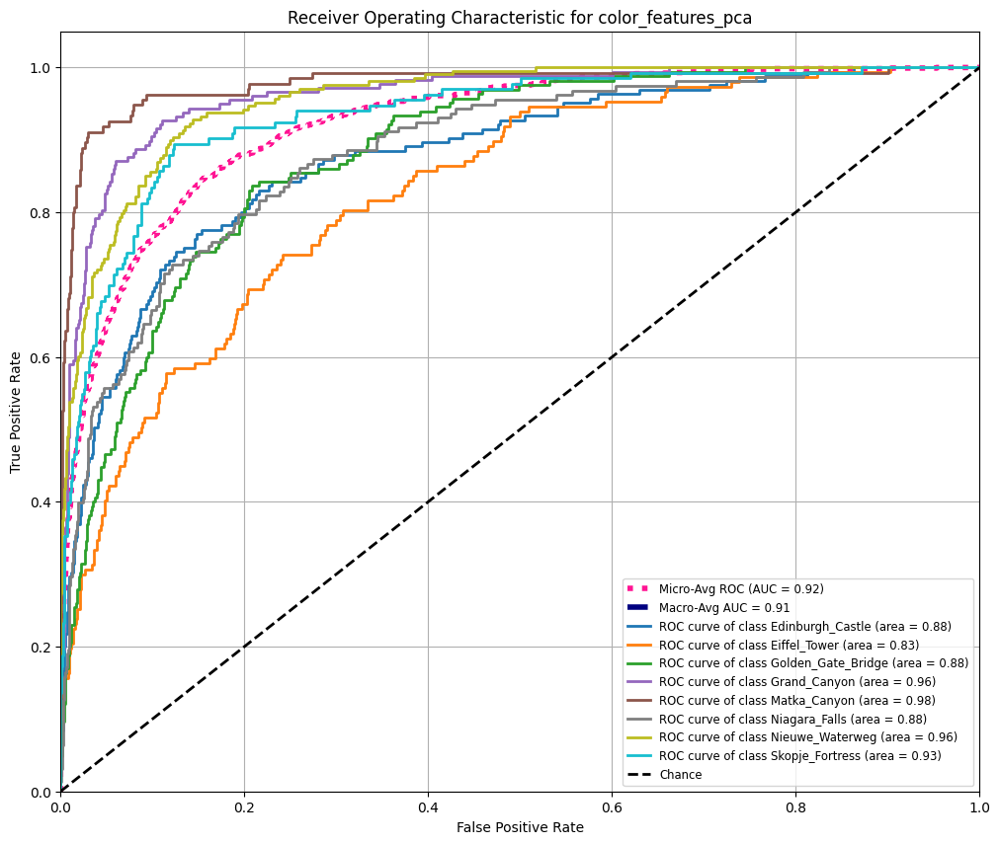

Fitting SVM with hsv_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.6445616337847939
              precision    recall  f1-score   support

           0       0.50      0.56      0.53       114
           1       0.47      0.53      0.50       117
           2       0.59      0.54      0.57       145
           3       0.83      0.80      0.82       142
           4       0.89      0.91      0.90       106
           5       0.66      0.68      0.67       157
           6       0.77      0.73      0.75       173
           7       0.76      0.69      0.72       114

    accuracy                           0.68      1068
   macro avg       0.68      0.68      0.68      1068
weighted avg       0.69      0.68      0.68      1068

Training time in seconds: 11.6614
Test Results: 
Inference time in seconds: 1.3755
                    precision    recall  f1-score   support

  Edinburgh_Cas

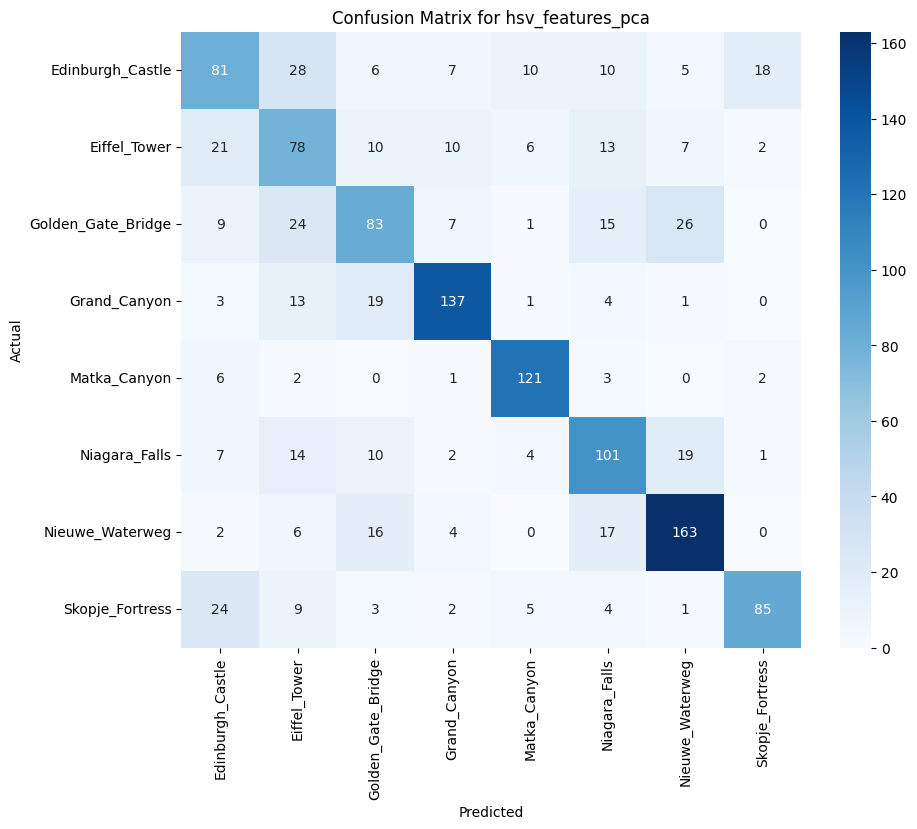

Macro-average AUC: 0.9175


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


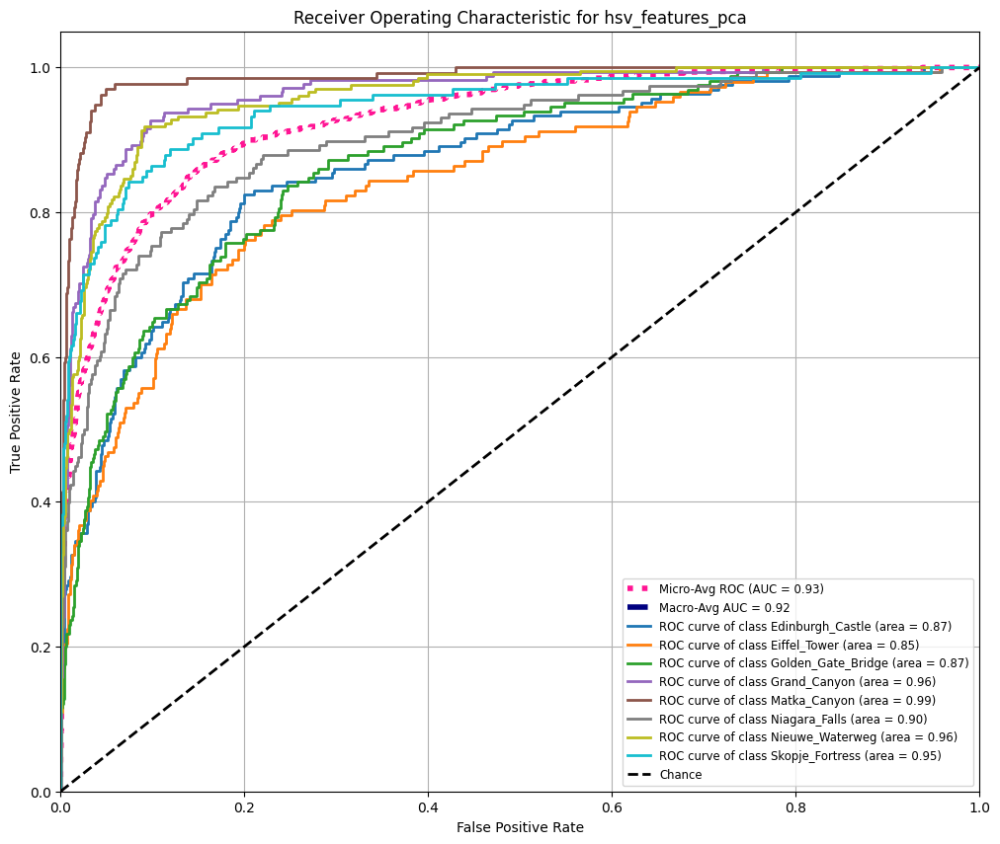

Fitting SVM with vit_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.9826616114143801
              precision    recall  f1-score   support

           0       0.98      0.97      0.98       114
           1       0.96      0.99      0.97       117
           2       0.99      0.97      0.98       145
           3       1.00      1.00      1.00       142
           4       1.00      0.99      1.00       106
           5       0.99      0.97      0.98       157
           6       0.98      1.00      0.99       173
           7       0.98      0.97      0.98       114

    accuracy                           0.99      1068
   macro avg       0.98      0.98      0.98      1068
weighted avg       0.99      0.99      0.99      1068

Training time in seconds: 4.5929
Test Results: 
Inference time in seconds: 2.0924
                    precision    recall  f1-score   support

  Edinburgh_Cast

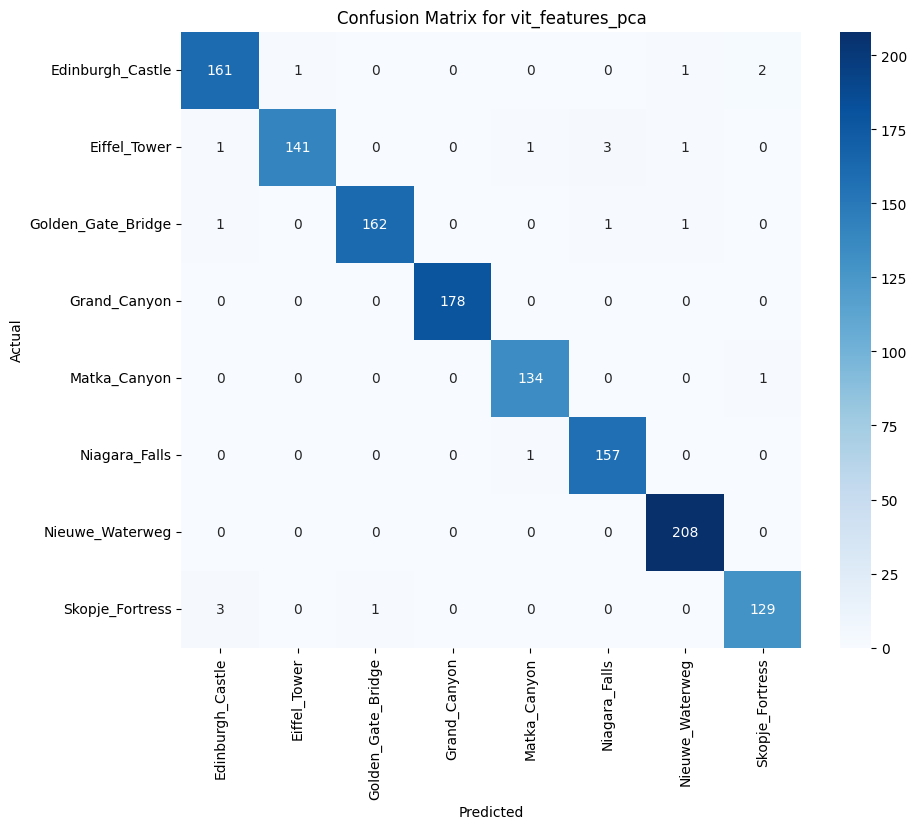

Macro-average AUC: 0.9997


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


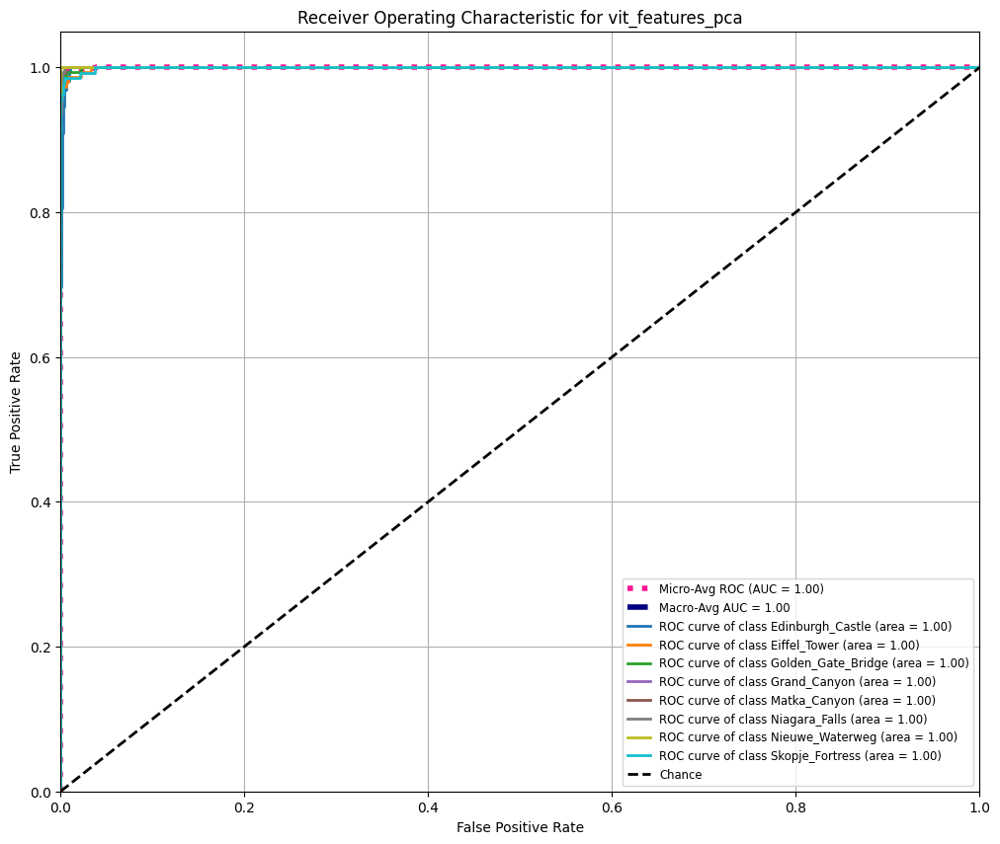

Fitting SVM with resnet_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.9819590354562823
              precision    recall  f1-score   support

           0       0.97      0.94      0.96       114
           1       0.94      0.99      0.97       117
           2       0.99      0.99      0.99       145
           3       1.00      1.00      1.00       142
           4       1.00      0.96      0.98       106
           5       0.99      0.98      0.98       157
           6       0.99      0.98      0.99       173
           7       0.96      0.99      0.97       114

    accuracy                           0.98      1068
   macro avg       0.98      0.98      0.98      1068
weighted avg       0.98      0.98      0.98      1068

Training time in seconds: 3.7800
Test Results: 
Inference time in seconds: 0.5126
                    precision    recall  f1-score   support

  Edinburgh_C

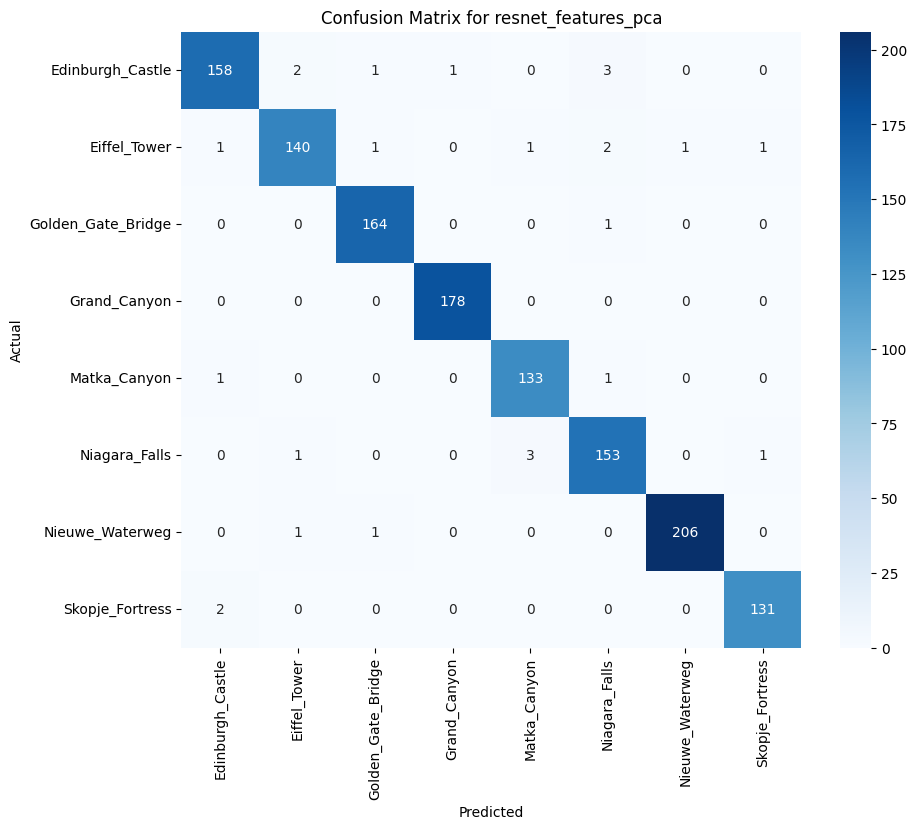

Macro-average AUC: 0.9994


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


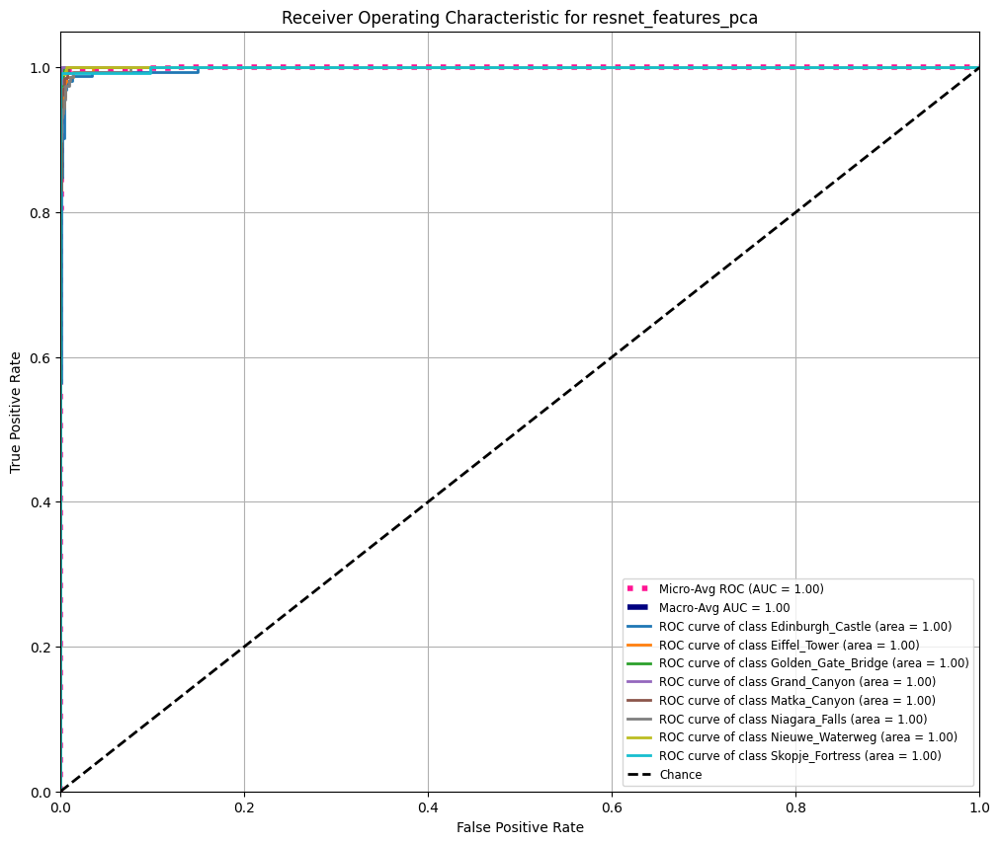

Fitting SVM with vit_resnet_combined_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'auto', 'kernel': 'rbf'}
Best CV score: 0.9882851842297479
              precision    recall  f1-score   support

           0       0.97      0.98      0.97       114
           1       0.98      0.99      0.99       117
           2       1.00      0.99      1.00       145
           3       1.00      1.00      1.00       142
           4       1.00      0.99      1.00       106
           5       0.99      0.99      0.99       157
           6       0.99      1.00      0.99       173
           7       0.99      0.97      0.98       114

    accuracy                           0.99      1068
   macro avg       0.99      0.99      0.99      1068
weighted avg       0.99      0.99      0.99      1068

Training time in seconds: 4.4404
Test Results: 
Inference time in seconds: 0.8881
                    precision    recall  f1-score   support

 

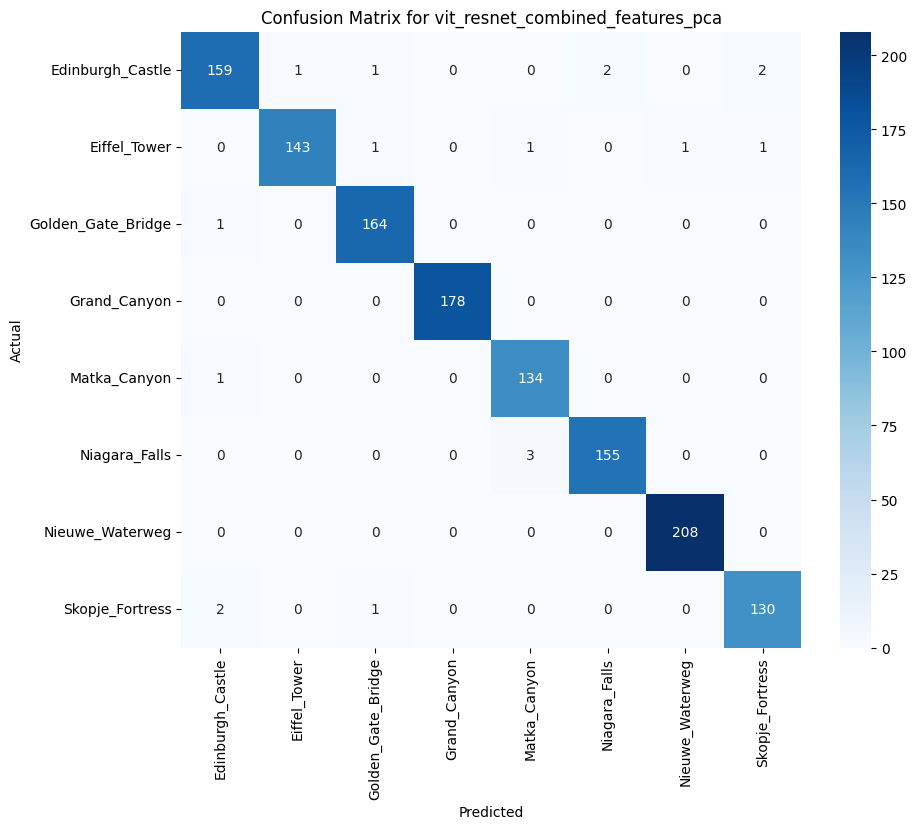

Macro-average AUC: 0.9998


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


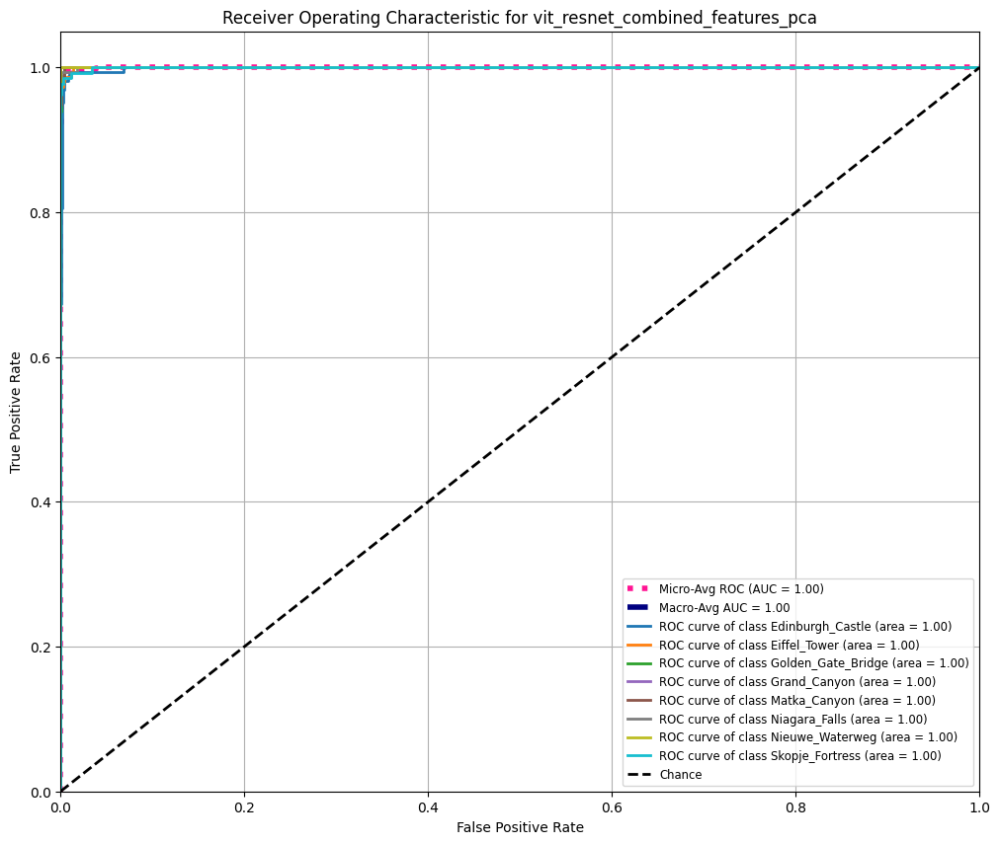

Fitting SVM with combined_feat_no_color_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'auto', 'kernel': 'rbf'}
Best CV score: 0.9885194311259764
              precision    recall  f1-score   support

           0       0.98      0.97      0.98       114
           1       0.98      0.99      0.99       117
           2       1.00      0.99      1.00       145
           3       1.00      1.00      1.00       142
           4       1.00      0.99      1.00       106
           5       0.99      0.99      0.99       157
           6       0.99      1.00      0.99       173
           7       0.98      0.99      0.99       114

    accuracy                           0.99      1068
   macro avg       0.99      0.99      0.99      1068
weighted avg       0.99      0.99      0.99      1068

Training time in seconds: 4.9044
Test Results: 
Inference time in seconds: 0.6551
                    precision    recall  f1-score   support

  Edinb

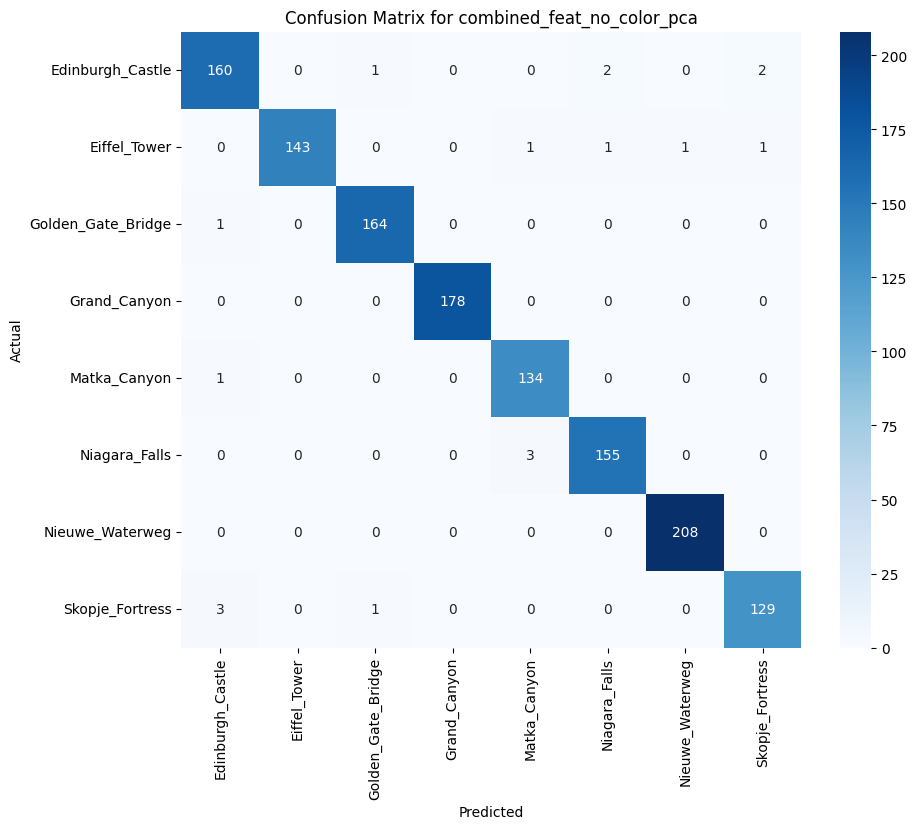

Macro-average AUC: 0.9998


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


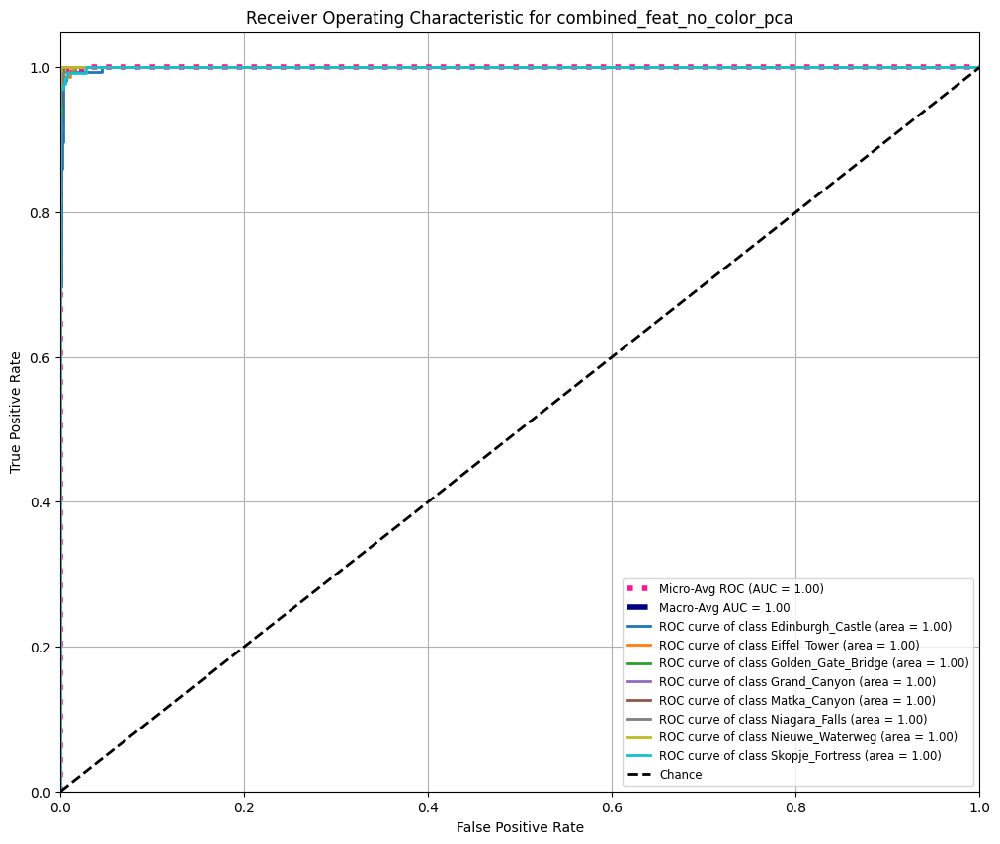

Fitting SVM with hog_color_hsv_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.7734308670199149
              precision    recall  f1-score   support

           0       0.69      0.62      0.65       114
           1       0.78      0.79      0.78       117
           2       0.76      0.85      0.80       145
           3       0.90      0.90      0.90       142
           4       0.93      0.93      0.93       106
           5       0.80      0.77      0.78       157
           6       0.94      0.92      0.93       173
           7       0.71      0.71      0.71       114

    accuracy                           0.82      1068
   macro avg       0.81      0.81      0.81      1068
weighted avg       0.82      0.82      0.82      1068

Training time in seconds: 16.2066
Test Results: 
Inference time in seconds: 2.8624
                    precision    recall  f1-score   support

  Edi

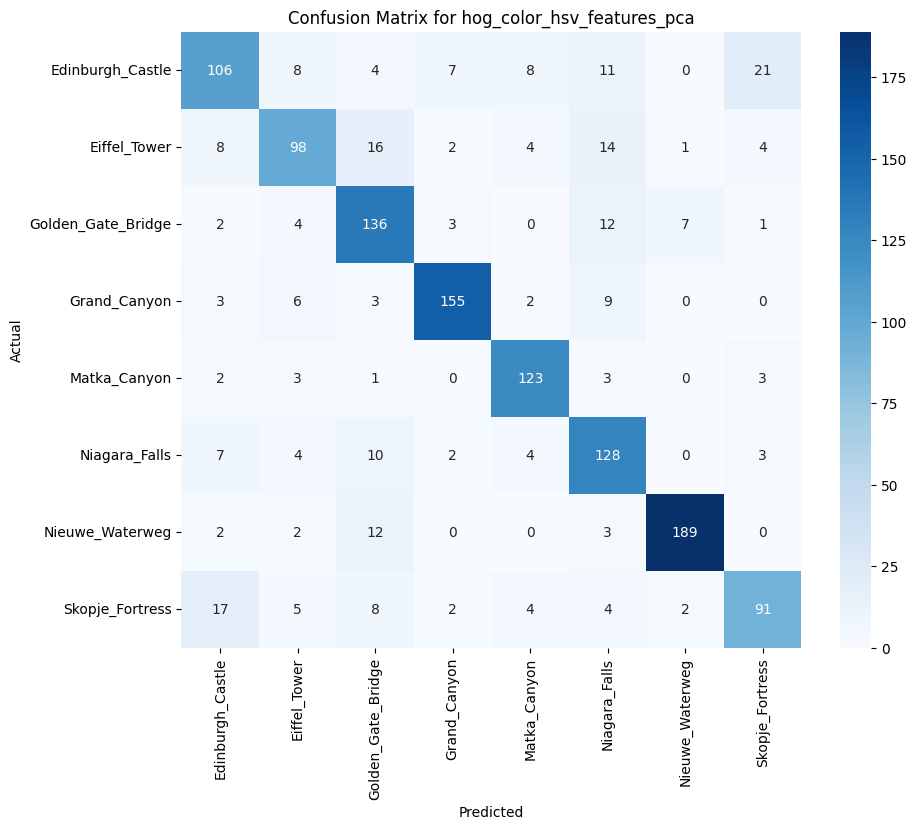

Macro-average AUC: 0.9638


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


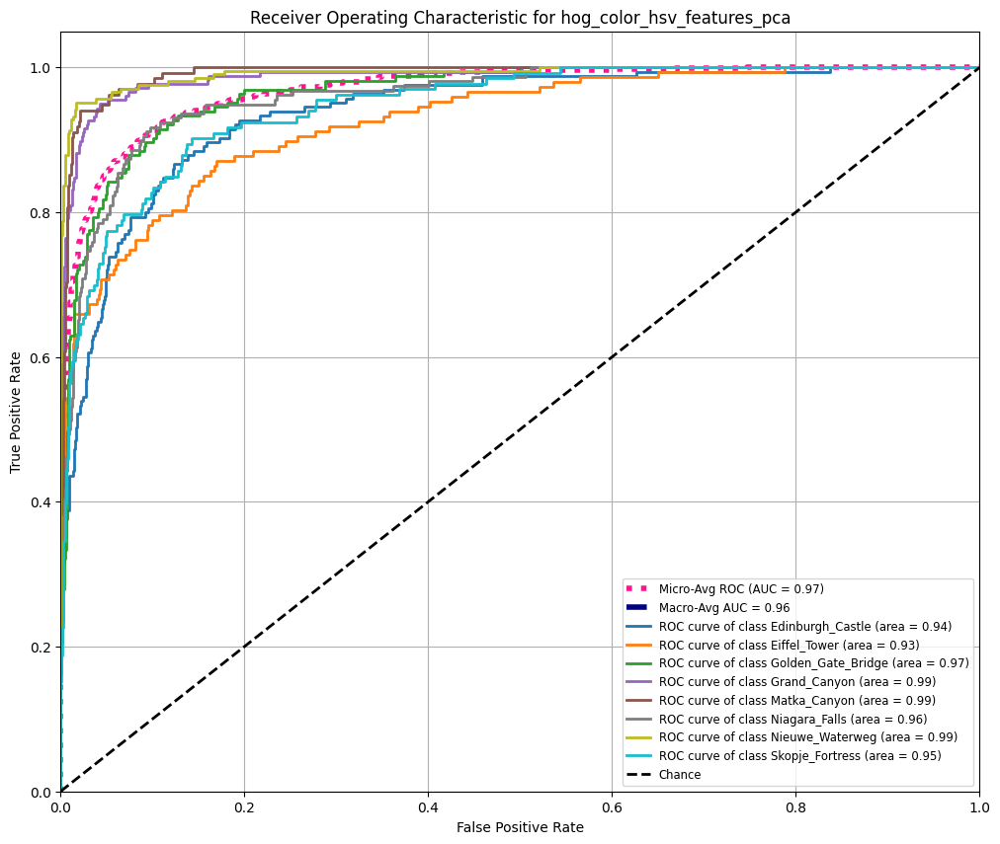

Fitting SVM with hog_hsv_features_pca...
Fitting 3 folds for each of 12 candidates, totalling 36 fits
Best params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best CV score: 0.7504697292718677
              precision    recall  f1-score   support

           0       0.64      0.58      0.61       114
           1       0.73      0.75      0.74       117
           2       0.72      0.83      0.77       145
           3       0.92      0.88      0.90       142
           4       0.92      0.87      0.89       106
           5       0.77      0.77      0.77       157
           6       0.93      0.90      0.91       173
           7       0.66      0.68      0.67       114

    accuracy                           0.79      1068
   macro avg       0.79      0.78      0.78      1068
weighted avg       0.79      0.79      0.79      1068

Training time in seconds: 15.7039
Test Results: 
Inference time in seconds: 2.9974
                    precision    recall  f1-score   support

  Edinburgh

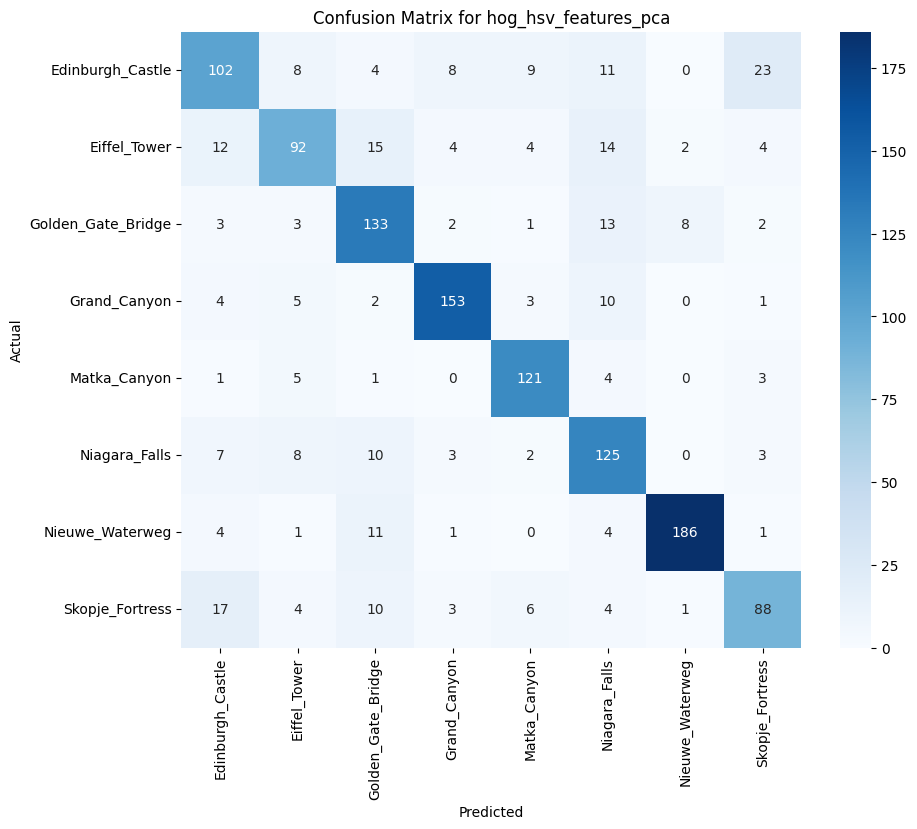

Macro-average AUC: 0.9577


/tmp/ipython-input-2457790420.py:124: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', n_classes)


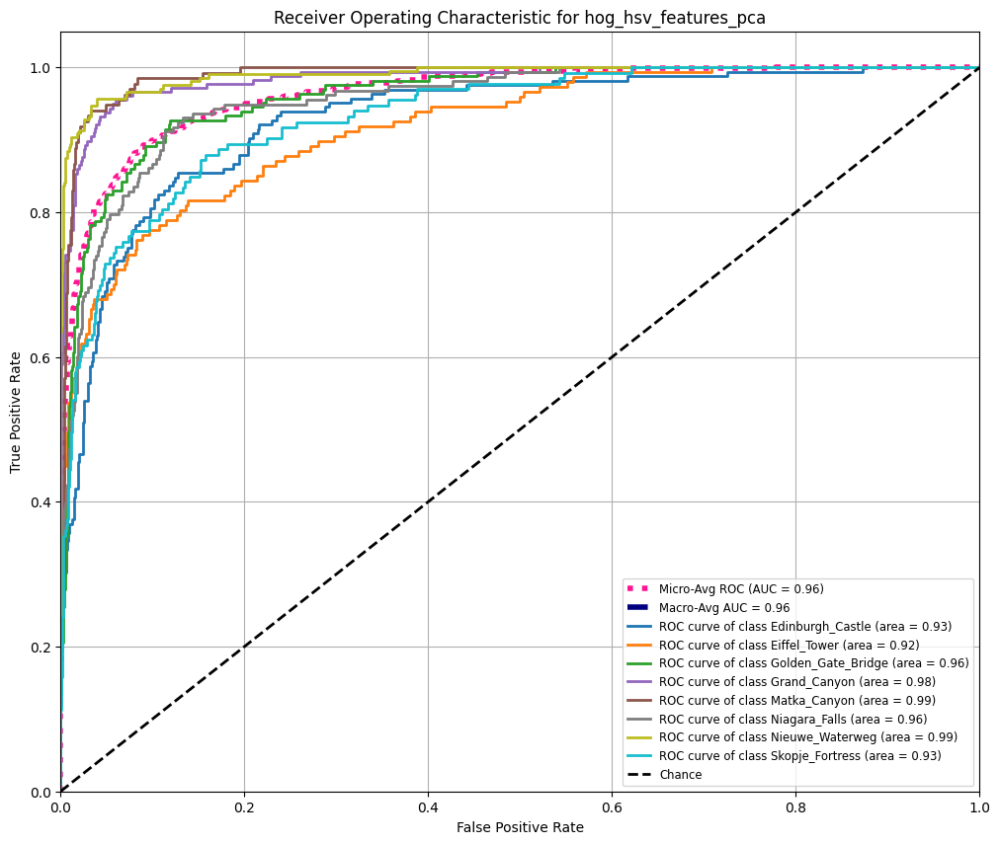


--- SVM Model Performance Summary ---
| feature_name                     |   accuracy |   precision |   recall |   f1-score |   macro_auc |   train_time |   test_time |
|:---------------------------------|-----------:|------------:|---------:|-----------:|------------:|-------------:|------------:|
| combined_features_pca            |   0.986036 |    0.986063 | 0.986036 |   0.986018 |    0.999784 |      5.25975 |    0.855348 |
| combined_feat_no_color_pca       |   0.986036 |    0.986099 | 0.986036 |   0.98603  |    0.999802 |      4.90437 |    0.655122 |
| vit_resnet_combined_features_pca |   0.986036 |    0.986071 | 0.986036 |   0.986017 |    0.999758 |      4.44035 |    0.888077 |
| vit_features_pca                 |   0.98526  |    0.985331 | 0.98526  |   0.985235 |    0.999736 |      4.59287 |    2.09244  |
| resnet_features_pca              |   0.979829 |    0.979849 | 0.979829 |   0.9798   |    0.999424 |      3.78001 |    0.512613 |
| hog_color_hsv_features_pca       |   0.795

In [19]:
import pandas as pd

# Initialize LabelEncoder outside the loop to ensure consistent encoding across all features
le = LabelEncoder()
# Fit on all categories from both train and test data to ensure all possible labels are encoded
all_categories = np.concatenate((train_pca_data["category"], test_pca_data["category"])) # Assuming test_pca_data is loaded
le.fit(all_categories)

feature_list =['combined_features_pca', 'hog_features_pca', 'color_features_pca', 'hsv_features_pca', 'vit_features_pca', 'resnet_features_pca','vit_resnet_combined_features_pca', 'combined_feat_no_color_pca', 'hog_color_hsv_features_pca', 'hog_hsv_features_pca']

# Save best models and their training and inference time
best_dict = {}
all_svm_metrics = []

for feature in feature_list:
    # Pass the LabelEncoder to svm_classification
    best_svm, train_time = svm_classification(train_pca_data, feature, le)

    # Pass the LabelEncoder to svm_inference and capture macro_auc
    report, test_time, macro_auc = svm_inference(best_svm, test_pca_data, feature, le)

    best_dict[feature] = {'model': best_svm,
                          'report': report,
                          'train_time': train_time,
                          'test_time': test_time,
                          'macro_auc': macro_auc}

    # Collect metrics for summary table
    w = report['weighted avg']
    all_svm_metrics.append({
        'feature_name': feature,
        'accuracy': report['accuracy'],
        'precision': w['precision'],
        'recall': w['recall'],
        'f1-score': w['f1-score'],
        'macro_auc': macro_auc,
        'train_time': train_time,
        'test_time': test_time
    })

df_svm_results = pd.DataFrame(all_svm_metrics)
print("\n--- SVM Model Performance Summary ---")
print(df_svm_results.sort_values(by='accuracy', ascending=False).to_markdown(index=False))


In [20]:
best_dict

{'combined_features_pca': {'model': SVC(C=10, probability=True, random_state=42),
  'report': {np.str_('Edinburgh_Castle'): {'precision': 0.9754601226993865,
    'recall': 0.9636363636363636,
    'f1-score': 0.9695121951219512,
    'support': 165.0},
   np.str_('Eiffel_Tower'): {'precision': 0.993103448275862,
    'recall': 0.9795918367346939,
    'f1-score': 0.9863013698630136,
    'support': 147.0},
   np.str_('Golden_Gate_Bridge'): {'precision': 0.9879518072289156,
    'recall': 0.9939393939393939,
    'f1-score': 0.9909365558912386,
    'support': 165.0},
   np.str_('Grand_Canyon'): {'precision': 1.0,
    'recall': 1.0,
    'f1-score': 1.0,
    'support': 178.0},
   np.str_('Matka_Canyon'): {'precision': 0.9710144927536232,
    'recall': 0.9925925925925926,
    'f1-score': 0.9816849816849816,
    'support': 135.0},
   np.str_('Niagara_Falls'): {'precision': 0.9748427672955975,
    'recall': 0.9810126582278481,
    'f1-score': 0.9779179810725552,
    'support': 158.0},
   np.str_('N

In [23]:
    # Extract results into df
rows = []

for feature, info in best_dict.items():
  w = info['report']['weighted avg']
  rows.append({
        'Feature': feature,
        'Accuracy': info['report']['accuracy'],
        'Precision': w['precision'],
        'Recall': w['recall'],
        'F1-Score': w['f1-score'],
        'Train Time': info['train_time'],
        'Test Time': info['test_time']
    })

df = pd.DataFrame(rows)
df.to_csv('/content/drive/MyDrive/W281/svm_results.csv', index=False)
df

,Feature,Accuracy,Precision,Recall,F1-Score,Train Time,Test Time
0,combined_features_pca,0.986036,0.986063,0.986036,0.986018,5.259747,0.855348
1,hog_features_pca,0.716059,0.719954,0.716059,0.716503,14.644220,1.862212
2,color_features_pca,0.626843,0.629875,0.626843,0.626826,6.067715,0.577487
3,hsv_features_pca,0.658650,0.661897,0.658650,0.658331,11.661430,1.375471
4,vit_features_pca,0.985260,0.985331,0.985260,0.985235,4.592874,2.092439
5,resnet_features_pca,0.979829,0.979849,0.979829,0.979800,3.780012,0.512613
6,vit_resnet_combined_features_pca,0.986036,0.986071,0.986036,0.986017,4.440351,0.888077
7,combined_feat_no_color_pca,0.986036,0.986099,0.986036,0.986030,4.904374,0.655122
8,hog_color_hsv_features_pca,0.795966,0.798776,0.795966,0.795401,16.206616,2.862371
9,hog_hsv_features_pca,0.775795,0.777884,0.775795,0.774957,15.703891,2.997352


In [ ]:
for k, v in test_pca_data.items():
    print(k, v.shape)

id (1289,)
landmark_id (1289,)
category (1289,)
label (1289,)
combined_features_pca (1289, 384)
hog_features_pca (1289, 267)
color_features_pca (1289, 44)
hsv_features_pca (1289, 158)
vit_features_pca (1289, 258)
resnet_features_pca (1289, 102)
vit_resnet_combined_features_pca (1289, 260)
combined_feat_no_color_pca (1289, 378)
hog_color_hsv_features_pca (1289, 348)
hog_hsv_features_pca (1289, 334)


## CNN Resnet


In [ ]:
print("Class counts in training set (after encoding):")
for i, name in enumerate(class_names):
    count = np.sum(y_train_resnet == i)
    print(f"{i}: {name}: {count}")

Class counts in training set (after encoding):
0: Grand_Canyon: 629
1: Matka_Canyon: 422
2: Eiffel_Tower: 467
3: Edinburgh_Castle: 578
4: Skopje_Fortress: 457
5: Golden_Gate_Bridge: 455
6: Niagara_Falls: 692
7: Nieuwe_Waterweg: 568


In [ ]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay,
    roc_curve,
    auc,
)
import matplotlib.pyplot as plt
import time

In [ ]:
# Train/test split directly ResNet features
print("ResNet features shape:", resnet_features.shape)
print("Labels shape:", labels_resnet.shape)

X_train_resnet, X_test_resnet, y_train_resnet_raw, y_test_resnet_raw = train_test_split(
    resnet_features,
    labels_resnet,
    test_size=0.2,
    random_state=42,
    stratify=labels_resnet,
)

print("Train shape (raw):", X_train_resnet.shape)
print("Test shape (raw):", X_test_resnet.shape)

ResNet features shape: (5336, 2048)
Labels shape: (5336,)
Train shape (raw): (4268, 2048)
Test shape (raw): (1068, 2048)


In [ ]:
# Map label values to class names
unique_labels = np.unique(labels_resnet)
print("Unique raw labels:", unique_labels)

base_class_names = [
    "Grand_Canyon",
    "Matka_Canyon",
    "Eiffel_Tower",
    "Edinburgh_Castle",
    "Skopje_Fortress",
    "Golden_Gate_Bridge",
    "Niagara_Falls",
    "Nieuwe_Waterweg",
]
assert len(unique_labels) == len(base_class_names), "Mismatch between unique labels and base_class_names!"

# raw_label -> human name
label_map = {lab: base_class_names[i] for i, lab in enumerate(unique_labels)}
print("Label map:", label_map)


Unique raw labels: [ 2  3 10 19 36 39 41 46]
Label map: {np.int64(2): 'Grand_Canyon', np.int64(3): 'Matka_Canyon', np.int64(10): 'Eiffel_Tower', np.int64(19): 'Edinburgh_Castle', np.int64(36): 'Skopje_Fortress', np.int64(39): 'Golden_Gate_Bridge', np.int64(41): 'Niagara_Falls', np.int64(46): 'Nieuwe_Waterweg'}


In [ ]:
# Encode labels to 0..NUM_CLASSES-1 for CrossEntropyLoss
le = LabelEncoder()
le.fit(labels_resnet)  # fit on all labels to be safe

y_train_resnet = le.transform(y_train_resnet_raw)
y_test_resnet  = le.transform(y_test_resnet_raw)

NUM_CLASSES = len(le.classes_)
print("Encoded NUM_CLASSES:", NUM_CLASSES)
print("Encoded classes (raw label values):", le.classes_)

# class_names in encoded order 0..NUM_CLASSES-1
class_names = [label_map[lab] for lab in le.classes_]
print("class_names in encoded order:", class_names)

Encoded NUM_CLASSES: 8
Encoded classes (raw label values): [ 2  3 10 19 36 39 41 46]
class_names in encoded order: ['Grand_Canyon', 'Matka_Canyon', 'Eiffel_Tower', 'Edinburgh_Castle', 'Skopje_Fortress', 'Golden_Gate_Bridge', 'Niagara_Falls', 'Nieuwe_Waterweg']


In [ ]:
# PCA on ResNet features for this CNN only
pca_resnet = PCA(n_components=50, random_state=42)  # adjust if you want more/less dims
X_train_resnet_pca = pca_resnet.fit_transform(X_train_resnet)
X_test_resnet_pca  = pca_resnet.transform(X_test_resnet)

print("Train shape (PCA):", X_train_resnet_pca.shape)
print("Test shape (PCA):", X_test_resnet_pca.shape)

Train shape (PCA): (4268, 50)
Test shape (PCA): (1068, 50)


In [ ]:
# Compute class weights for imbalanced data
class_counts = np.bincount(y_train_resnet)
print("Class counts:", class_counts)

class_weights = 1.0 / class_counts
class_weights = class_weights / class_weights.sum() * NUM_CLASSES  # normalize a bit
print("Class weights:", class_weights)

class_weights_t = torch.tensor(class_weights, dtype=torch.float32).to(device)

Class counts: [629 422 467 578 457 455 692 568]
Class weights: [0.82467504 1.22919573 1.11075074 0.89744048 1.13505601 1.14004527
 0.74959624 0.91324049]


In [ ]:
# Move PCA features + encoded labels to tensors
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

X_train_t = torch.tensor(X_train_resnet_pca, dtype=torch.float32).to(device)  # [N_train, D_pca]
X_test_t  = torch.tensor(X_test_resnet_pca, dtype=torch.float32).to(device)
y_train_t = torch.tensor(y_train_resnet, dtype=torch.long).to(device)
y_test_t  = torch.tensor(y_test_resnet, dtype=torch.long).to(device)

# Add channel dimension for 1-D CNN: [N, D] -> [N, 1, D]
X_train_cnn = X_train_t.unsqueeze(1)
X_test_cnn  = X_test_t.unsqueeze(1)

input_length = X_train_cnn.shape[-1]
print("CNN input length (PCA dims):", input_length)

Using device: cpu
CNN input length (PCA dims): 50


In [ ]:
# Define 1-D CNN classifier on PCA features
class ResNetPcaCNN(nn.Module):
    """
    1-D CNN classifier on PCA-reduced ResNet embeddings.
    Input shape: [batch_size, 1, D_pca]
    """
    def __init__(self, num_classes):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv1d(1, 32, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool1d(2),              # -> [N, 32, D_pca/2]
            nn.Conv1d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.AdaptiveAvgPool1d(1)       # -> [N, 64, 1]
        )
        self.fc = nn.Sequential(
            nn.Flatten(),                 # -> [N, 64]
            nn.Linear(64, 128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        x = self.conv(x)
        x = self.fc(x)
        return x

model = ResNetPcaCNN(NUM_CLASSES).to(device)
criterion = nn.CrossEntropyLoss(weight=class_weights_t)
optimizer = optim.AdamW(model.parameters(), lr=5e-4)

print(model)

ResNetPcaCNN(
  (conv): Sequential(
    (0): Conv1d(1, 32, kernel_size=(3,), stride=(1,), padding=(1,))
    (1): ReLU()
    (2): MaxPool1d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,))
    (4): ReLU()
    (5): AdaptiveAvgPool1d(output_size=1)
  )
  (fc): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=64, out_features=128, bias=True)
    (2): ReLU()
    (3): Dropout(p=0.3, inplace=False)
    (4): Linear(in_features=128, out_features=8, bias=True)
  )
)


In [ ]:
# Training loop (full PCA train matrix each epoch) + timing
EPOCHS = 20
start_time = time.time()

for epoch in range(EPOCHS):
    model.train()
    optimizer.zero_grad()

    logits = model(X_train_cnn)              # full training set each epoch
    loss = criterion(logits, y_train_t)
    loss.backward()
    optimizer.step()

    with torch.no_grad():
        train_pred = torch.argmax(logits, dim=1)
        train_acc = (train_pred == y_train_t).float().mean().item()

    print(f"Epoch {epoch+1}/{EPOCHS} - loss: {loss.item():.4f} - train acc: {train_acc*100:.2f}%")

end_time = time.time()
training_minutes = (end_time - start_time) / 60
print(f"\nTotal CNN training time: {training_minutes:.2f} minutes")

Epoch 1/20 - loss: 2.0813 - train acc: 15.56%
Epoch 2/20 - loss: 2.0777 - train acc: 16.87%
Epoch 3/20 - loss: 2.0760 - train acc: 17.62%
Epoch 4/20 - loss: 2.0743 - train acc: 17.48%
Epoch 5/20 - loss: 2.0736 - train acc: 17.22%
Epoch 6/20 - loss: 2.0709 - train acc: 18.02%
Epoch 7/20 - loss: 2.0694 - train acc: 17.24%
Epoch 8/20 - loss: 2.0667 - train acc: 18.25%
Epoch 9/20 - loss: 2.0650 - train acc: 17.83%
Epoch 10/20 - loss: 2.0637 - train acc: 17.13%
Epoch 11/20 - loss: 2.0621 - train acc: 16.68%
Epoch 12/20 - loss: 2.0585 - train acc: 17.88%
Epoch 13/20 - loss: 2.0571 - train acc: 17.29%
Epoch 14/20 - loss: 2.0537 - train acc: 18.65%
Epoch 15/20 - loss: 2.0518 - train acc: 18.16%
Epoch 16/20 - loss: 2.0497 - train acc: 18.74%
Epoch 17/20 - loss: 2.0473 - train acc: 18.74%
Epoch 18/20 - loss: 2.0457 - train acc: 18.63%
Epoch 19/20 - loss: 2.0411 - train acc: 20.13%
Epoch 20/20 - loss: 2.0373 - train acc: 20.88%

Total CNN training time: 0.09 minutes


In [ ]:
# Evaluation: accuracy + per-class precision/recall/F1
model.eval()
with torch.no_grad():
    logits_test = model(X_test_cnn)
    y_proba = torch.softmax(logits_test, dim=1).cpu().numpy()
    y_pred = np.argmax(y_proba, axis=1)
    y_test_np = y_test_t.cpu().numpy()

acc = accuracy_score(y_test_np, y_pred)
print(f"\nCNN accuracy on PCA-ResNet features: {acc*100:.2f}%\n")

print("Classification report (CNN on PCA-ResNet features):")
print(classification_report(y_test_np, y_pred, target_names=class_names))


CNN accuracy on PCA-ResNet features: 22.66%

Classification report (CNN on PCA-ResNet features):
                    precision    recall  f1-score   support

      Grand_Canyon       0.00      0.00      0.00       157
      Matka_Canyon       0.07      0.02      0.03       106
      Eiffel_Tower       0.17      0.80      0.28       117
  Edinburgh_Castle       0.29      0.71      0.41       145
   Skopje_Fortress       0.31      0.33      0.32       114
Golden_Gate_Bridge       0.00      0.00      0.00       114
     Niagara_Falls       0.00      0.00      0.00       173
   Nieuwe_Waterweg       1.00      0.04      0.07       142

          accuracy                           0.23      1068
         macro avg       0.23      0.24      0.14      1068
      weighted avg       0.23      0.23      0.13      1068



/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


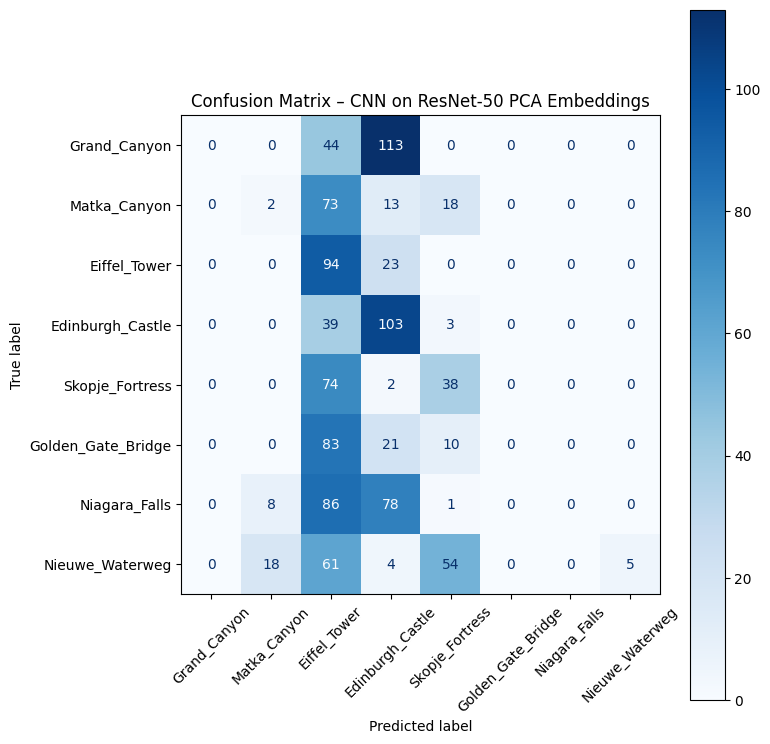

In [ ]:
# Confusion matrix
from sklearn.metrics import ConfusionMatrixDisplay

cm = confusion_matrix(y_test_np, y_pred)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)

fig, ax = plt.subplots(figsize=(8, 8))
disp.plot(
    values_format="d",
    ax=ax,
    cmap="Blues",
    colorbar=True
)

ax.set_title("Confusion Matrix – CNN on ResNet-50 PCA Embeddings")
ax.set_xlabel("Predicted label")
ax.set_ylabel("True label")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


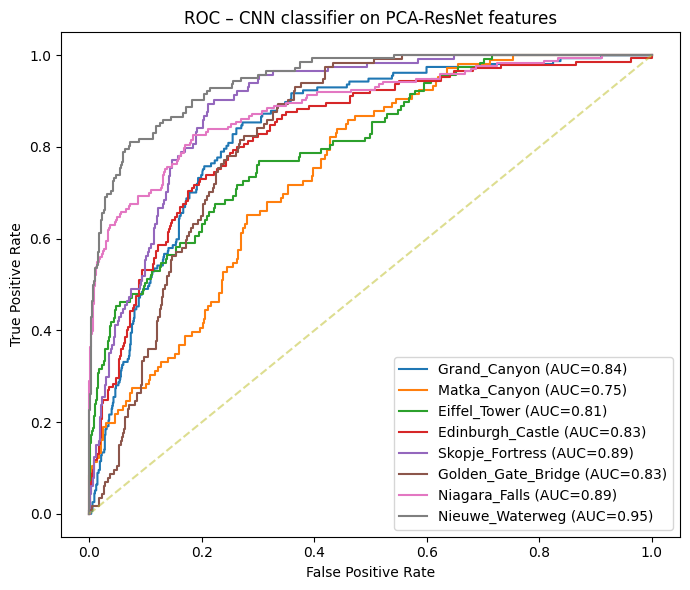

In [ ]:
# ROC curves
plt.figure(figsize=(7, 6))
for i, name in enumerate(class_names):
    y_true_bin = (y_test_np == i).astype(int)
    fpr, tpr, _ = roc_curve(y_true_bin, y_proba[:, i])
    auc_val = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f"{name} (AUC={auc_val:.2f})")

plt.plot([0, 1], [0, 1], "--", alpha=0.5)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC – CNN classifier on PCA-ResNet features")
plt.legend()
plt.tight_layout()
plt.show()

# All models should

Confusion matrix

ROC for both simple and complex features

Finally an ROC for classifier

